# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.003
scheduler_gamma = [0.6, 0.6, 0.5, 0.6, 0.6, 0.5, 0.5]
scheduler_milestones = [25, 50, 100, 150, 200, 250, 400]
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    print(df_recon)
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


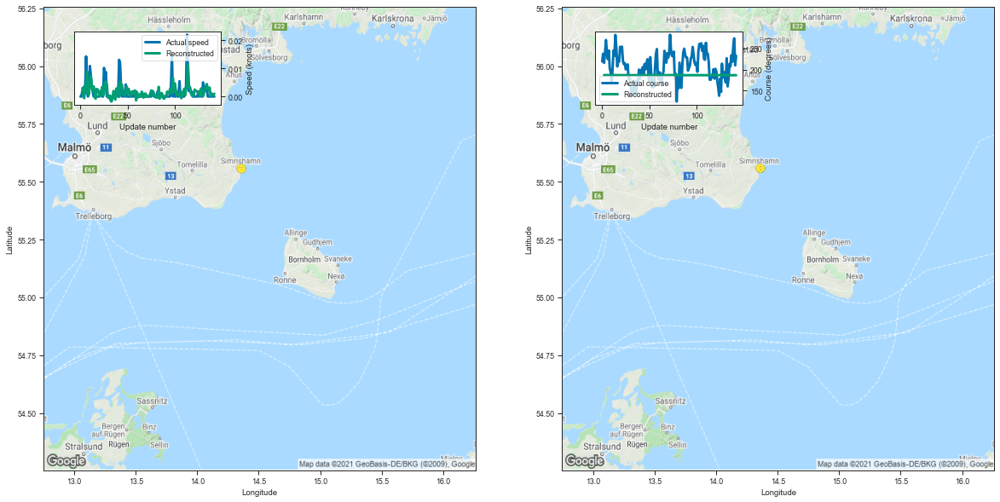

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360170  55.557762  0.002977  186.624573         0.001204   
3    14.359656  55.558178  0.000453  186.519241         0.000853   
4    14.359962  55.558735 -0.000591  186.617401         0.000891   
5    14.360683  55.558186  0.003876  186.644302         0.000904   
6    14.360269  55.557903  0.001133  186.467285         0.000742   
..         ...        ...       ...         ...              ...   
138  14.360142  55.558422  0.000306  186.467346         0.000723   
139  14.360010  55.558075  0.001056  186.550690         0.000788   
140  14.360654  55.558117  0.000347  186.496185         0.000750   
141  14.360001  55.558132  0.000780  186.414581         0.000686   
142  14.359934  55.558212  0.000961  186.428513         0.000693   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001202     0.004243     91.022775  
3          0.000817     0.003382     96.303754  
4          0.000830     0.005114    

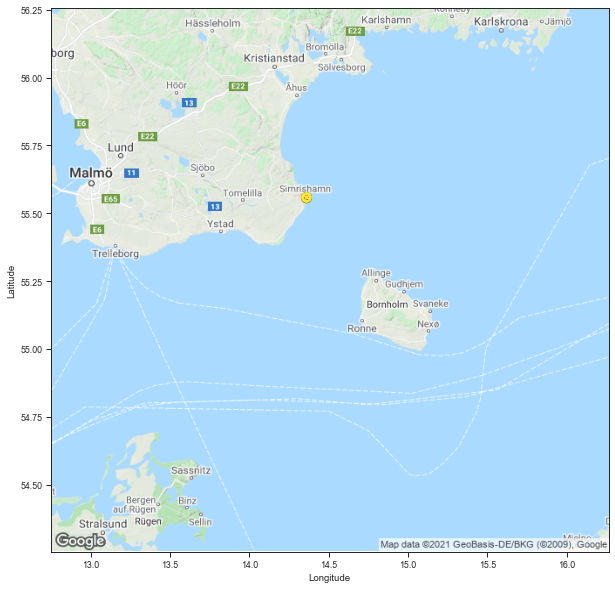

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6685896  265759000  14.359031  55.556702  0.000000   
1                 0  6685896  265759000  14.359023  55.556713  0.000000   
2                 0  6685896  265759000  14.359054  55.556709  0.001923   
3                 0  6685896  265759000  14.359044  55.556709  0.000000   
4                 0  6685896  265759000  14.359061  55.556709  0.003571   
..              ...      ...        ...        ...        ...       ...   
138               0  6685896  265759000  14.359066  55.556721  0.000000   
139               0  6685896  265759000  14.359043  55.556709  0.000000   
140               0  6685896  265759000  14.359036  55.556713  0.000000   
141               0  6685896  265759000  14.359025  55.556694  0.000000   
142               0  6685896  265759000  14.359023  55.556709  0.000000   

         Course Ship type  Track length          Time stamp  
0    219.074280   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.360170,55.557762,0.002977,186.624573,0.001204,0.001202,0.004243,91.022775
3,14.359656,55.558178,0.000453,186.519241,0.000853,0.000817,0.003382,96.303754
4,14.359962,55.558735,-0.000591,186.617401,0.000891,0.000830,0.005114,98.252907
5,14.360683,55.558186,0.003876,186.644302,0.000904,0.000834,0.005797,98.809515
6,14.360269,55.557903,0.001133,186.467285,0.000742,0.000698,0.003055,98.345835
...,...,...,...,...,...,...,...,...
138,14.360142,55.558422,0.000306,186.467346,0.000723,0.000677,0.003042,98.866777
139,14.360010,55.558075,0.001056,186.550690,0.000788,0.000729,0.004064,99.252174
140,14.360654,55.558117,0.000347,186.496185,0.000750,0.000700,0.003380,98.867316
141,14.360001,55.558132,0.000780,186.414581,0.000686,0.000646,0.002530,98.641470


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


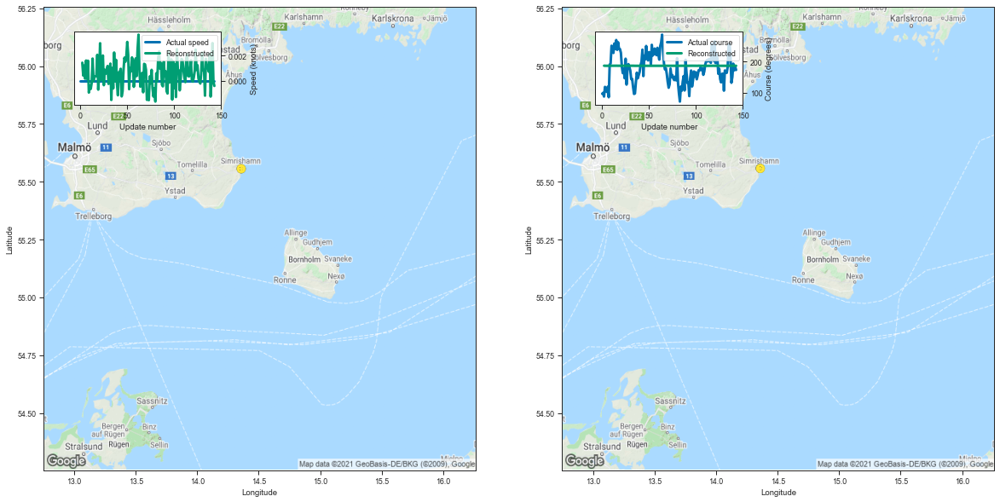

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358731  55.557831  0.001432  186.756668         0.001376   
3    14.357544  55.557945  0.000407  186.535599         0.000870   
4    14.358501  55.558407  0.001214  186.465744         0.000754   
5    14.358748  55.558258  0.000157  186.496140         0.000760   
6    14.359702  55.557419  0.001608  186.575165         0.000815   
..         ...        ...       ...         ...              ...   
139  14.358808  55.557854 -0.001271  186.487152         0.000742   
140  14.359460  55.557201  0.000072  186.479202         0.000732   
141  14.359350  55.557884  0.002999  186.656036         0.000879   
142  14.359178  55.557884 -0.000082  186.510651         0.000767   
143  14.359699  55.557461 -0.000422  186.613373         0.000848   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001353     0.006835     91.575746  
3          0.000832     0.003671     96.324499  
4          0.000714     0.002964    

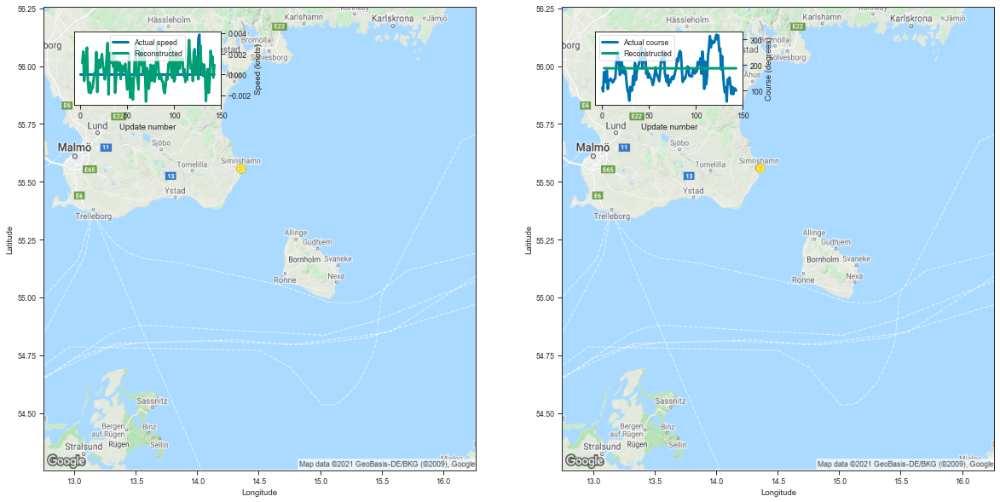

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358395  55.558170  0.001132  186.732224         0.001349   
3    14.359022  55.557892  0.002223  186.634933         0.000973   
4    14.359046  55.557449 -0.000610  186.443985         0.000742   
5    14.358645  55.557922  0.000280  186.421814         0.000701   
6    14.359672  55.557793  0.001940  186.638306         0.000875   
..         ...        ...       ...         ...              ...   
139  14.358576  55.556931  0.002289  186.663818         0.000891   
140  14.359887  55.557358  0.001030  186.644669         0.000885   
141  14.358456  55.557552  0.001743  186.466995         0.000729   
142  14.358999  55.558514 -0.000292  186.517029         0.000761   
143  14.359812  55.557648  0.000929  186.544785         0.000787   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001331     0.006361     91.434317  
3          0.000921     0.005209     96.556260  
4          0.000706     0.002736    

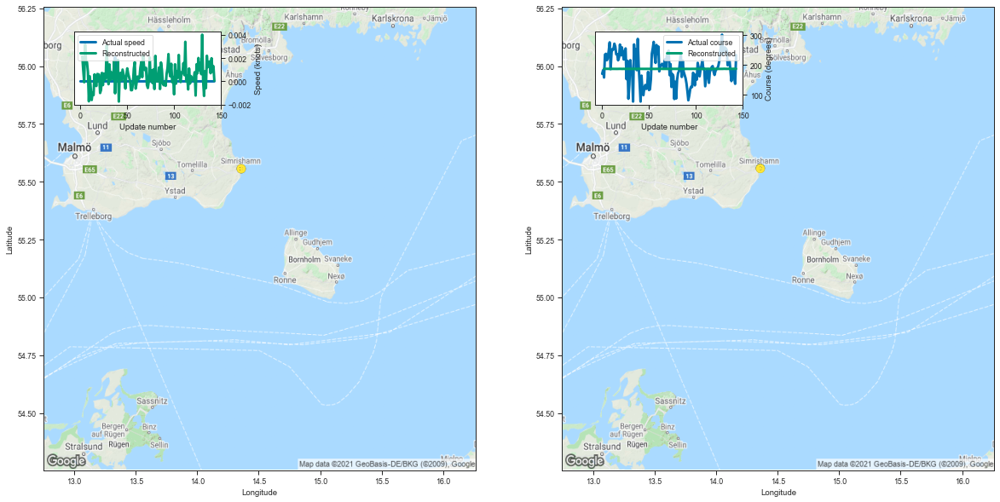

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359350  55.558098  0.002151  186.964417         0.001724   
3    14.359030  55.556877  0.000957  186.640152         0.000991   
4    14.359135  55.557800 -0.000079  186.615540         0.000896   
5    14.359765  55.557610  0.003199  186.747681         0.001004   
6    14.359114  55.557865  0.001628  186.505005         0.000780   
..         ...        ...       ...         ...              ...   
139  14.359150  55.557526  0.000698  186.659882         0.000901   
140  14.359734  55.556854  0.001994  186.715378         0.000959   
141  14.359694  55.557438  0.000854  186.633926         0.000884   
142  14.359783  55.556923  0.001303  186.631836         0.000870   
143  14.359492  55.557152  0.000054  186.749710         0.000984   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001657     0.013864     92.087133  
3          0.000942     0.005303     96.255499  
4          0.000837     0.005083    

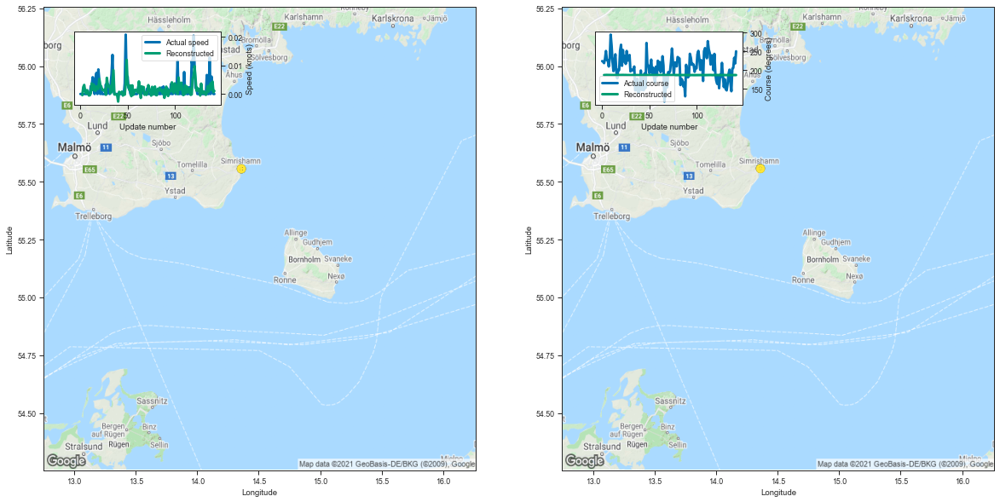

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360011  55.557396 -0.000427  186.652740         0.001248   
3    14.359877  55.556732  0.002436  186.478333         0.000820   
4    14.360491  55.557930  0.003172  186.846375         0.001120   
5    14.360517  55.557671  0.000974  186.756439         0.001030   
6    14.360747  55.557140  0.000144  186.517838         0.000791   
..         ...        ...       ...         ...              ...   
138  14.359776  55.557415  0.003706  186.479446         0.000733   
139  14.359989  55.557915  0.001540  186.606949         0.000839   
140  14.360400  55.557846  0.004362  186.579010         0.000823   
141  14.360334  55.557724  0.000661  186.497452         0.000753   
142  14.360542  55.556679  0.001073  186.562332         0.000806   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001247     0.004649     90.871115  
3          0.000788     0.002942     96.147790  
4          0.001011     0.011318    

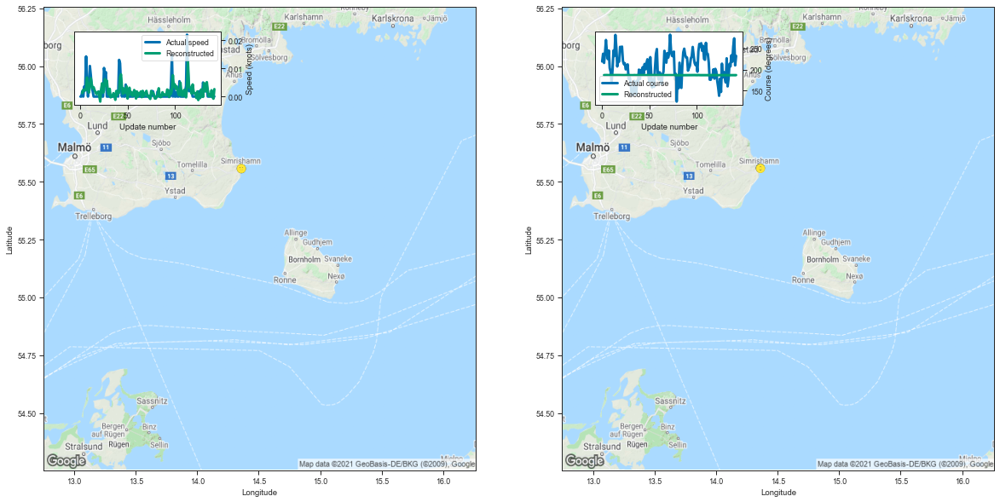

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359568  55.558708  0.001219  186.674637         0.001270   
3    14.359674  55.558212  0.002417  186.544815         0.000883   
4    14.360235  55.558487  0.002091  186.766586         0.001030   
5    14.361268  55.557484  0.002520  186.610718         0.000875   
6    14.360739  55.557556  0.002367  186.608337         0.000862   
..         ...        ...       ...         ...              ...   
138  14.360015  55.558533  0.000158  186.573624         0.000821   
139  14.359702  55.558792  0.002231  186.515045         0.000770   
140  14.360778  55.558430 -0.000047  186.521332         0.000770   
141  14.360114  55.558720 -0.000750  186.429626         0.000699   
142  14.360730  55.557701  0.002634  186.667740         0.000897   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001262     0.005074     91.186686  
3          0.000843     0.003759     96.311861  
4          0.000944     0.008431    

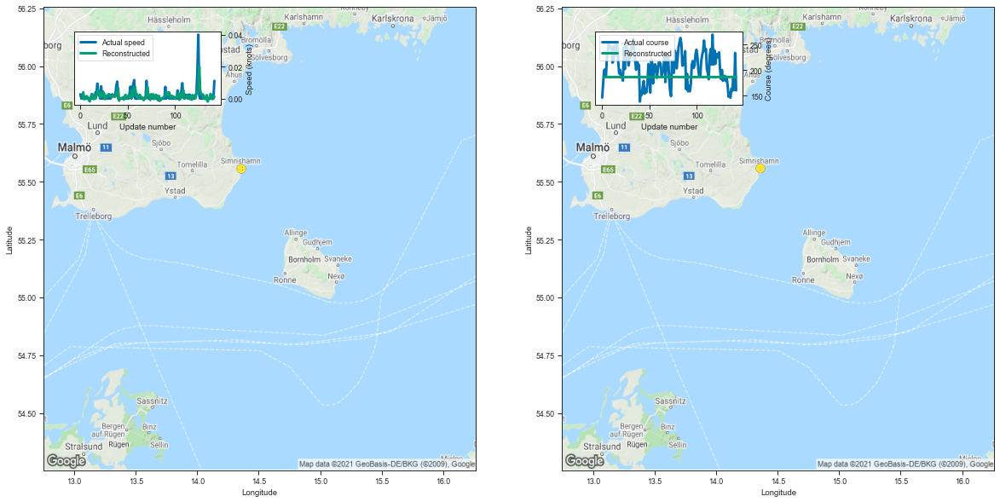

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360156  55.557655  0.000332  186.793884         0.001453   
3    14.360444  55.556881  0.003939  186.648422         0.000992   
4    14.359597  55.558460 -0.000375  186.599213         0.000879   
5    14.360282  55.557625  0.000671  186.464264         0.000744   
6    14.360167  55.557156  0.001427  186.475769         0.000743   
..         ...        ...       ...         ...              ...   
138  14.360241  55.557716  0.002938  186.719315         0.000960   
139  14.359983  55.557358  0.000736  186.482071         0.000749   
140  14.360620  55.557426 -0.000279  186.456146         0.000718   
141  14.360006  55.557510  0.000714  186.490189         0.000742   
142  14.360287  55.557747  0.001166  186.471268         0.000731   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001427     0.007827     91.428026  
3          0.000937     0.005473     96.556265  
4          0.000821     0.004768    

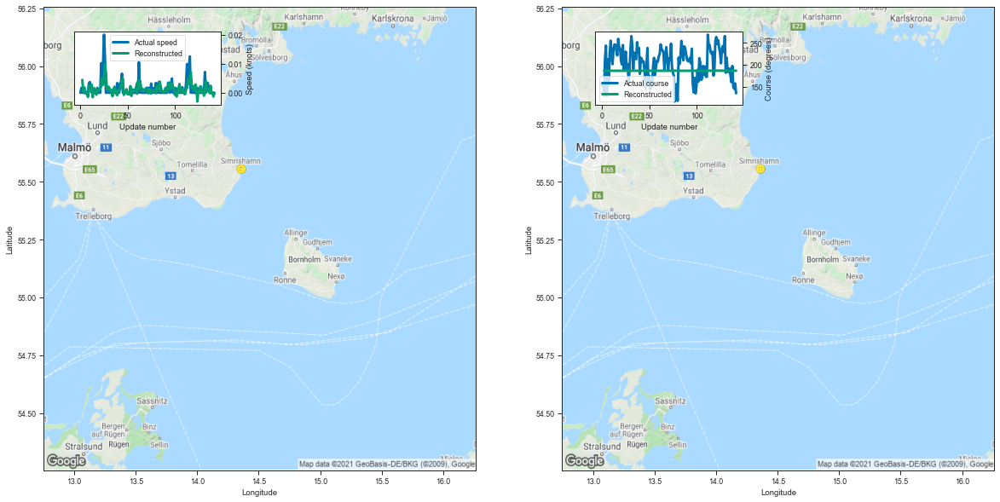

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.361005  55.556137  0.004426  186.806931         0.001459   
3    14.359836  55.557129  0.000334  186.689056         0.001035   
4    14.360241  55.555996  0.001782  186.538895         0.000827   
5    14.359694  55.557106 -0.000151  186.501434         0.000771   
6    14.360327  55.557152  0.000385  186.564346         0.000812   
..         ...        ...       ...         ...              ...   
138  14.360375  55.556118  0.002408  186.425293         0.000691   
139  14.360224  55.557049 -0.000246  186.495529         0.000745   
140  14.360466  55.556602  0.000058  186.474884         0.000729   
141  14.360754  55.556194 -0.001298  186.485092         0.000735   
142  14.360190  55.556332 -0.000160  186.590546         0.000820   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001432     0.008077     91.516381  
3          0.000974     0.006394     96.721491  
4          0.000779     0.003832    

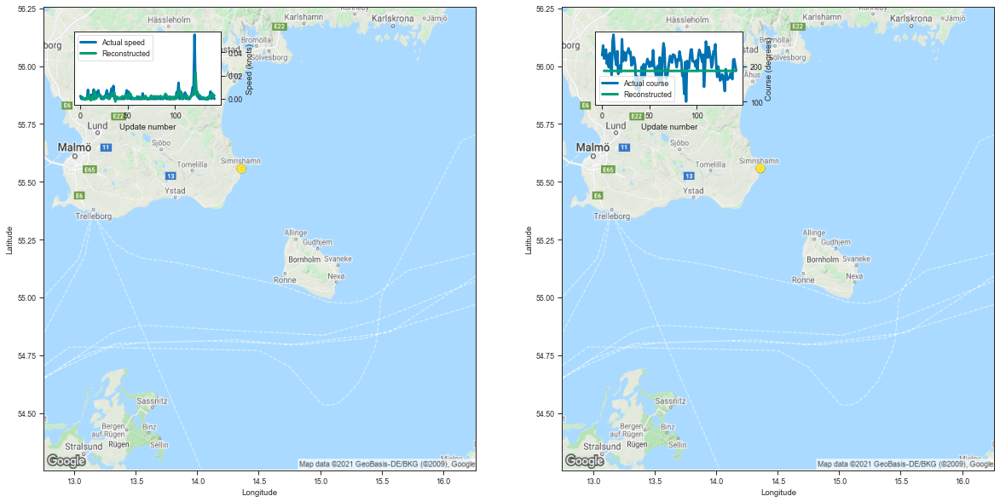

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360333  55.557083  0.001642  186.641251         0.001217   
3    14.359869  55.557838 -0.000099  186.644714         0.000974   
4    14.360611  55.557480  0.000501  186.516617         0.000805   
5    14.360129  55.557205 -0.000705  186.561035         0.000819   
6    14.359734  55.558109  0.000794  186.529526         0.000788   
..         ...        ...       ...         ...              ...   
138  14.360640  55.557854  0.003461  186.658203         0.000899   
139  14.359944  55.557636  0.003944  186.658676         0.000900   
140  14.360233  55.557590  0.001237  186.711594         0.000944   
141  14.360377  55.556881  0.003478  186.529495         0.000791   
142  14.360154  55.557884  0.002760  186.577744         0.000822   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001211     0.004484     91.256095  
3          0.000919     0.005291     96.776533  
4          0.000760     0.003544    

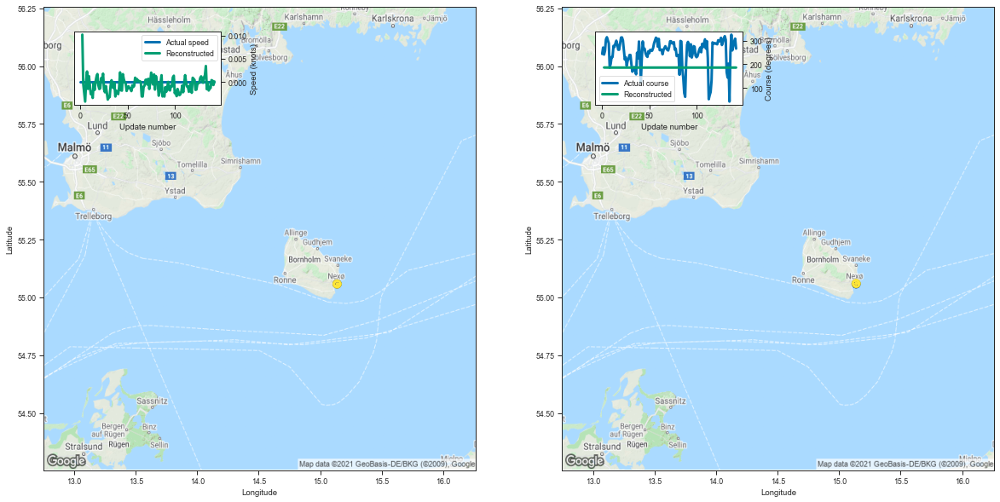

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138125  55.058537  0.010186  186.607407         0.001830   
3    15.138681  55.058891 -0.000374  186.502518         0.001212   
4    15.138471  55.059254 -0.002222  186.379913         0.000981   
5    15.138455  55.059425 -0.004164  186.555084         0.001131   
6    15.139050  55.058868  0.000088  186.441925         0.001020   
..         ...        ...       ...         ...              ...   
138  15.139887  55.058887 -0.001257  186.274216         0.000830   
139  15.138049  55.060097  0.000427  186.269287         0.000822   
140  15.137720  55.059879  0.000316  186.281631         0.000829   
141  15.138286  55.059643 -0.000616  186.268829         0.000817   
142  15.138449  55.059868  0.000148  186.317337         0.000861   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001769     0.012334     92.894256  
3          0.001123     0.010347     99.799276  
4          0.000907     0.007064    

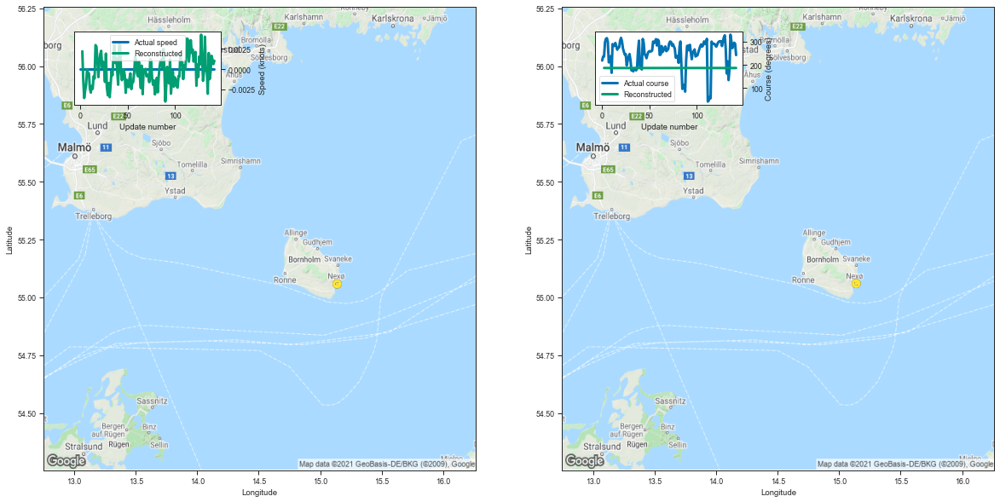

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138651  55.059780  0.002211  186.583725         0.001767   
3    15.139526  55.058258 -0.001391  186.406921         0.001084   
4    15.138158  55.059383 -0.003604  186.341965         0.000930   
5    15.138586  55.058907 -0.002676  186.315033         0.000879   
6    15.138371  55.059635 -0.001946  186.278564         0.000837   
..         ...        ...       ...         ...              ...   
138  15.138502  55.059444 -0.000349  186.423492         0.000968   
139  15.138661  55.059402  0.001652  186.286957         0.000849   
140  15.138269  55.059116  0.001182  186.271439         0.000823   
141  15.138473  55.059113  0.000626  186.378754         0.000918   
142  15.138453  55.059582  0.001038  186.541809         0.001107   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001707     0.011267     93.042770  
3          0.001011     0.007216     99.704147  
4          0.000860     0.006146    

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1347.627075,9.358521
34,34,7237328,266054000,Fishing,144,1344.217529,9.334844
44,44,7135380,266054000,Fishing,144,1321.456787,9.176783
29,29,6787151,265759000,Fishing,143,1309.067749,9.154320
17,17,6685896,265759000,Fishing,143,1305.695557,9.130738
60,60,6869996,265759000,Fishing,143,1302.287720,9.106907
74,74,6962046,265759000,Fishing,143,1282.570435,8.969024
95,95,6805561,265759000,Fishing,143,1263.740967,8.837349
39,39,876715,211474000,Fishing,143,1240.577271,8.675366
46,46,867510,211474000,Fishing,143,1240.534546,8.675067


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


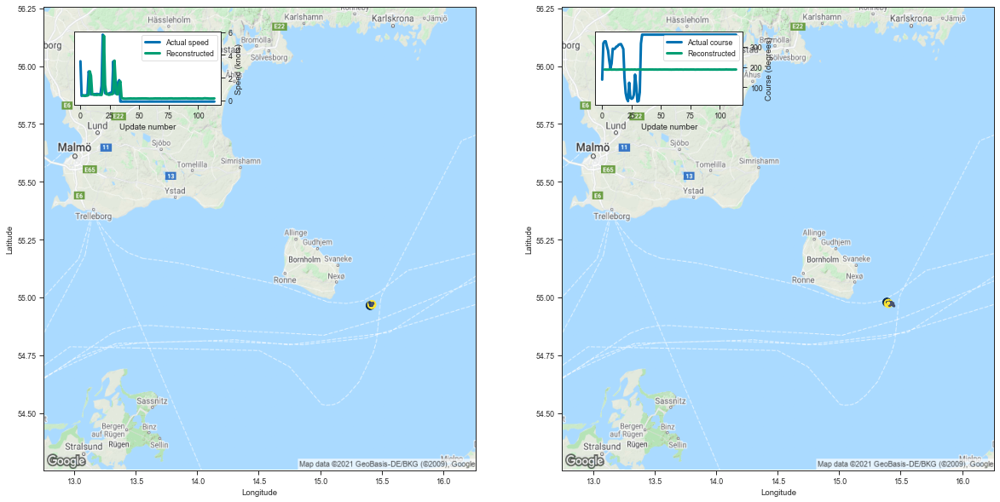

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.389162  54.978806  0.432132  187.496902         0.008861   
3    15.400124  54.975986  0.413591  187.378464         0.005881   
4    15.400142  54.977852  0.392216  187.110519         0.004074   
5    15.403234  54.975266  0.420262  187.260880         0.004582   
6    15.403830  54.974117  0.424205  187.269241         0.004675   
..         ...        ...       ...         ...              ...   
110  15.400070  54.976055  0.166468  187.296478         0.004125   
111  15.400171  54.975441  0.163897  187.282410         0.003938   
112  15.398666  54.976147  0.168550  187.548859         0.005182   
113  15.399757  54.975201  0.165401  187.441040         0.004830   
114  15.400640  54.973789  0.178135  187.660736         0.006006   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006961     0.739539     93.889121  
3          0.004538     0.615857     99.621736  
4          0.003221     0.287706    

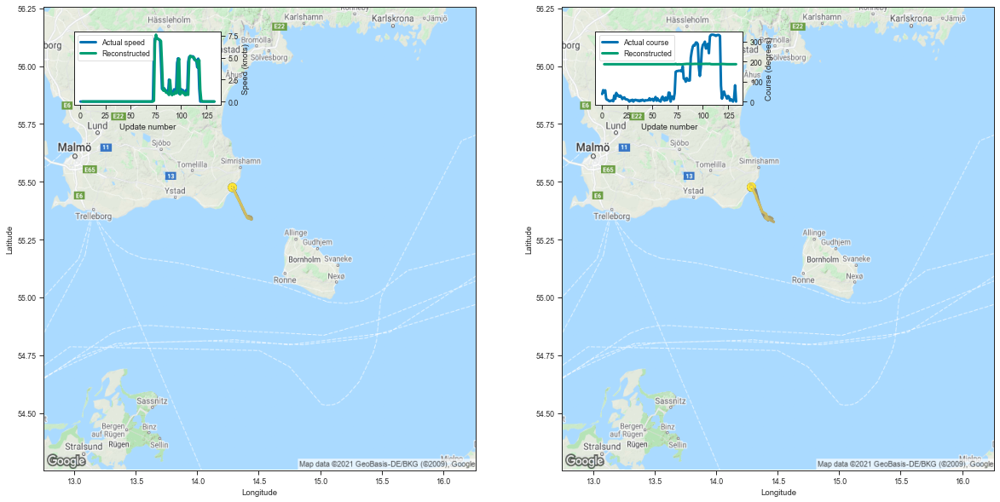

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287214  55.476383  0.002431  186.664993         0.001177   
3    14.286914  55.476940 -0.002534  186.558273         0.000837   
4    14.288523  55.476383 -0.000818  186.496384         0.000739   
5    14.287527  55.476749 -0.001722  186.549606         0.000758   
6    14.287525  55.476955 -0.000243  186.471909         0.000696   
..         ...        ...       ...         ...              ...   
129  14.287428  55.477077  0.001066  186.468094         0.000689   
130  14.287249  55.477383  0.001011  186.503098         0.000712   
131  14.288078  55.476669  0.000672  186.469208         0.000686   
132  14.287747  55.476799 -0.000031  186.574219         0.000769   
133  14.287714  55.477158  0.002775  186.671539         0.000869   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001152     0.004464     92.469780  
3          0.000786     0.003548     97.675393  
4          0.000689     0.002983    

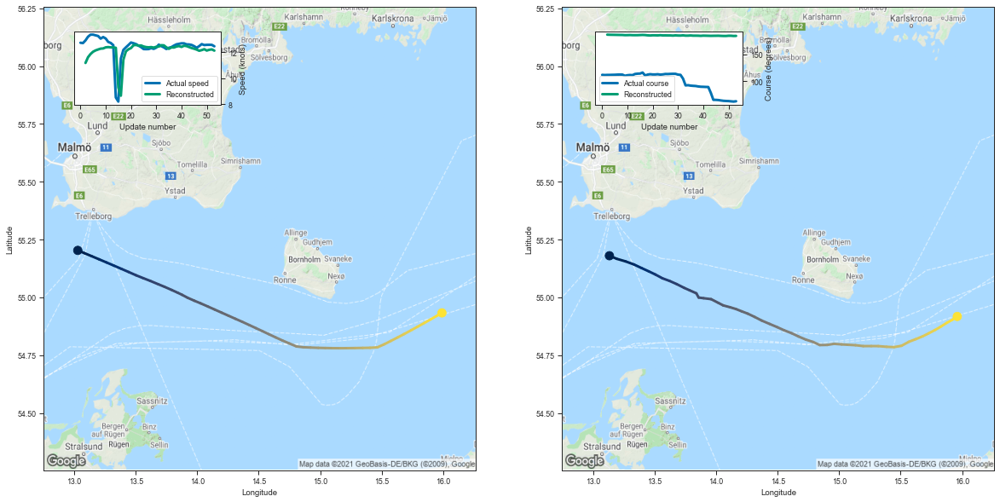

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.132772  55.179970  11.162079  186.386581         0.027478   
3   13.192403  55.166656  11.602522  186.183182         0.022468   
4   13.264629  55.155403  11.848108  186.090210         0.022547   
5   13.332845  55.142048  12.024427  186.005432         0.022690   
6   13.395435  55.126343  12.127966  185.917343         0.022516   
7   13.452807  55.112385  12.197506  185.831604         0.021992   
8   13.506329  55.098770  12.260975  185.779221         0.021981   
9   13.563868  55.082359  12.277050  185.438858         0.016460   
10  13.621850  55.070957  12.360132  185.500641         0.018436   
11  13.679419  55.057369  12.380989  185.672470         0.022913   
12  13.740300  55.041027  12.361385  185.437119         0.018845   
13  13.785559  55.030285  12.354279  185.402939         0.018715   
14  13.839398  55.017487  12.326578  185.429260         0.019703   
15  13.858122  54.999084   9.277394  185.645996 

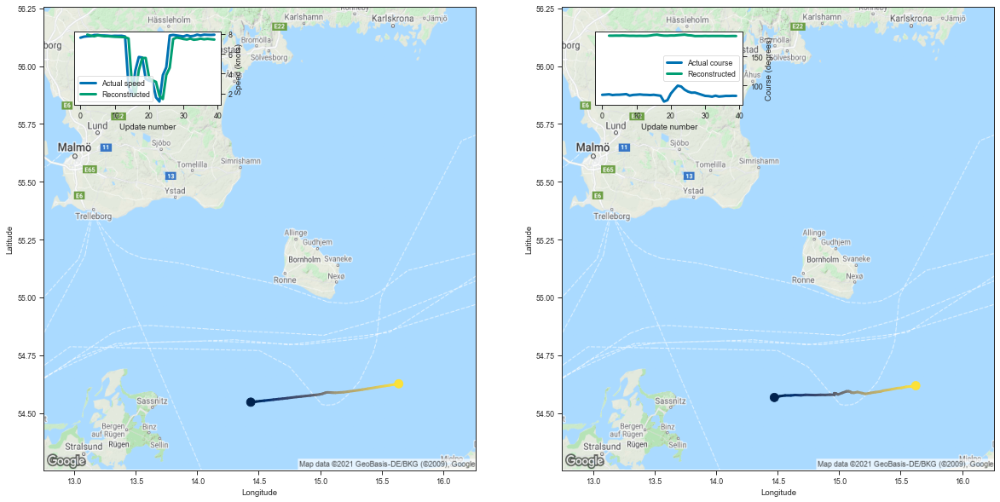

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.473546  54.567066  7.931943  185.843231         0.014278   
3   14.517554  54.572506  7.827017  185.814499         0.011339   
4   14.561020  54.575741  7.766021  185.967438         0.012766   
5   14.608393  54.575706  7.861341  185.894028         0.012721   
6   14.642655  54.577641  7.821455  186.165939         0.016515   
7   14.690534  54.576435  7.769450  185.853012         0.012641   
8   14.727054  54.578381  7.774788  185.597702         0.009838   
9   14.771451  54.577717  7.742881  185.666016         0.010501   
10  14.807850  54.577332  7.716404  185.470734         0.008767   
11  14.849316  54.578362  7.702244  185.602982         0.010149   
12  14.887558  54.577942  7.687030  185.463562         0.009071   
13  14.927020  54.579094  7.675718  185.548172         0.010053   
14  14.962818  54.578419  7.543455  186.100830         0.017068   
15  14.960100  54.585434  2.964861  187.114792         0.00909

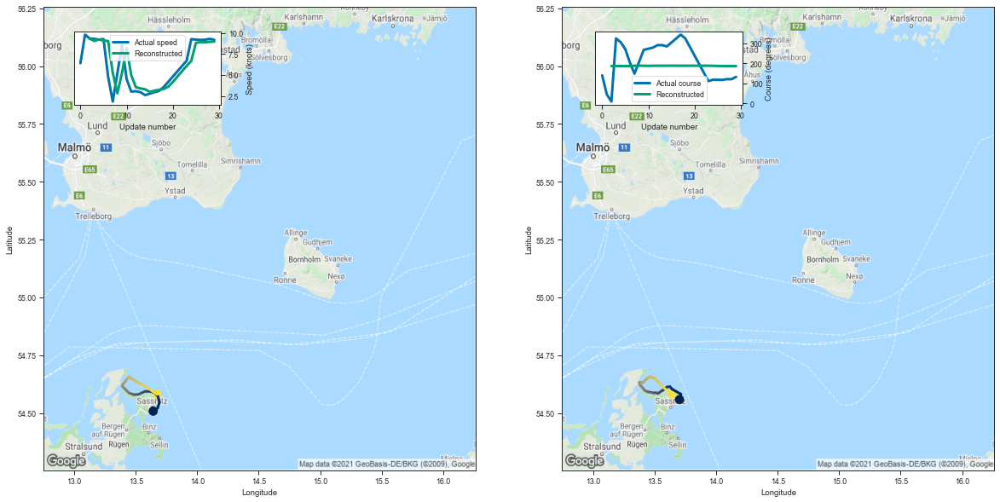

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.701896  54.558132  9.332060  186.456848         0.024846   
3   13.713986  54.581345  9.041066  186.354919         0.017240   
4   13.641807  54.603264  9.215891  186.190308         0.013939   
5   13.625801  54.613605  9.101998  186.051682         0.011316   
6   13.601602  54.612450  9.034832  186.658691         0.019903   
7   13.562340  54.596359  5.262582  187.516525         0.013247   
8   13.561225  54.596977  2.814374  188.246384         0.011942   
9   13.527330  54.584110  5.257064  187.579514         0.013982   
10  13.511292  54.587799  8.215571  187.258057         0.026072   
11  13.493641  54.586712  4.976073  187.595367         0.012678   
12  13.456228  54.590580  3.544728  187.771805         0.009031   
13  13.441529  54.591457  3.391959  187.869812         0.009289   
14  13.426388  54.596016  3.296617  187.740540         0.007857   
15  13.422383  54.596066  2.981880  188.083405         0.00981

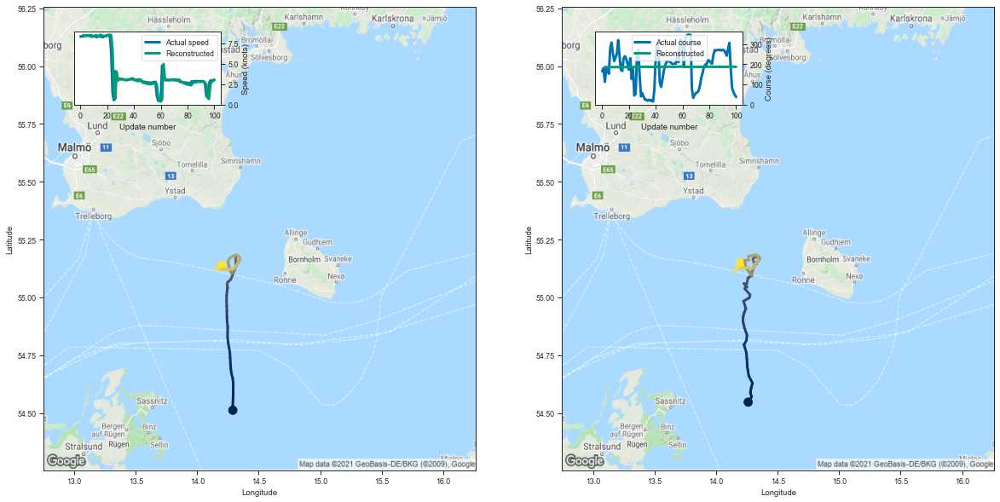

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.260880  54.546761  8.478473  186.154938         0.020442   
3    14.288841  54.570320  8.399326  185.909500         0.013293   
4    14.278602  54.587135  8.410109  185.793533         0.011141   
5    14.284873  54.607944  8.455328  185.750229         0.010686   
6    14.295671  54.629513  8.404927  185.929840         0.012478   
..         ...        ...       ...         ...              ...   
96   14.154823  55.114037  0.679186  188.313660         0.007724   
97   14.157133  55.119629  2.378852  187.788071         0.009633   
98   14.181319  55.135246  2.890603  187.455811         0.008366   
99   14.190197  55.141369  2.874825  187.145737         0.006000   
100  14.199442  55.149658  2.981723  187.196793         0.006328   

     Latitude sigma  Speed sigma  Course sigma  
2          0.011659     1.071599     97.546578  
3          0.007767     0.712770    100.757134  
4          0.006589     0.547425    

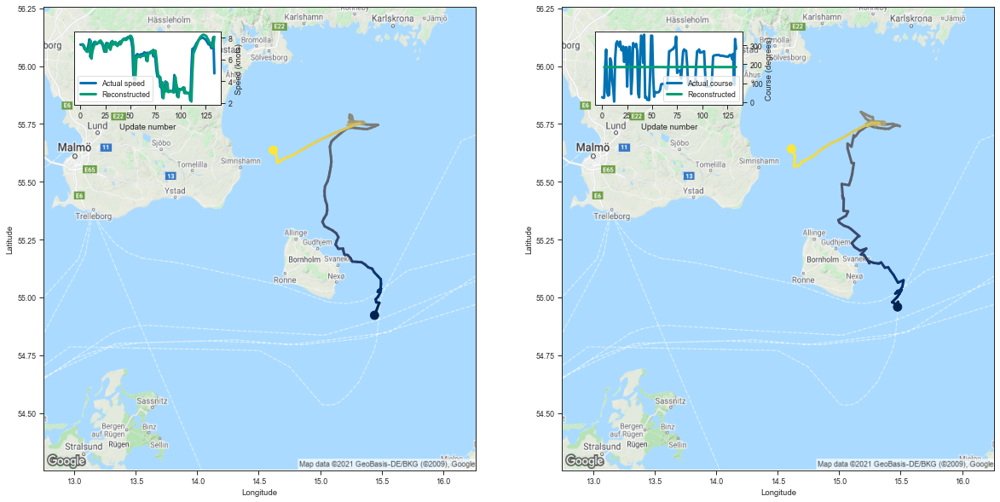

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.475300  54.958229  7.350929  185.245514         0.014611   
3    15.479850  54.980927  7.353326  185.460770         0.013940   
4    15.463920  54.971024  7.168851  185.434891         0.012800   
5    15.430545  54.979012  6.918338  185.670410         0.013940   
6    15.471957  55.000992  6.735902  185.296875         0.009317   
..         ...        ...       ...         ...              ...   
130  14.694146  55.584835  7.525132  185.857468         0.012283   
131  14.671063  55.568825  7.423695  185.527267         0.008658   
132  14.634706  55.566040  7.198976  185.487717         0.007239   
133  14.640816  55.612225  7.176504  185.819336         0.009723   
134  14.611823  55.641853  8.089781  185.759399         0.012349   

     Latitude sigma  Speed sigma  Course sigma  
2          0.009190     0.491442     91.600152  
3          0.008301     0.974048     98.315813  
4          0.007752     0.817469    

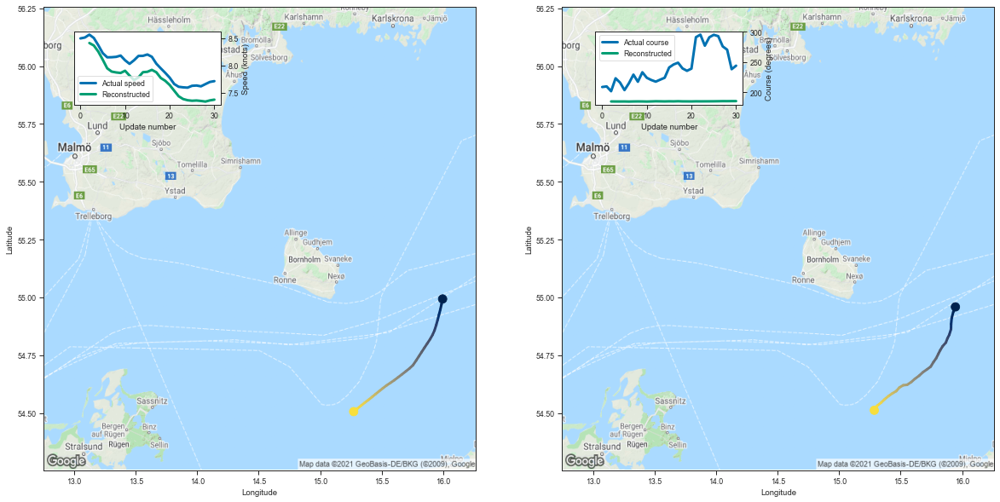

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.945333  54.958755  8.408587  185.101837         0.026568   
3   15.927977  54.936680  8.363195  185.030182         0.020239   
4   15.914991  54.910038  8.252413  185.015671         0.018109   
5   15.910511  54.884415  8.104560  185.067200         0.017752   
6   15.909697  54.862640  7.947814  184.904068         0.013980   
7   15.895328  54.838028  7.888482  185.076126         0.015551   
8   15.880376  54.822193  7.873053  185.150497         0.016597   
9   15.867650  54.804283  7.863408  185.099289         0.015551   
10  15.841135  54.788372  7.903725  184.937775         0.012863   
11  15.821200  54.770802  7.815364  185.138290         0.014652   
12  15.805386  54.754131  7.734064  185.393631         0.018354   
13  15.788859  54.736431  7.783609  185.283340         0.016695   
14  15.766908  54.719975  7.877401  185.168976         0.014886   
15  15.744380  54.700264  7.884717  185.328827         0.01689

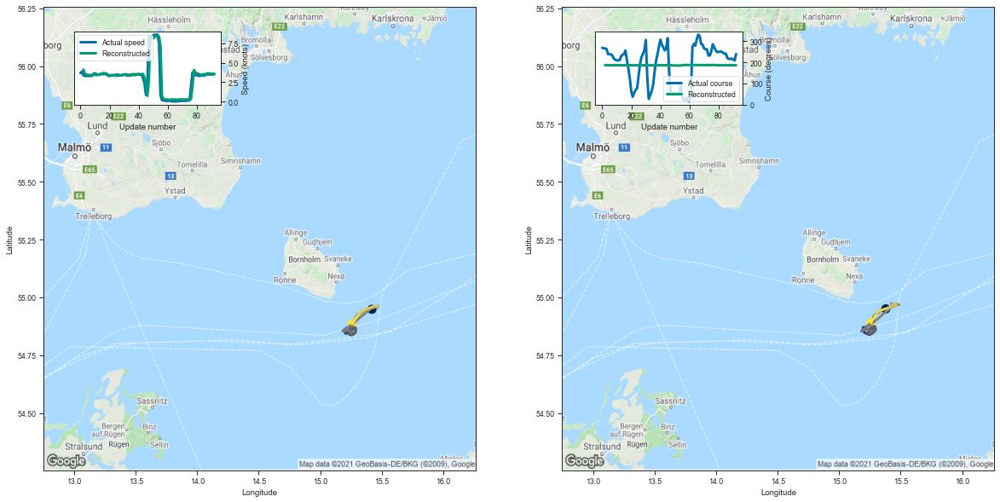

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.379703  54.950291  4.126767  186.436508         0.014777   
3   15.367249  54.947311  3.617506  186.162125         0.007188   
4   15.350059  54.946526  3.482795  186.358017         0.007305   
5   15.332012  54.940052  3.448406  186.359543         0.007167   
6   15.318681  54.935238  3.426636  186.414673         0.007335   
..        ...        ...       ...         ...              ...   
88  15.291578  54.919609  3.625443  186.249588         0.006465   
89  15.283469  54.911659  3.622021  186.331818         0.006841   
90  15.272315  54.904861  3.591683  186.338028         0.006796   
91  15.265587  54.897594  3.574699  186.364700         0.006875   
92  15.259644  54.889034  3.547328  186.417892         0.007177   

    Latitude sigma  Speed sigma  Course sigma  
2         0.009564     0.915719     92.318054  
3         0.004883     0.355062     96.242750  
4         0.004823     0.568513     99.630685  
5  

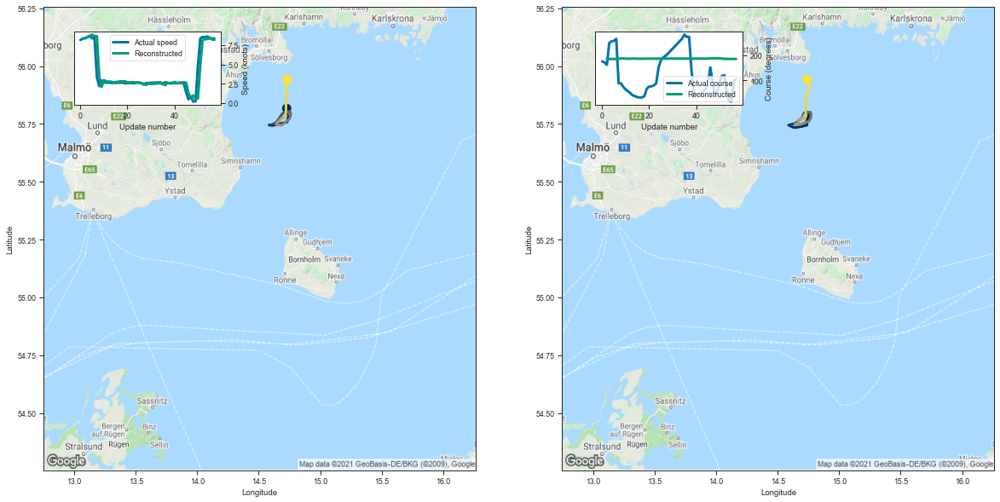

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.735314  55.785992  8.361083  185.357849         0.014547   
3   14.739284  55.756725  8.567811  185.263168         0.010787   
4   14.739487  55.744957  8.695563  185.519196         0.013706   
5   14.699894  55.739830  8.856380  185.418930         0.012819   
6   14.646763  55.734123  8.667617  185.448547         0.011775   
7   14.620667  55.736500  8.656008  186.190735         0.023756   
8   14.589979  55.744587  3.403369  187.425201         0.015349   
9   14.609982  55.747646  2.094917  187.300308         0.009165   
10  14.625381  55.749943  2.982743  186.873596         0.007723   
11  14.645248  55.752953  2.796057  186.585556         0.005171   
12  14.656828  55.756298  2.789909  186.649750         0.005277   
13  14.668456  55.763577  2.772061  187.019302         0.007819   
14  14.682120  55.769283  2.650197  186.901428         0.007046   
15  14.692255  55.772854  2.725931  186.464279         0.00456

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
56,56,4380691,261017210,Fishing,115,-641.118164,-5.574941
104,104,5025657,265681420,Fishing,134,-443.497314,-3.309681
36,36,7969192,273352230,Fishing,54,-153.286606,-2.838641
67,67,1070020,211474000,Fishing,40,-95.539742,-2.388494
73,73,1113112,211542610,Fishing,30,-69.594765,-2.319825
48,48,4303656,261007170,Fishing,101,-166.650360,-1.650004
49,49,1557318,219021428,Fishing,135,-206.000687,-1.525931
1,1,4547326,261061000,Fishing,31,-46.215878,-1.490835
78,78,140882,211314800,Fishing,93,-133.608704,-1.436653
38,38,4942336,265593190,Fishing,58,-73.822151,-1.272796


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


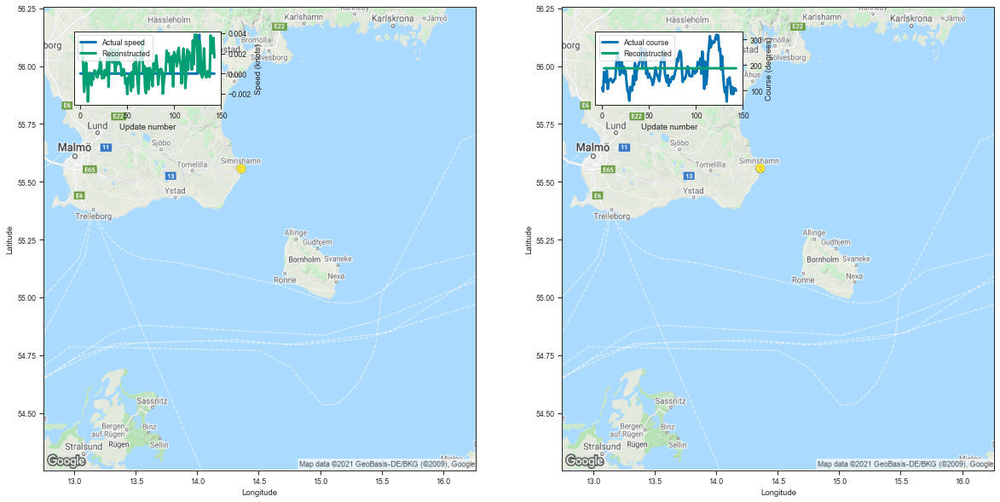

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358849  55.557163  0.002960  186.764801         0.001394   
3    14.359252  55.557446  0.000592  186.693832         0.001042   
4    14.359010  55.557621 -0.001826  186.464569         0.000762   
5    14.358899  55.558151 -0.000313  186.467926         0.000737   
6    14.359281  55.558384  0.001085  186.418121         0.000695   
..         ...        ...       ...         ...              ...   
139  14.358603  55.557762  0.003783  186.796555         0.001016   
140  14.359408  55.558155  0.001993  186.425430         0.000706   
141  14.358530  55.557331  0.002728  186.637604         0.000860   
142  14.359684  55.558273  0.003540  186.807663         0.001045   
143  14.359680  55.558048  0.001597  186.799072         0.001045   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001366     0.007242     91.738786  
3          0.000979     0.006506     96.718351  
4          0.000725     0.002955    

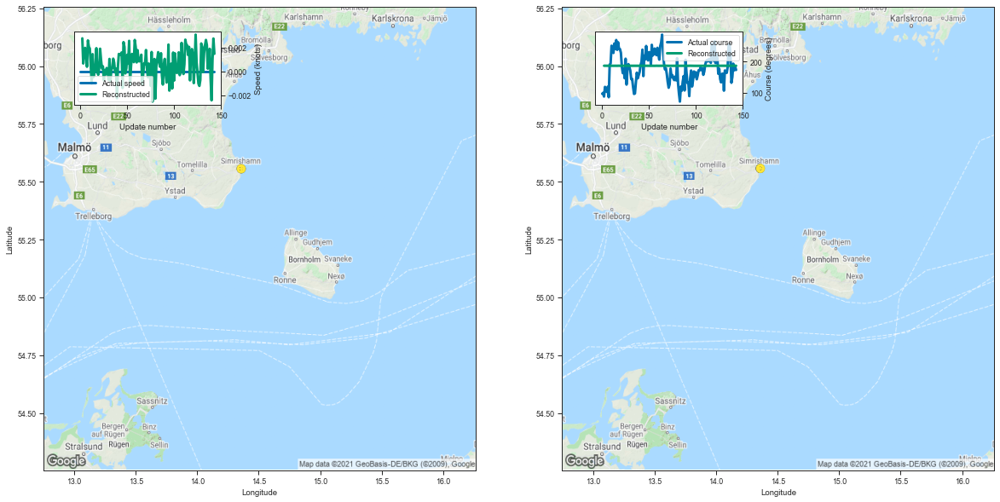

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358637  55.557415  0.002766  186.663864         0.001240   
3    14.357668  55.557652  0.000658  186.628067         0.000953   
4    14.358585  55.558067  0.001371  186.630692         0.000905   
5    14.359522  55.557613  0.001967  186.484650         0.000757   
6    14.359464  55.557636  0.001343  186.524292         0.000776   
..         ...        ...       ...         ...              ...   
139  14.358990  55.557953 -0.000583  186.566727         0.000805   
140  14.358336  55.558491 -0.002430  186.556000         0.000797   
141  14.359028  55.557983  0.000948  186.742996         0.000969   
142  14.359623  55.557613  0.002751  186.685638         0.000929   
143  14.360198  55.557487  0.001469  186.681595         0.000926   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001227     0.004896     91.494749  
3          0.000898     0.005109     96.937460  
4          0.000842     0.005418    

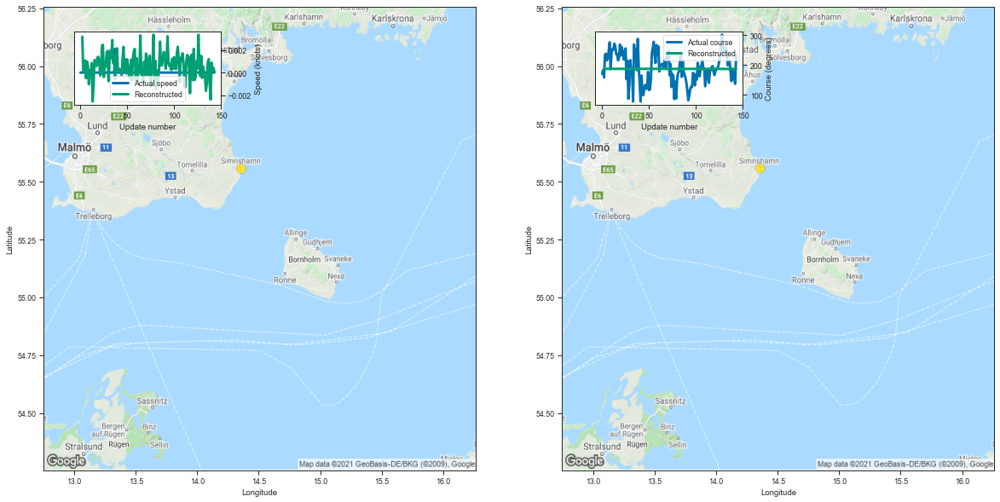

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359884  55.557251  0.003159  186.597137         0.001161   
3    14.358374  55.557762  0.000140  186.610184         0.000939   
4    14.358559  55.558186  0.000124  186.532700         0.000815   
5    14.358582  55.557961  0.001066  186.526505         0.000789   
6    14.358603  55.558029 -0.000500  186.547668         0.000802   
..         ...        ...       ...         ...              ...   
139  14.358649  55.557701 -0.002379  186.445267         0.000701   
140  14.359645  55.557087  0.000873  186.573685         0.000810   
141  14.359510  55.557140  0.000155  186.504501         0.000757   
142  14.358332  55.557865  0.000412  186.554214         0.000793   
143  14.359420  55.557022  0.000122  186.413605         0.000685   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001158     0.003831     91.164381  
3          0.000888     0.004719     96.687202  
4          0.000767     0.003699    

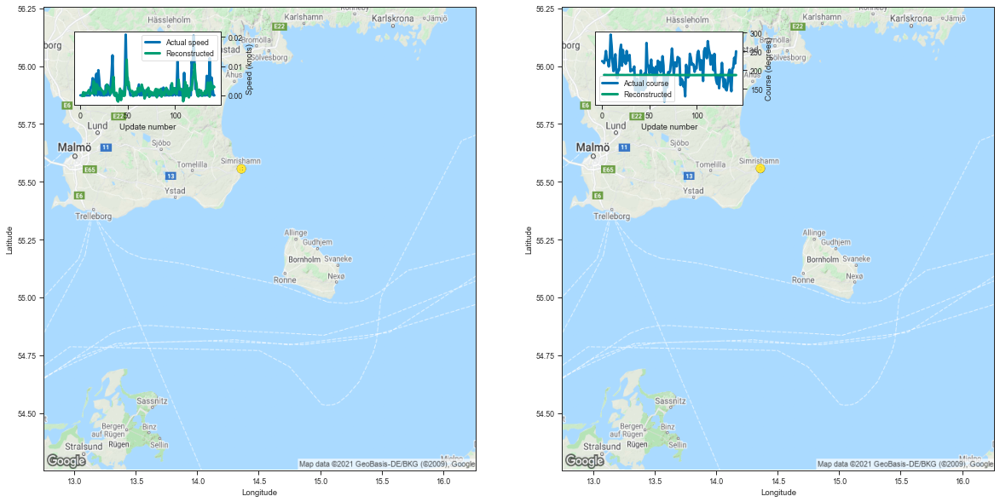

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360359  55.557014 -0.000257  186.812424         0.001475   
3    14.360380  55.557213  0.001056  186.688126         0.001037   
4    14.360037  55.557758 -0.000189  186.533768         0.000824   
5    14.360370  55.557041  0.000879  186.434265         0.000718   
6    14.360449  55.557434  0.000689  186.433456         0.000706   
..         ...        ...       ...         ...              ...   
138  14.360490  55.556709  0.004565  186.507477         0.000754   
139  14.360312  55.557404  0.003515  186.671783         0.000904   
140  14.359824  55.557919  0.002048  186.551208         0.000807   
141  14.360297  55.557770  0.003150  186.666580         0.000907   
142  14.359962  55.557774  0.002822  186.556274         0.000811   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001444     0.008269     91.581781  
3          0.000977     0.006354     96.641008  
4          0.000780     0.003785    

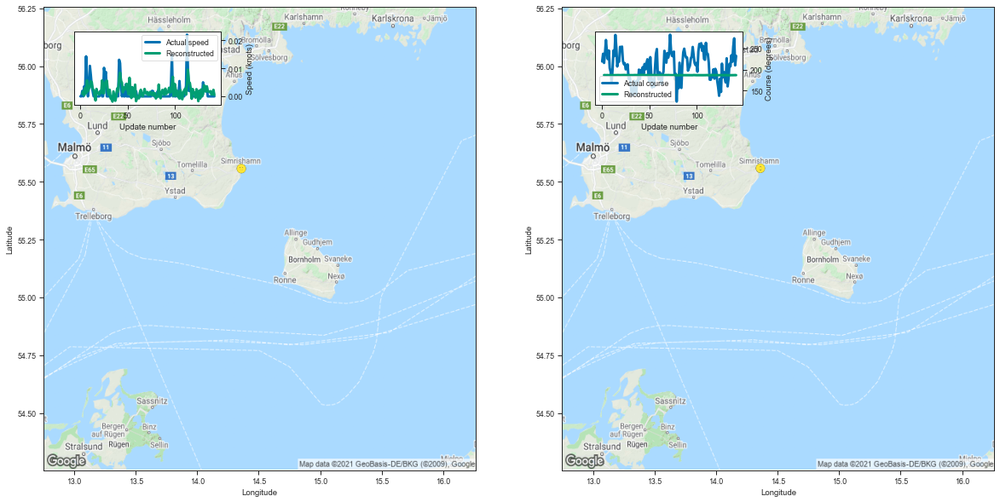

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359696  55.558205  0.000889  186.695007         0.001297   
3    14.359371  55.558128  0.001788  186.494690         0.000837   
4    14.360043  55.558216  0.000295  186.488861         0.000774   
5    14.360223  55.558502  0.002957  186.568069         0.000822   
6    14.360850  55.557663  0.001135  186.576004         0.000829   
..         ...        ...       ...         ...              ...   
138  14.360369  55.558277  0.001838  186.459366         0.000718   
139  14.359901  55.558235  0.000628  186.441254         0.000704   
140  14.360662  55.557938  0.000772  186.549713         0.000788   
141  14.360953  55.557762  0.002309  186.691788         0.000924   
142  14.360176  55.558369  0.000491  186.520096         0.000777   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001288     0.005453     91.180480  
3          0.000804     0.003115     96.077844  
4          0.000731     0.003204    

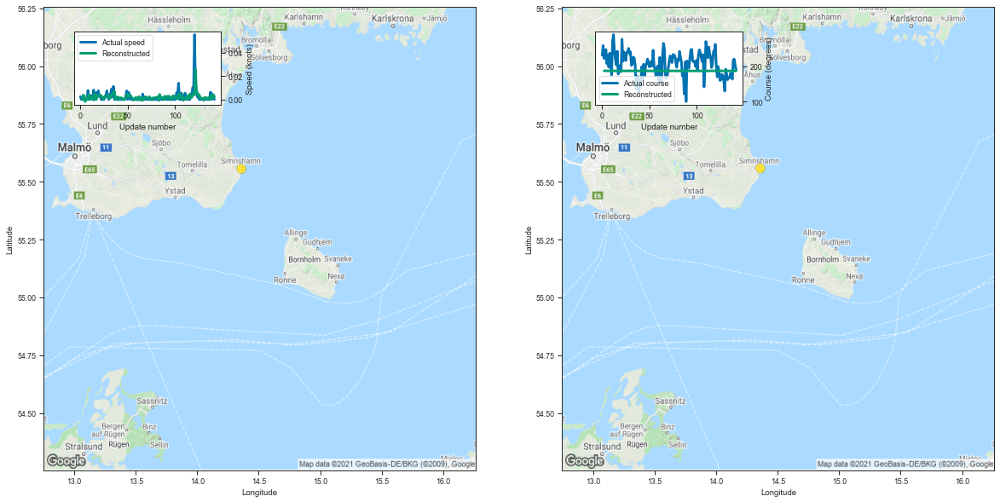

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359917  55.557880  0.000176  186.754395         0.001393   
3    14.360616  55.557114  0.003639  186.862656         0.001227   
4    14.360871  55.557026  0.003061  186.644714         0.000938   
5    14.360242  55.557365 -0.001810  186.615524         0.000878   
6    14.360399  55.557114  0.000693  186.558578         0.000820   
..         ...        ...       ...         ...              ...   
138  14.361056  55.557281  0.002494  186.569794         0.000815   
139  14.359938  55.557686  0.003752  186.444519         0.000713   
140  14.360306  55.557213  0.000789  186.594894         0.000830   
141  14.360531  55.556801  0.003795  186.569244         0.000818   
142  14.359675  55.558002  0.002307  186.566177         0.000812   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001378     0.006821     91.199997  
3          0.001129     0.011397     97.467863  
4          0.000877     0.005731    

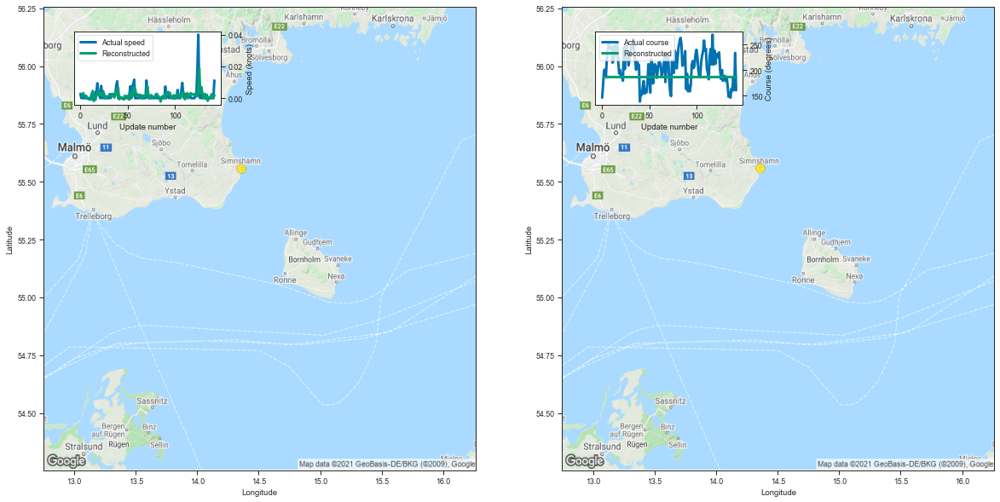

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360681  55.557659  0.001216  186.746155         0.001396   
3    14.360388  55.556927  0.003205  186.558472         0.000900   
4    14.360372  55.557381  0.000861  186.482101         0.000774   
5    14.360498  55.557667  0.000839  186.645035         0.000892   
6    14.360374  55.557018  0.001523  186.460236         0.000737   
..         ...        ...       ...         ...              ...   
138  14.359781  55.557415  0.000413  186.479355         0.000734   
139  14.359898  55.557148  0.002412  186.525665         0.000773   
140  14.360365  55.557785  0.000950  186.427505         0.000697   
141  14.360199  55.557175  0.000034  186.433548         0.000696   
142  14.360476  55.557354  0.001894  186.447540         0.000708   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001383     0.006603     90.976050  
3          0.000861     0.003966     96.168122  
4          0.000732     0.003147    

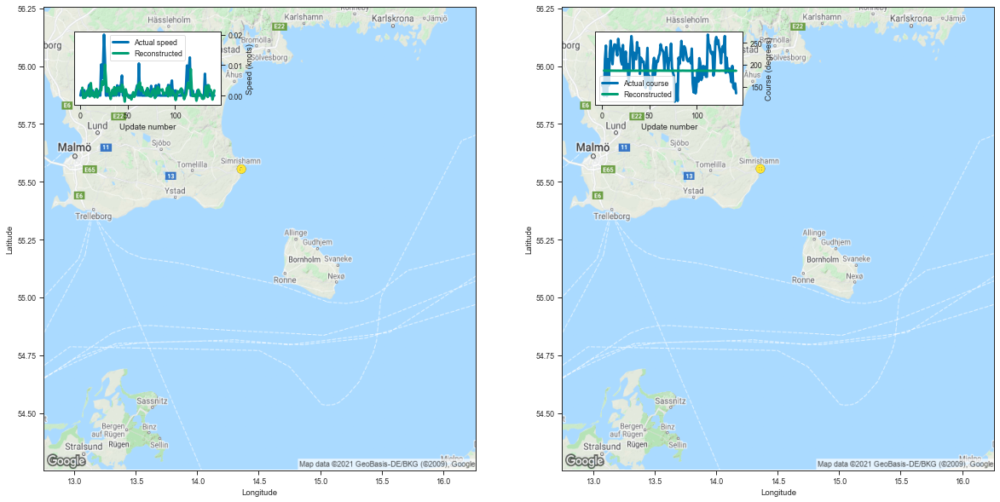

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360061  55.556095  0.002551  186.901230         0.001629   
3    14.360456  55.556961 -0.000827  186.750000         0.001105   
4    14.360203  55.556332  0.000784  186.522919         0.000819   
5    14.359831  55.557076 -0.000737  186.591141         0.000847   
6    14.360653  55.556854 -0.000058  186.540680         0.000796   
..         ...        ...       ...         ...              ...   
138  14.360284  55.556210  0.001884  186.587265         0.000821   
139  14.360144  55.557148  0.001057  186.476532         0.000739   
140  14.360875  55.556087 -0.001338  186.421967         0.000688   
141  14.360785  55.556149  0.000049  186.581451         0.000809   
142  14.359579  55.556210  0.001673  186.414215         0.000688   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001581     0.011228     91.694029  
3          0.001037     0.007885     96.733526  
4          0.000777     0.003660    

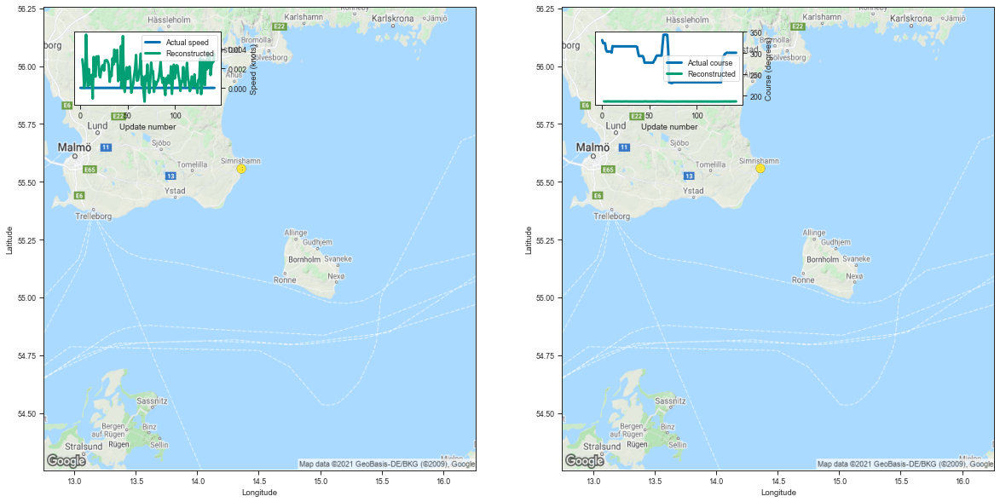

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360410  55.557407  0.002951  186.907593         0.001611   
3    14.360456  55.557648  0.002045  186.575089         0.000919   
4    14.361191  55.556938 -0.000015  186.589615         0.000866   
5    14.360838  55.557796  0.000765  186.661057         0.000916   
6    14.360935  55.557308  0.005495  186.913116         0.001174   
..         ...        ...       ...         ...              ...   
138  14.360204  55.557240  0.001329  186.547943         0.000800   
139  14.360725  55.556873  0.002387  186.719604         0.000954   
140  14.360854  55.556877  0.002649  186.745514         0.000996   
141  14.360884  55.556751  0.002706  186.627243         0.000878   
142  14.360402  55.557716  0.003531  186.811020         0.001054   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001560     0.011833     92.169447  
3          0.000881     0.004280     96.117797  
4          0.000810     0.004701    

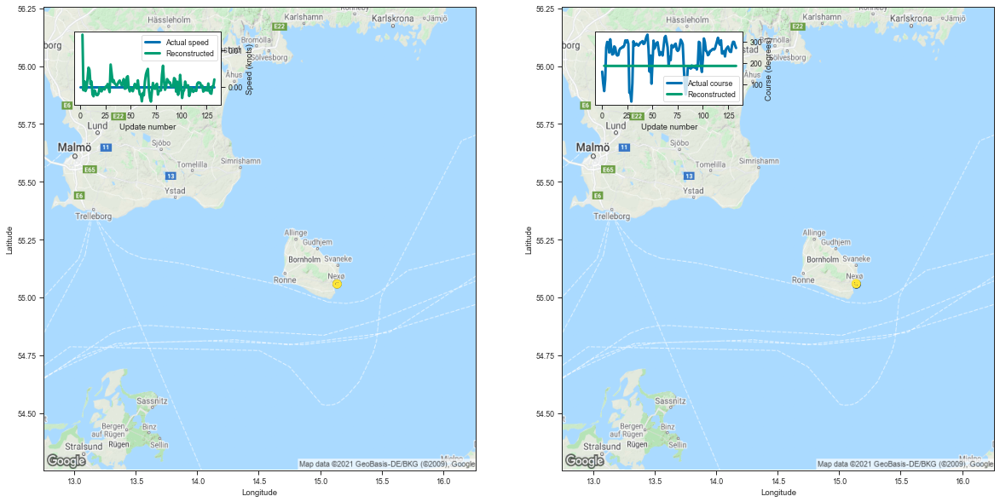

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140368  55.057426  0.014240  186.980148         0.002588   
3    15.139497  55.058495 -0.001025  186.567276         0.001303   
4    15.139365  55.058731  0.001413  186.399094         0.001000   
5    15.137827  55.059288 -0.001222  186.432434         0.001004   
6    15.138412  55.059307 -0.000540  186.408096         0.000973   
..         ...        ...       ...         ...              ...   
129  15.138859  55.059341 -0.001812  186.334229         0.000873   
130  15.138195  55.059784 -0.001960  186.380203         0.000926   
131  15.139126  55.059067  0.000042  186.350159         0.000899   
132  15.138671  55.059380  0.000073  186.387909         0.000935   
133  15.138168  55.059174  0.001951  186.316895         0.000872   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002356     0.046764     95.600334  
3          0.001196     0.013601    100.091750  
4          0.000921     0.007852    

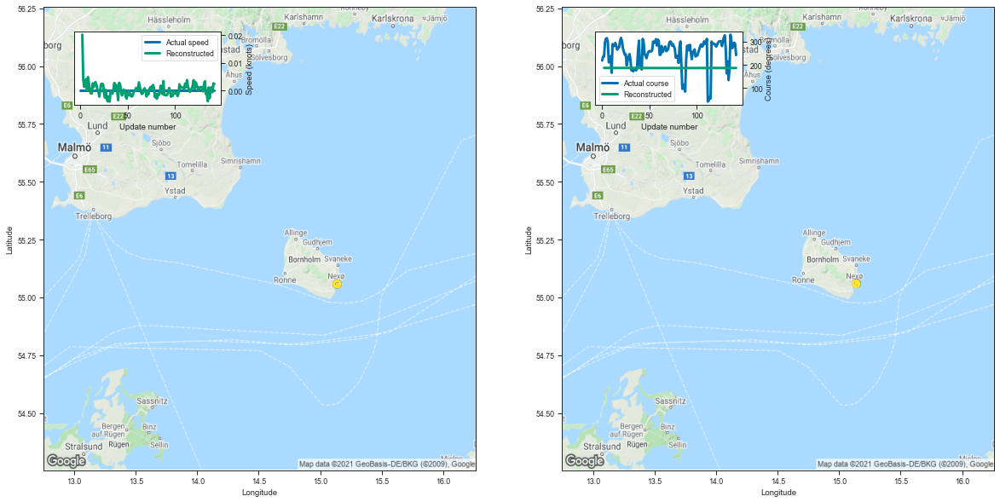

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140435  55.060078  0.020137  187.100250         0.003185   
3    15.138651  55.059982  0.003854  186.619446         0.001462   
4    15.138131  55.059544  0.001287  186.726196         0.001447   
5    15.138436  55.060268  0.002456  186.614334         0.001277   
6    15.139252  55.058685  0.004063  186.422562         0.001019   
..         ...        ...       ...         ...              ...   
138  15.138457  55.059601  0.000775  186.275177         0.000837   
139  15.138235  55.059669  0.001132  186.279938         0.000831   
140  15.137523  55.060200 -0.000655  186.266998         0.000817   
141  15.138611  55.058895  0.002548  186.513428         0.001058   
142  15.138926  55.059223  0.002348  186.325607         0.000892   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002898     0.071337     94.242141  
3          0.001358     0.016166     98.635545  
4          0.001292     0.025277    

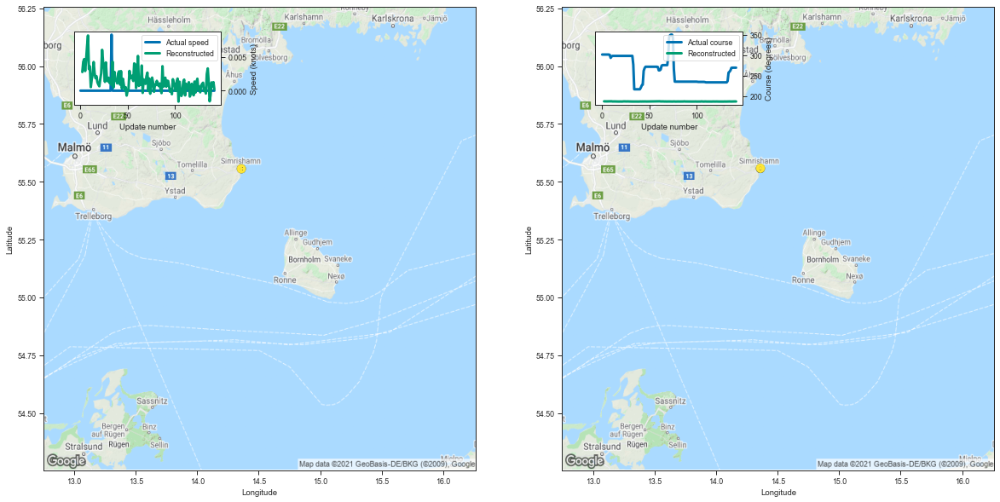

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360037  55.557327  0.002776  186.982498         0.001755   
3    14.360762  55.557159  0.004294  186.911423         0.001316   
4    14.360992  55.557465  0.004691  186.958771         0.001306   
5    14.360888  55.556812  0.002923  186.833252         0.001136   
6    14.360703  55.557228  0.004514  186.935944         0.001233   
..         ...        ...       ...         ...              ...   
138  14.360378  55.558090 -0.000589  186.591217         0.000831   
139  14.361043  55.558365  0.001227  186.807465         0.001042   
140  14.361060  55.558067  0.000671  186.758438         0.001007   
141  14.360596  55.558384  0.001260  186.784439         0.001028   
142  14.360563  55.558308  0.000198  186.625519         0.000883   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001688     0.015348     92.261406  
3          0.001211     0.014134     97.337966  
4          0.001179     0.017399    

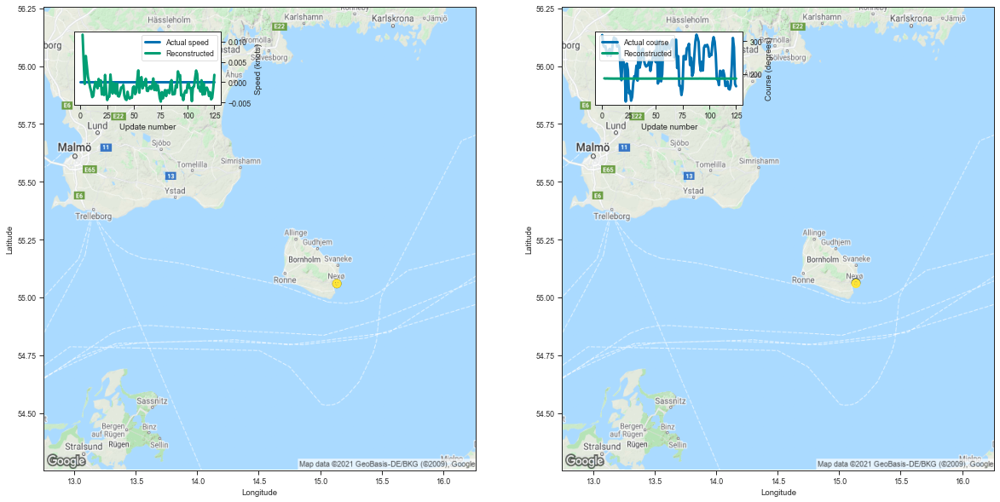

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.136608  55.063026  0.011736  187.000229         0.002739   
3    15.137178  55.061195  0.005204  186.525787         0.001289   
4    15.136183  55.061630 -0.000424  186.680527         0.001349   
5    15.137395  55.060719  0.006472  186.688171         0.001354   
6    15.137485  55.060848  0.003994  186.498581         0.001115   
..         ...        ...       ...         ...              ...   
121  15.137237  55.060440 -0.002445  186.377426         0.000917   
122  15.136937  55.061092 -0.004210  186.288498         0.000841   
123  15.137814  55.060314 -0.003816  186.297501         0.000842   
124  15.137130  55.060612 -0.001370  186.266617         0.000817   
125  15.136710  55.060097  0.001823  186.311401         0.000850   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002509     0.050645     94.769478  
3          0.001202     0.011444     98.919648  
4          0.001206     0.020552    

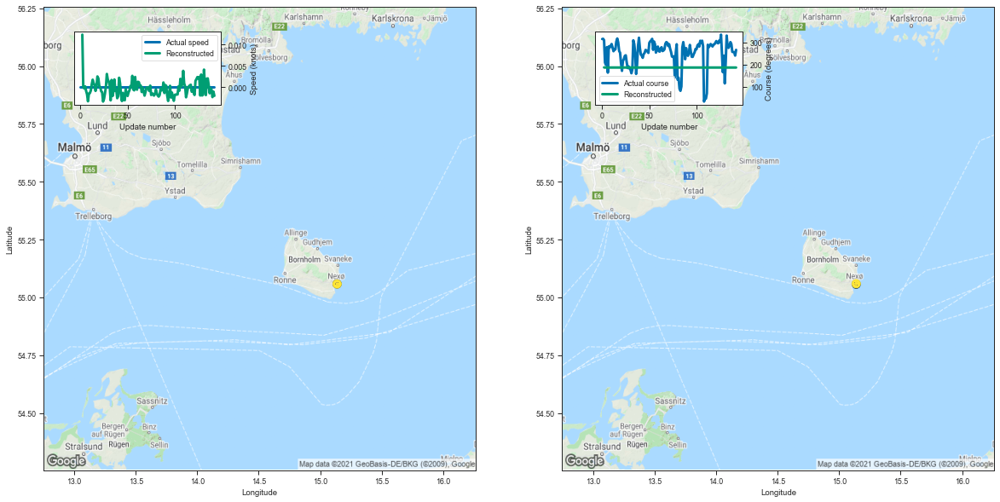

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138773  55.056927  0.012369  186.823746         0.002272   
3    15.137918  55.059299 -0.000033  186.383301         0.001085   
4    15.137918  55.060169 -0.000313  186.382065         0.000971   
5    15.138523  55.060429  0.000164  186.449493         0.001019   
6    15.138348  55.059566 -0.000896  186.365616         0.000927   
..         ...        ...       ...         ...              ...   
138  15.138067  55.059830 -0.000314  186.268387         0.000822   
139  15.138083  55.059807 -0.000596  186.316040         0.000858   
140  15.138366  55.059868 -0.002359  186.267120         0.000819   
141  15.139159  55.058594 -0.001060  186.312714         0.000856   
142  15.138864  55.058960 -0.002059  186.265045         0.000816   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002125     0.027155     94.164962  
3          0.001024     0.006847     98.981217  
4          0.000895     0.007125    

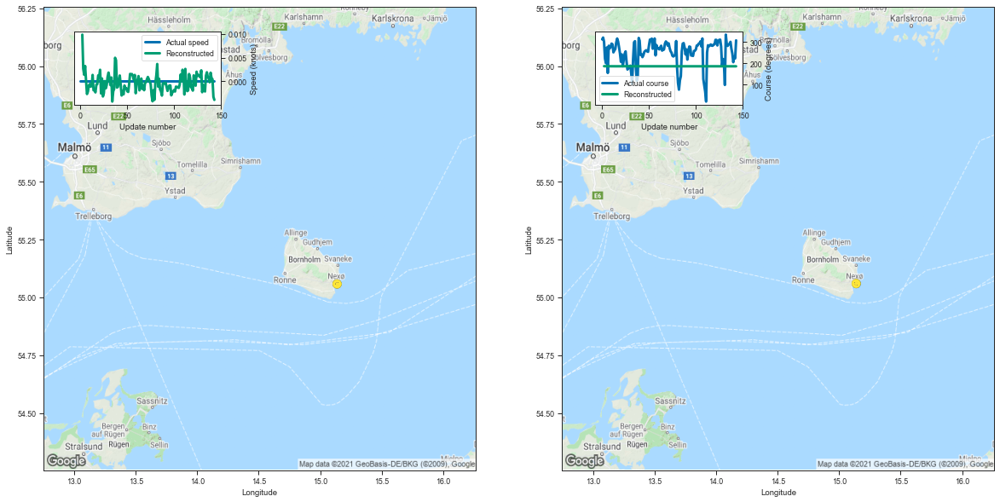

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139337  55.059544  0.009821  186.832535         0.002212   
3    15.138283  55.059895  0.002659  186.500305         0.001225   
4    15.138512  55.059967  0.001383  186.536743         0.001161   
5    15.138429  55.060112  0.003229  186.481705         0.001072   
6    15.138416  55.059780  0.000114  186.391602         0.000967   
..         ...        ...       ...         ...              ...   
139  15.138591  55.058914  0.001818  186.298386         0.000851   
140  15.138510  55.059059  0.000648  186.449554         0.000994   
141  15.138259  55.060009  0.000463  186.303818         0.000863   
142  15.138702  55.059536 -0.003261  186.268509         0.000819   
143  15.138528  55.059658 -0.003895  186.264587         0.000810   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002054     0.027800     95.096471  
3          0.001136     0.010419     99.588014  
4          0.001053     0.012633    

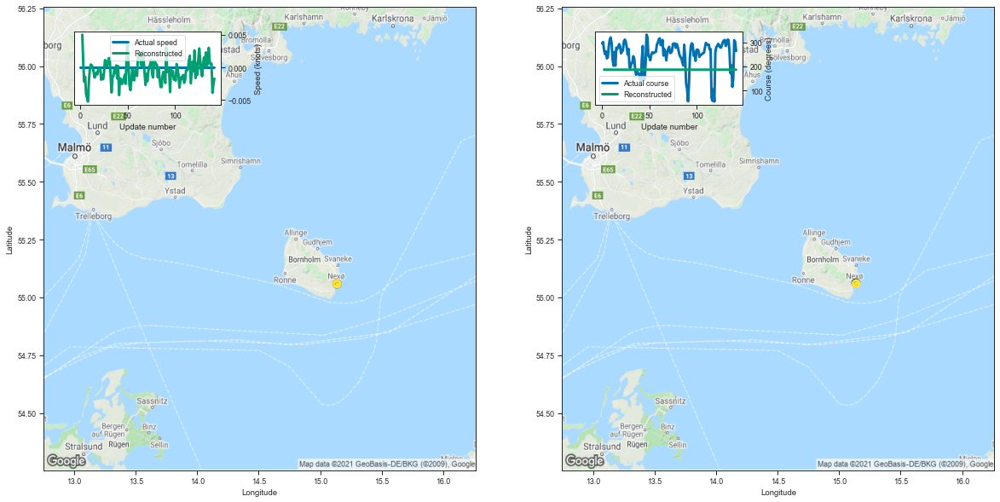

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.136903  55.061909  0.005032  186.679092         0.001980   
3    15.138420  55.060143  0.000575  186.481125         0.001184   
4    15.138351  55.059769 -0.002211  186.451843         0.001060   
5    15.138087  55.060024 -0.001449  186.310471         0.000887   
6    15.138782  55.059605 -0.004119  186.361450         0.000913   
..         ...        ...       ...         ...              ...   
138  15.138493  55.059505  0.000437  186.331711         0.000873   
139  15.138903  55.059048  0.000568  186.324112         0.000861   
140  15.138533  55.060234 -0.003899  186.262054         0.000809   
141  15.138164  55.059944 -0.002567  186.266052         0.000813   
142  15.139084  55.058941 -0.001729  186.267349         0.000815   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001894     0.016431     93.157938  
3          0.001099     0.009560     99.665544  
4          0.000973     0.009261    

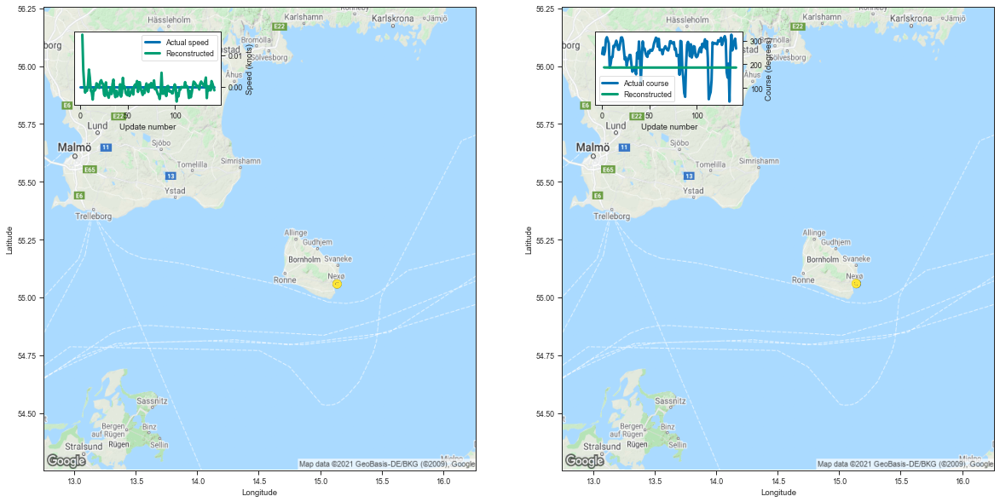

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140479  55.059376  0.016603  187.023972         0.002924   
3    15.138876  55.059555  0.005383  186.592285         0.001405   
4    15.138586  55.059578  0.000533  186.607422         0.001274   
5    15.138291  55.060017 -0.001930  186.499344         0.001106   
6    15.138385  55.059872 -0.001036  186.378983         0.000958   
..         ...        ...       ...         ...              ...   
138  15.138886  55.059792 -0.001217  186.320847         0.000877   
139  15.139102  55.059055  0.001762  186.476562         0.001028   
140  15.137914  55.060234  0.000945  186.300842         0.000867   
141  15.138496  55.058994 -0.000072  186.283966         0.000834   
142  15.138311  55.059639 -0.001194  186.323959         0.000869   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002682     0.055809     94.139021  
3          0.001304     0.014617     98.853486  
4          0.001152     0.016366    

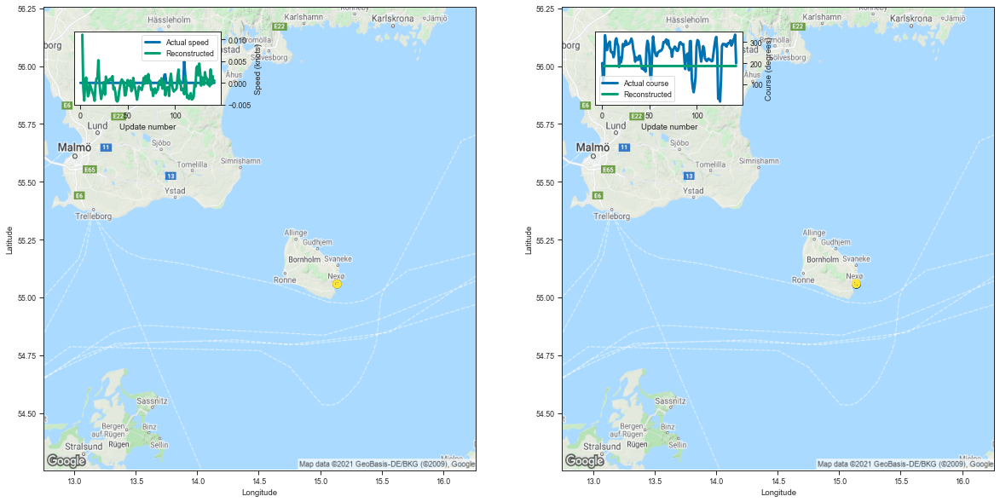

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140341  55.057060  0.011140  186.700592         0.001994   
3    15.140402  55.058422 -0.001109  186.449036         0.001140   
4    15.139007  55.058914 -0.004093  186.419296         0.001013   
5    15.137228  55.059929 -0.000257  186.360214         0.000932   
6    15.138158  55.059494  0.001240  186.440369         0.001000   
..         ...        ...       ...         ...              ...   
138  15.138321  55.059082  0.003102  186.362488         0.000916   
139  15.138407  55.059292 -0.000295  186.421005         0.000967   
140  15.138906  55.059593  0.001616  186.324860         0.000884   
141  15.138781  55.059547  0.000185  186.273438         0.000830   
142  15.138779  55.059444  0.000511  186.271423         0.000823   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001892     0.017905     93.762083  
3          0.001060     0.008599     99.728303  
4          0.000929     0.008218    

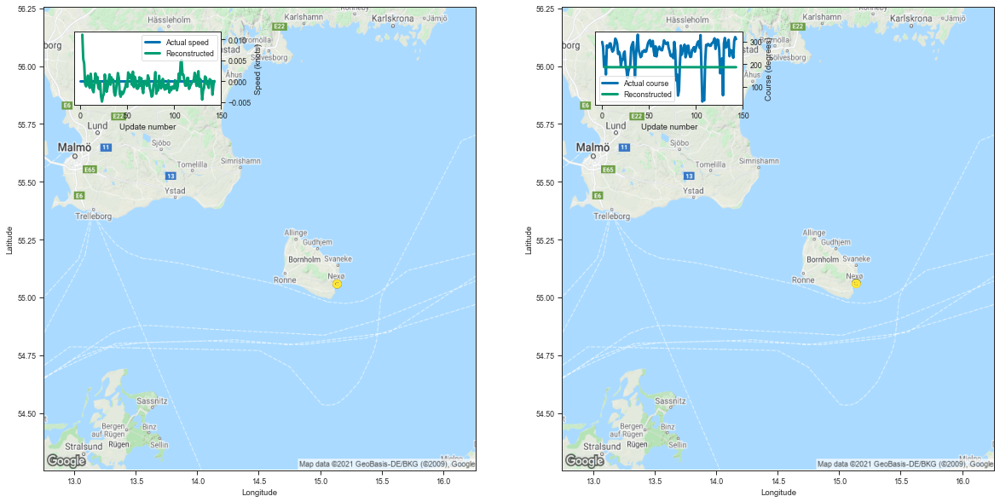

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139091  55.060703  0.011157  186.819412         0.002270   
3    15.138886  55.059917  0.005338  186.606400         0.001377   
4    15.139044  55.059486  0.004245  186.734375         0.001436   
5    15.139228  55.060207 -0.000599  186.575668         0.001205   
6    15.138848  55.059120 -0.001214  186.369400         0.000955   
..         ...        ...       ...         ...              ...   
139  15.138760  55.059292  0.000252  186.326096         0.000887   
140  15.139082  55.058907  0.000101  186.335938         0.000885   
141  15.137850  55.060154 -0.003214  186.306778         0.000854   
142  15.138724  55.059525 -0.000895  186.384598         0.000927   
143  15.139233  55.058960  0.000072  186.284164         0.000842   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002132     0.026609     93.939408  
3          0.001263     0.015234     99.839026  
4          0.001274     0.024689    

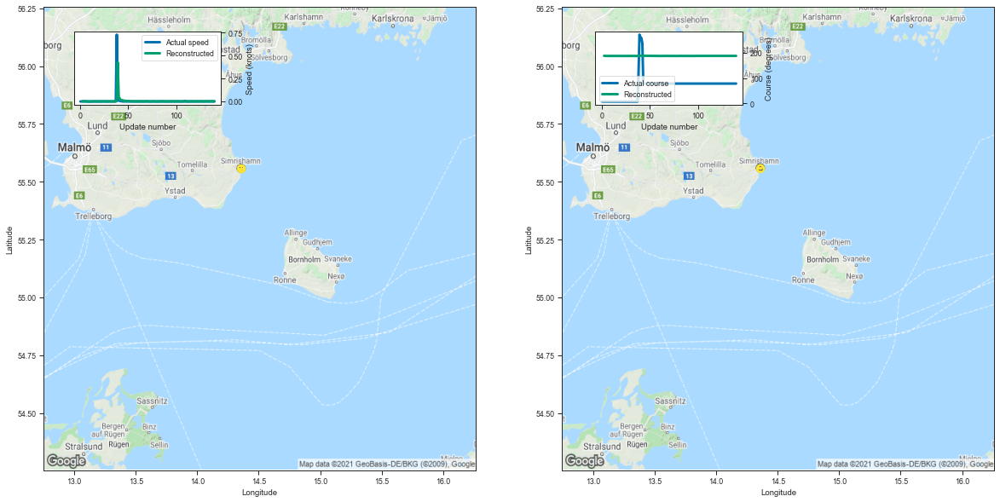

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359642  55.559475  0.001584  186.917572         0.001584   
3    14.359972  55.558422  0.003027  186.630173         0.000957   
4    14.359696  55.558525  0.003362  186.530045         0.000800   
5    14.359109  55.559090  0.001282  186.483719         0.000740   
6    14.358546  55.559334  0.001817  186.412628         0.000680   
..         ...        ...       ...         ...              ...   
136  14.359404  55.558437  0.001519  186.624084         0.000857   
137  14.360179  55.557365  0.003077  186.428055         0.000698   
138  14.359259  55.558155  0.001003  186.515884         0.000756   
139  14.359593  55.558113  0.001709  186.461548         0.000716   
140  14.360588  55.557350  0.003472  186.686508         0.000908   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001509     0.012859     93.283270  
3          0.000905     0.005594     97.068069  
4          0.000751     0.004021    

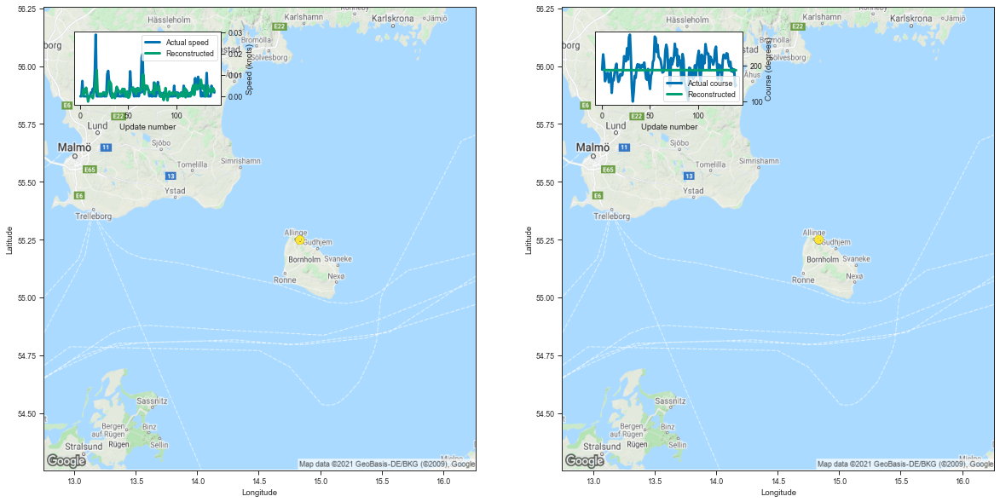

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836011  55.248920  0.000228  186.722733         0.001676   
3    14.836890  55.250134  0.003220  186.550491         0.001112   
4    14.836522  55.249729  0.001276  186.435944         0.000910   
5    14.837870  55.248665  0.002806  186.470383         0.000916   
6    14.837591  55.249496  0.003982  186.663727         0.001102   
..         ...        ...       ...         ...              ...   
136  14.837015  55.250385  0.002945  186.372665         0.000797   
137  14.837169  55.250011  0.001572  186.432953         0.000852   
138  14.837334  55.249790  0.003877  186.438721         0.000863   
139  14.836508  55.251076  0.003542  186.478455         0.000901   
140  14.835717  55.250015  0.002459  186.321396         0.000763   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001607     0.011116     93.323164  
3          0.001032     0.007348     98.548370  
4          0.000843     0.005233    

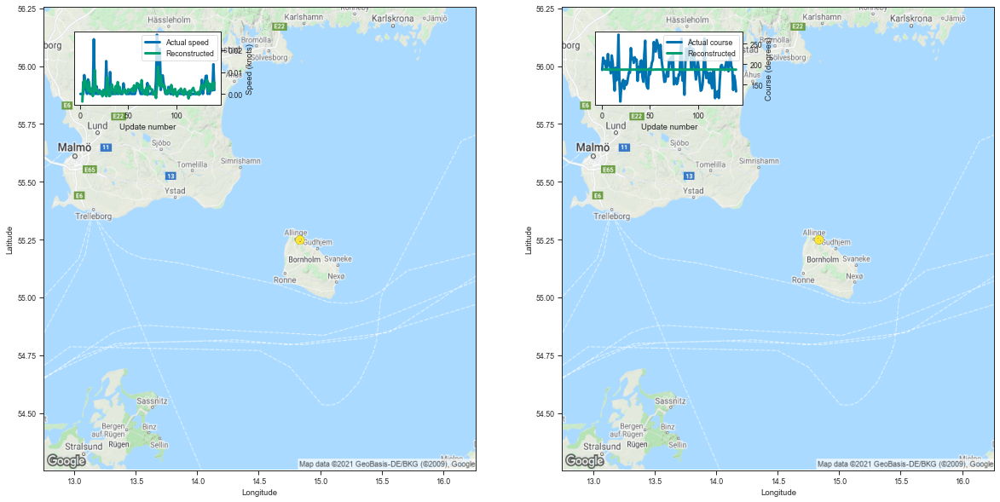

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836935  55.249119 -0.003490  186.820465         0.001946   
3    14.837957  55.249340  0.005607  186.846359         0.001518   
4    14.837002  55.249813  0.002745  186.578613         0.001091   
5    14.837334  55.250305  0.006343  186.665497         0.001147   
6    14.837059  55.250584  0.004005  186.407028         0.000868   
..         ...        ...       ...         ...              ...   
136  14.837140  55.249928  0.003539  186.461868         0.000895   
137  14.837375  55.249714  0.002019  186.392181         0.000824   
138  14.837076  55.249176  0.005177  186.444061         0.000864   
139  14.837194  55.248966  0.002186  186.422318         0.000845   
140  14.836274  55.249249  0.005300  186.369324         0.000802   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001869     0.015739     92.441361  
3          0.001367     0.020474     99.330557  
4          0.001004     0.008716    

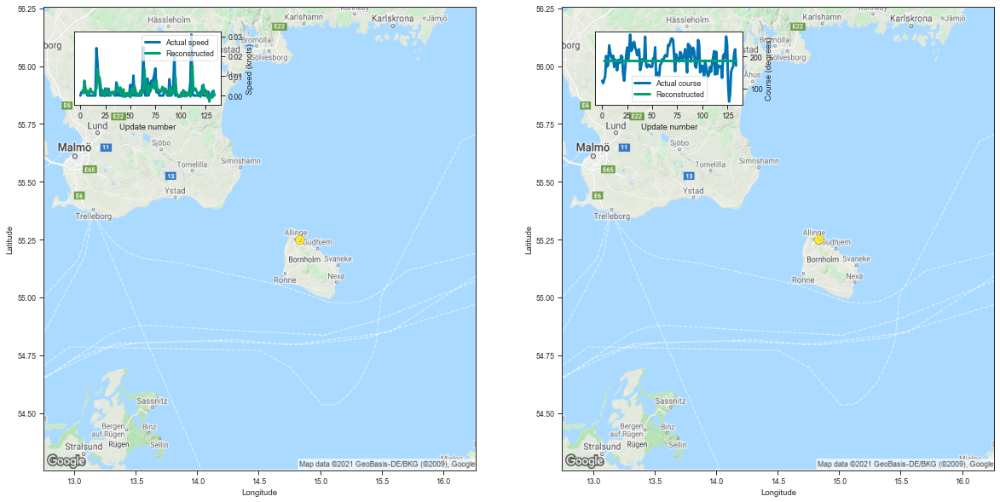

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837409  55.249027  0.002463  186.601929         0.001485   
3    14.836806  55.249454  0.001233  186.540436         0.001080   
4    14.836559  55.249218  0.007533  186.774353         0.001286   
5    14.837274  55.249763  0.003635  186.394135         0.000870   
6    14.837008  55.249119  0.001135  186.364044         0.000805   
..         ...        ...       ...         ...              ...   
130  14.836841  55.248772 -0.000552  186.631851         0.001052   
131  14.836624  55.249168  0.000403  186.580338         0.001020   
132  14.836863  55.249638 -0.001017  186.533142         0.000968   
133  14.836464  55.250156  0.002466  186.571793         0.001000   
134  14.836565  55.249657  0.000476  186.418320         0.000857   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001440     0.007444     92.940778  
3          0.000999     0.007063     98.921607  
4          0.001137     0.017223    

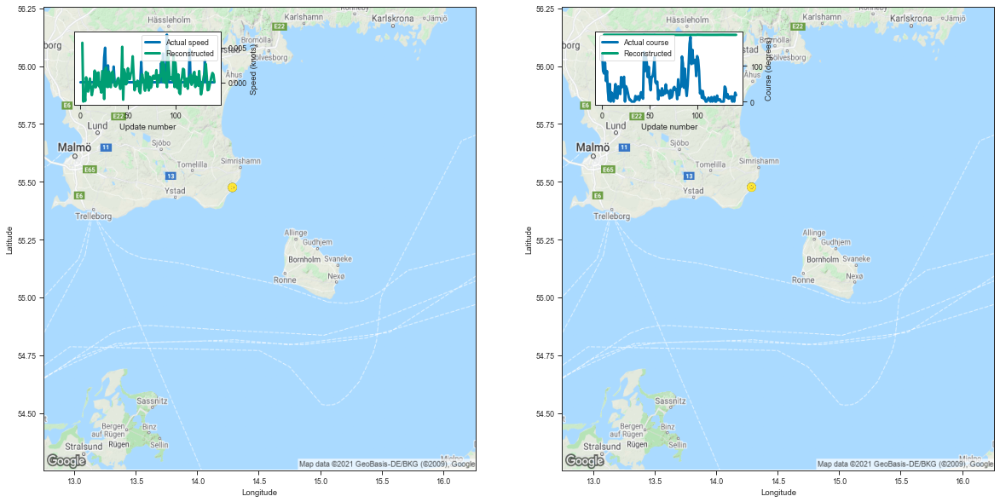

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287810  55.476814  0.005713  186.698471         0.001225   
3    14.287196  55.477268 -0.002794  186.695587         0.000979   
4    14.287860  55.476746 -0.001368  186.584763         0.000824   
5    14.288370  55.476067 -0.002706  186.545761         0.000765   
6    14.288039  55.477242  0.000712  186.567917         0.000781   
..         ...        ...       ...         ...              ...   
137  14.287438  55.477043  0.000184  186.468231         0.000688   
138  14.287834  55.476250  0.000843  186.464645         0.000681   
139  14.287311  55.477005  0.001343  186.537720         0.000739   
140  14.288123  55.476265  0.001115  186.596634         0.000786   
141  14.288123  55.476128  0.000068  186.471954         0.000694   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001191     0.004941     92.522416  
3          0.000906     0.005706     97.903183  
4          0.000764     0.003979    

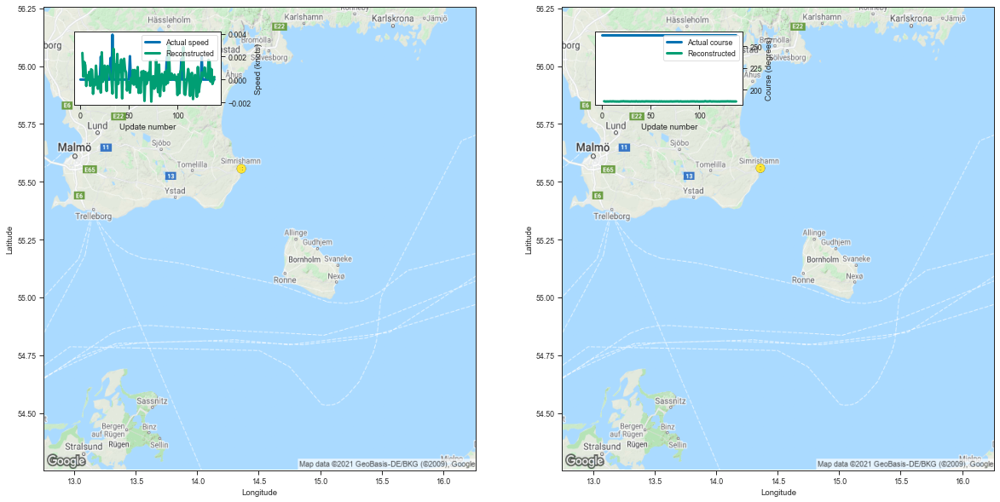

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360343  55.558598  0.002321  186.805618         0.001449   
3    14.359680  55.558376  0.000258  186.493149         0.000840   
4    14.360958  55.557991  0.001533  186.438843         0.000734   
5    14.361115  55.557728  0.001245  186.578140         0.000827   
6    14.360673  55.557610 -0.000555  186.476028         0.000745   
..         ...        ...       ...         ...              ...   
134  14.360935  55.557625 -0.000164  186.557785         0.000806   
135  14.360707  55.558002  0.000914  186.558380         0.000805   
136  14.360574  55.558098 -0.000381  186.426086         0.000699   
137  14.360608  55.557636 -0.000106  186.417709         0.000686   
138  14.360063  55.558723  0.000234  186.537674         0.000778   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001419     0.007921     91.665391  
3          0.000810     0.003119     95.935617  
4          0.000697     0.002688    

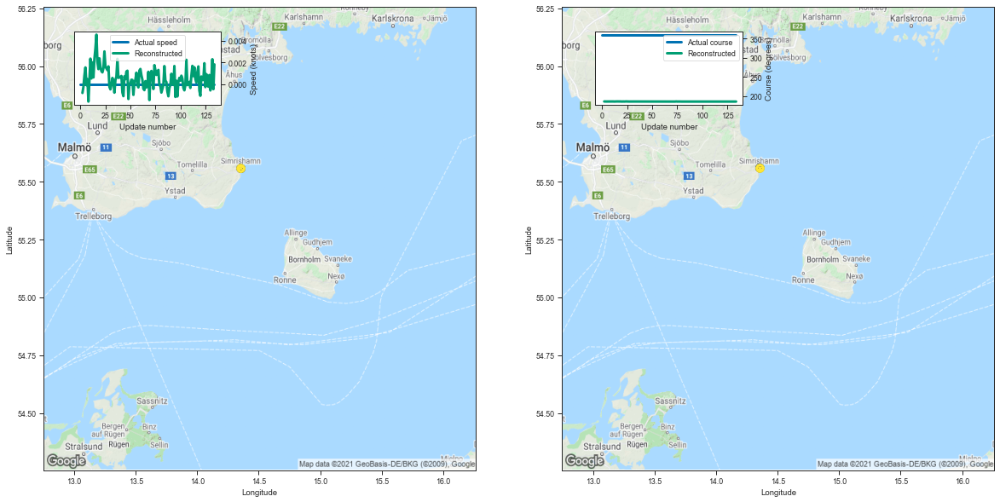

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.355948  55.559189 -0.000832  186.692413         0.001279   
3    14.356569  55.559277 -0.000270  186.567413         0.000894   
4    14.357406  55.558586  0.000776  186.551392         0.000828   
5    14.357521  55.558590  0.001533  186.597992         0.000850   
6    14.357070  55.558544 -0.000106  186.460815         0.000733   
..         ...        ...       ...         ...              ...   
130  14.356916  55.558598 -0.000598  186.451859         0.000711   
131  14.356940  55.558578  0.000443  186.417053         0.000685   
132  14.357363  55.558056  0.002292  186.502213         0.000749   
133  14.356459  55.559185 -0.000478  186.533859         0.000778   
134  14.357152  55.558266  0.001812  186.428619         0.000698   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001271     0.005575     91.456049  
3          0.000854     0.004186     96.588250  
4          0.000779     0.004149    

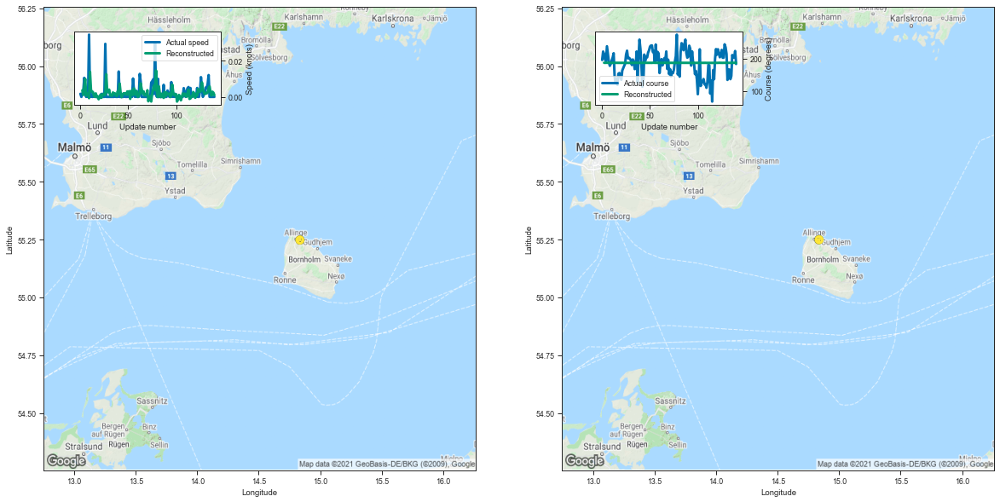

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835509  55.249378  0.003633  186.659546         0.001579   
3    14.836877  55.249485  0.001105  186.477417         0.001024   
4    14.837364  55.249752  0.005800  186.715149         0.001213   
5    14.837918  55.249275  0.009936  186.597916         0.001076   
6    14.836308  55.249401  0.000681  186.479904         0.000931   
..         ...        ...       ...         ...              ...   
136  14.836574  55.249210  0.002394  186.643524         0.001067   
137  14.837159  55.249493  0.000667  186.480133         0.000921   
138  14.838027  55.249187  0.002842  186.654968         0.001089   
139  14.836928  55.249935  0.002306  186.427155         0.000873   
140  14.836879  55.249294  0.000948  186.471954         0.000898   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001526     0.009016     93.015340  
3          0.000960     0.005654     98.306207  
4          0.001084     0.014007    

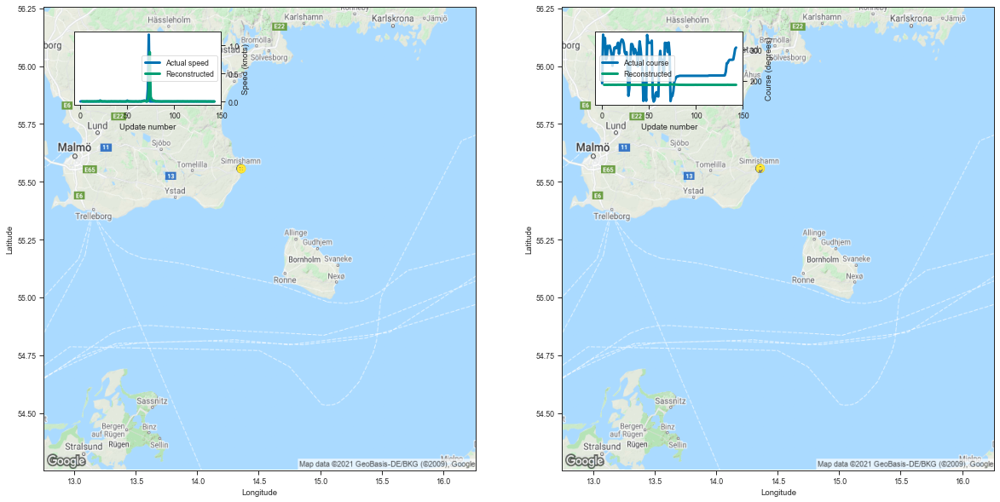

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357123  55.557556  0.002458  186.686264         0.001277   
3    14.358063  55.558399  0.000757  186.626022         0.000958   
4    14.358817  55.557434  0.001389  186.834198         0.001116   
5    14.358746  55.558830  0.000574  186.751205         0.001025   
6    14.358115  55.558479  0.000466  186.576096         0.000836   
..         ...        ...       ...         ...              ...   
139  14.360927  55.557743  0.001344  186.579788         0.000824   
140  14.360555  55.558331 -0.001169  186.457199         0.000724   
141  14.360767  55.558018 -0.000036  186.608627         0.000841   
142  14.360746  55.557358 -0.000203  186.602875         0.000850   
143  14.359890  55.557827  0.000043  186.462814         0.000729   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001270     0.005470     91.366941  
3          0.000907     0.005179     96.737084  
4          0.001012     0.011120    

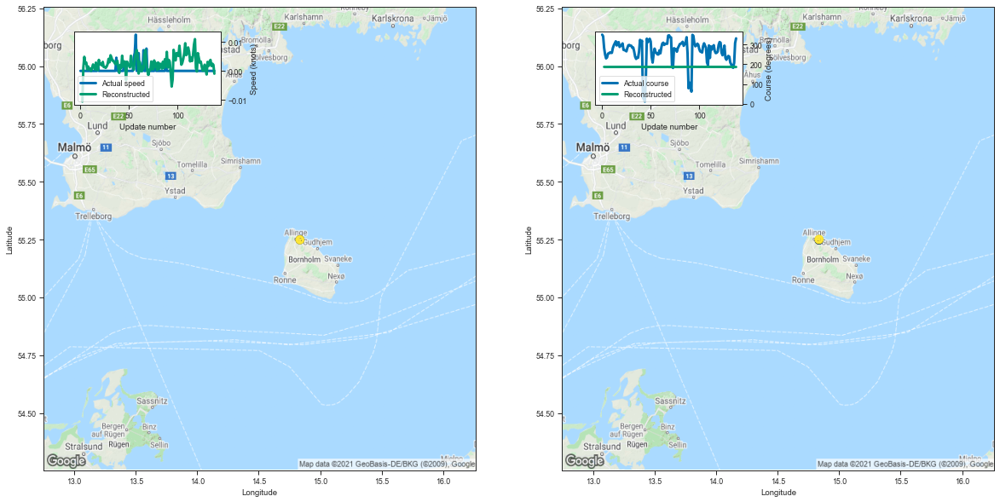

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836810  55.247929 -0.010568  186.814713         0.001825   
3    14.836974  55.251125  0.001198  186.414337         0.000963   
4    14.836663  55.250835  0.004848  186.516632         0.000980   
5    14.836579  55.250568  0.002547  186.430786         0.000881   
6    14.836922  55.249584  0.002880  186.571304         0.001010   
..         ...        ...       ...         ...              ...   
134  14.837160  55.250992  0.003787  186.661484         0.001126   
135  14.837644  55.251152  0.001682  186.490311         0.000939   
136  14.837156  55.251381  0.002482  186.739014         0.001186   
137  14.836378  55.251419  0.002080  186.414749         0.000874   
138  14.836692  55.250641 -0.000957  186.332779         0.000773   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001738     0.015876     93.871702  
3          0.000914     0.004626     97.889427  
4          0.000898     0.007030    

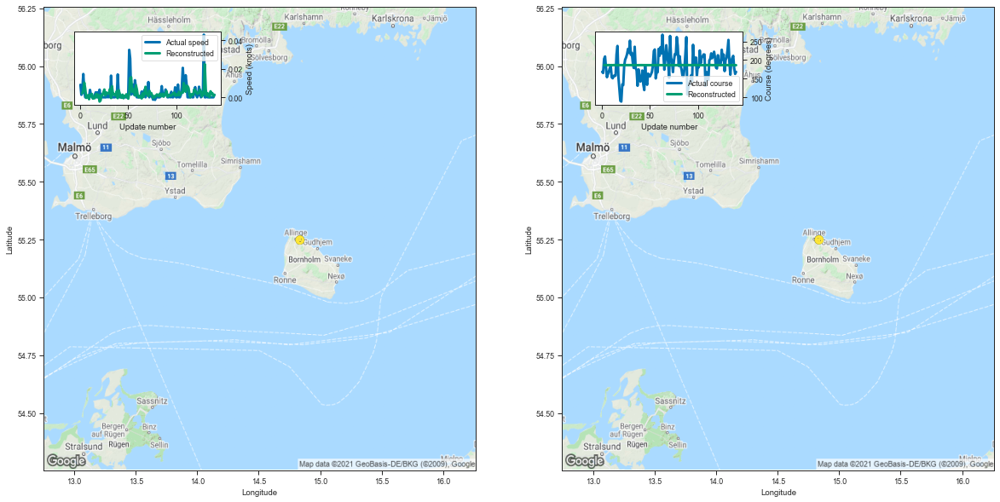

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835964  55.249249  0.002809  186.584579         0.001465   
3    14.837399  55.249584  0.004820  186.721069         0.001318   
4    14.837380  55.249638  0.010324  186.401077         0.000897   
5    14.836850  55.250214  0.006021  186.492691         0.000936   
6    14.836864  55.248520 -0.000456  186.388016         0.000829   
..         ...        ...       ...         ...              ...   
136  14.837640  55.249233  0.004182  186.749680         0.001193   
137  14.836631  55.249939  0.002604  186.450592         0.000904   
138  14.836885  55.249706  0.002754  186.678375         0.001115   
139  14.836646  55.249950  0.000859  186.339340         0.000796   
140  14.837007  55.248943  0.001747  186.356934         0.000787   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001428     0.006806     92.622854  
3          0.001195     0.013671     99.483687  
4          0.000838     0.004666    

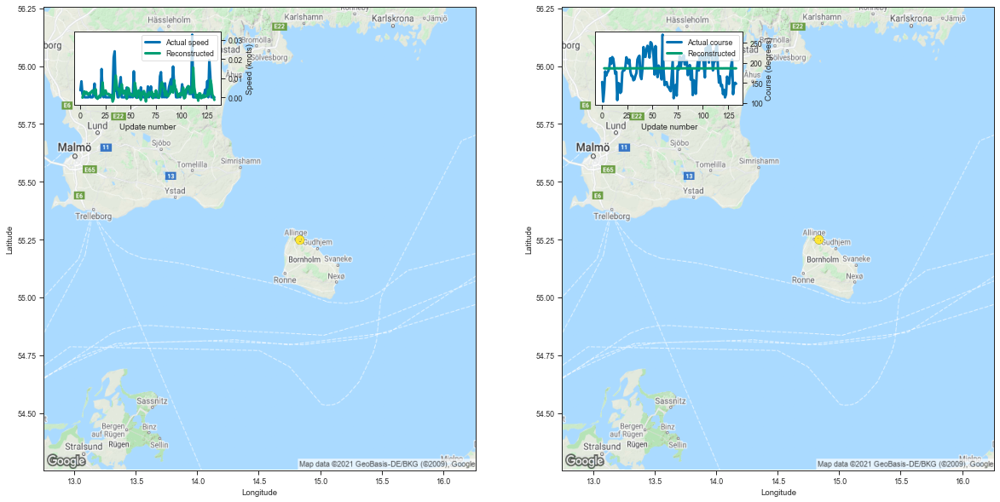

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836973  55.249535 -0.000196  186.545242         0.001397   
3    14.836759  55.249966  0.002115  186.465332         0.000998   
4    14.837466  55.249176  0.003080  186.381546         0.000852   
5    14.837167  55.248909  0.001700  186.469788         0.000905   
6    14.837735  55.248596  0.002744  186.337006         0.000785   
..         ...        ...       ...         ...              ...   
129  14.837110  55.250515  0.009080  186.347153         0.000793   
130  14.837142  55.249580  0.006825  186.383804         0.000812   
131  14.836847  55.249928  0.001470  186.485458         0.000897   
132  14.836735  55.248909  0.000380  186.363495         0.000797   
133  14.836292  55.249557 -0.001388  186.456146         0.000871   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001367     0.005975     92.633598  
3          0.000933     0.005431     98.607145  
4          0.000792     0.004247    

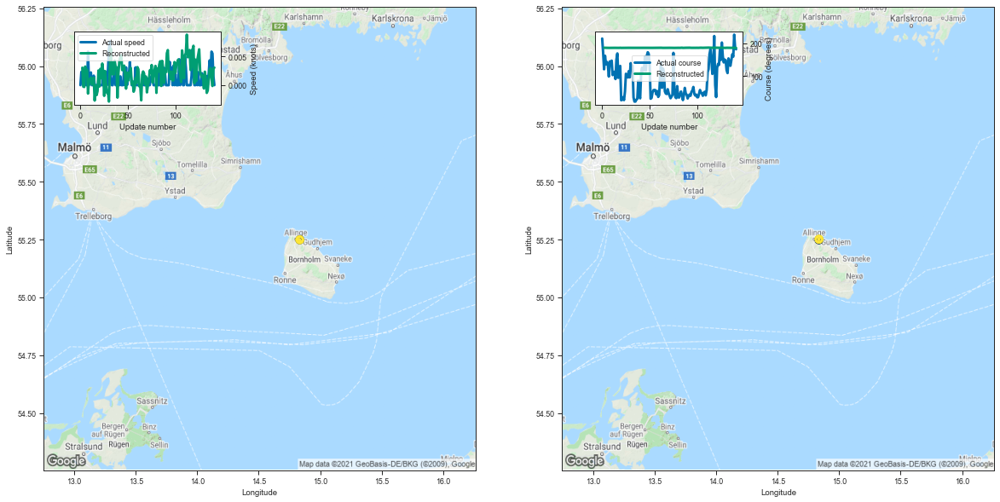

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836182  55.249081  0.003063  186.703445         0.001695   
3    14.835588  55.251865 -0.000258  186.574417         0.001129   
4    14.835235  55.250580 -0.000319  186.364822         0.000844   
5    14.835327  55.250710  0.003261  186.483627         0.000915   
6    14.835551  55.249882  0.002717  186.363525         0.000807   
..         ...        ...       ...         ...              ...   
137  14.834803  55.251095  0.002985  186.614929         0.001036   
138  14.835809  55.249794  0.001210  186.447876         0.000882   
139  14.835043  55.250797 -0.000147  186.325470         0.000766   
140  14.835186  55.250389  0.002928  186.414902         0.000833   
141  14.836287  55.251274  0.003081  186.335983         0.000773   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001640     0.010508     92.496432  
3          0.001048     0.007956     98.648771  
4          0.000790     0.004001    

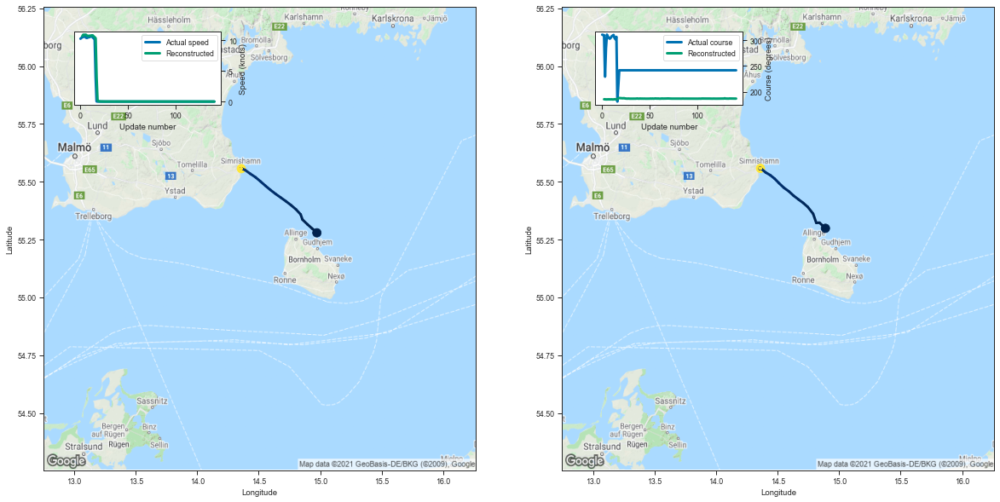

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.888749  55.298630  10.688025  185.275406         0.029383   
3    14.840179  55.322941  10.919149  185.218918         0.023094   
4    14.814356  55.322037  10.886101  184.956970         0.016795   
5    14.788525  55.361622  10.926327  185.053482         0.017594   
6    14.745290  55.390888  10.899031  185.080719         0.017206   
..         ...        ...        ...         ...              ...   
137  14.360235  55.557877   0.000783  186.522705         0.000774   
138  14.360780  55.557461   0.000345  186.561996         0.000805   
139  14.359773  55.558670   0.000779  186.424850         0.000699   
140  14.360165  55.558197   0.000384  186.542389         0.000785   
141  14.360425  55.557915  -0.000130  186.555130         0.000798   

     Latitude sigma  Speed sigma  Course sigma  
2          0.017453     1.495329     92.589858  
3          0.013749     1.539339     97.166869  
4          0.010344     

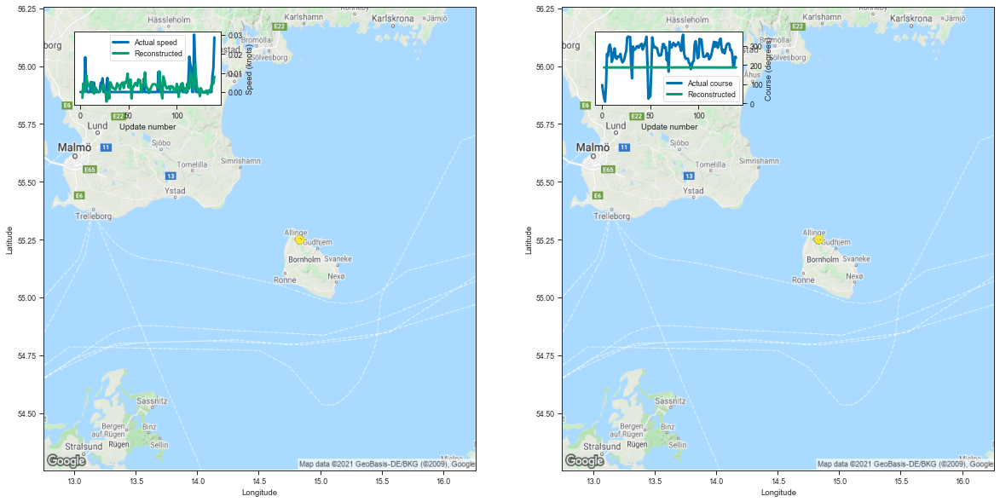

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.834326  55.249737 -0.003004  186.526657         0.001328   
3    14.834257  55.251488  0.004494  186.498550         0.001004   
4    14.835114  55.250526  0.003170  186.700714         0.001153   
5    14.835947  55.250538  0.000210  186.606903         0.001063   
6    14.836142  55.251472  0.008745  186.575394         0.001026   
..         ...        ...       ...         ...              ...   
135  14.836168  55.250256  0.000970  186.359177         0.000798   
136  14.835917  55.250938  0.003890  186.643127         0.001065   
137  14.835723  55.250862  0.003916  186.466827         0.000909   
138  14.835925  55.250820  0.004492  186.490677         0.000924   
139  14.835116  55.250416  0.008050  186.480286         0.000914   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001293     0.005811     93.416422  
3          0.000927     0.006563     99.725595  
4          0.001025     0.014381    

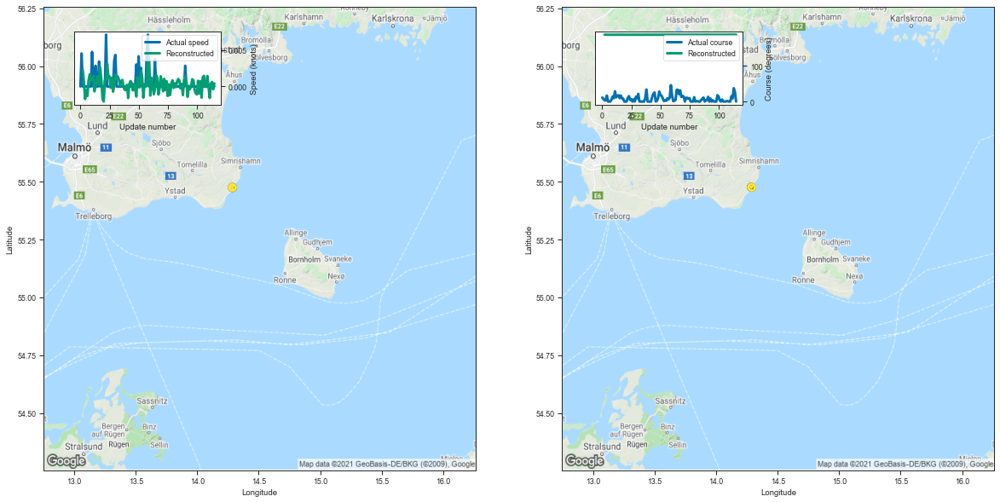

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287018  55.476242  0.002298  186.673706         0.001166   
3    14.286989  55.476868  0.000657  186.526306         0.000803   
4    14.287230  55.476822 -0.001722  186.486053         0.000723   
5    14.287480  55.476799 -0.000439  186.524475         0.000738   
6    14.287390  55.476707 -0.001309  186.469376         0.000692   
..         ...        ...       ...         ...              ...   
111  14.287498  55.476383 -0.001574  186.510864         0.000724   
112  14.287470  55.476398  0.000413  186.558884         0.000758   
113  14.287465  55.476589  0.000633  186.626740         0.000810   
114  14.287897  55.476788 -0.000375  186.552567         0.000761   
115  14.288369  55.476063  0.000432  186.720016         0.000901   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001135     0.004791     93.098135  
3          0.000755     0.003285     97.919007  
4          0.000673     0.002959    

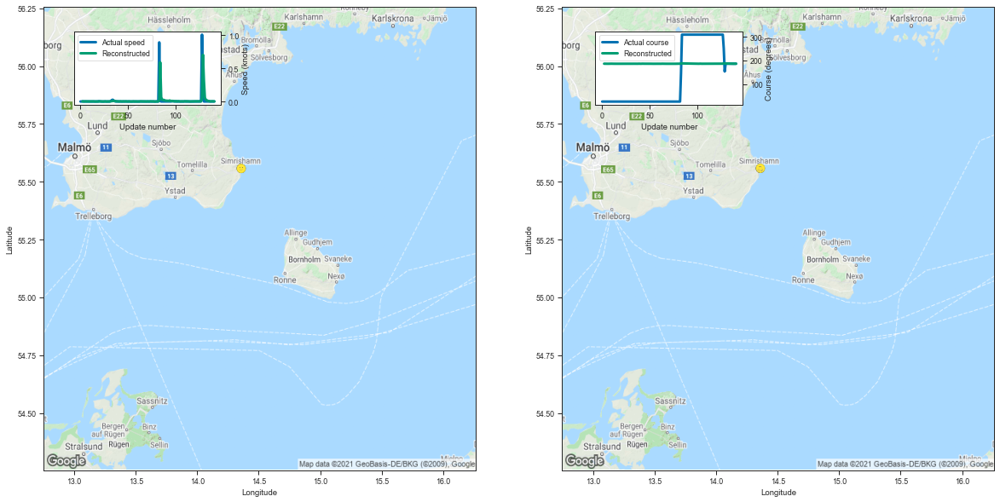

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359385  55.557793  0.000729  186.692383         0.001252   
3    14.359451  55.558353  0.002206  186.573441         0.000890   
4    14.359222  55.559097  0.000538  186.518723         0.000789   
5    14.359154  55.558907  0.001860  186.613144         0.000850   
6    14.359033  55.558300  0.000880  186.427414         0.000698   
..         ...        ...       ...         ...              ...   
137  14.359815  55.558632  0.001529  186.619003         0.000890   
138  14.360251  55.558342  0.002936  186.611801         0.000865   
139  14.360615  55.558109  0.003393  186.726532         0.000957   
140  14.360415  55.558048  0.001930  186.655533         0.000905   
141  14.360205  55.558277  0.002387  186.651611         0.000898   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001229     0.005821     92.295260  
3          0.000842     0.004407     97.115151  
4          0.000742     0.003772    

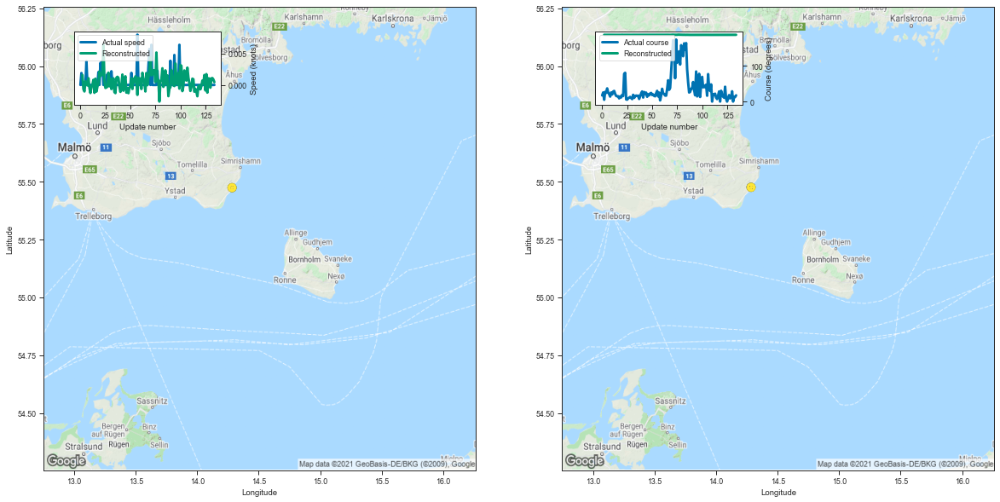

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.283895  55.476032  0.001585  186.652283         0.001140   
3    14.285295  55.475624 -0.000655  186.561218         0.000830   
4    14.285098  55.476059 -0.001027  186.504761         0.000742   
5    14.285186  55.475597  0.000588  186.681778         0.000875   
6    14.286014  55.475079  0.000096  186.600922         0.000809   
..         ...        ...       ...         ...              ...   
130  14.285758  55.475391 -0.000431  186.479752         0.000692   
131  14.285664  55.475418  0.001047  186.592072         0.000781   
132  14.285760  55.475121  0.001095  186.668427         0.000851   
133  14.285344  55.475117  0.000872  186.556885         0.000760   
134  14.284613  55.475765  0.000444  186.605804         0.000798   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001112     0.004321     92.937095  
3          0.000778     0.003684     98.063750  
4          0.000691     0.003112    

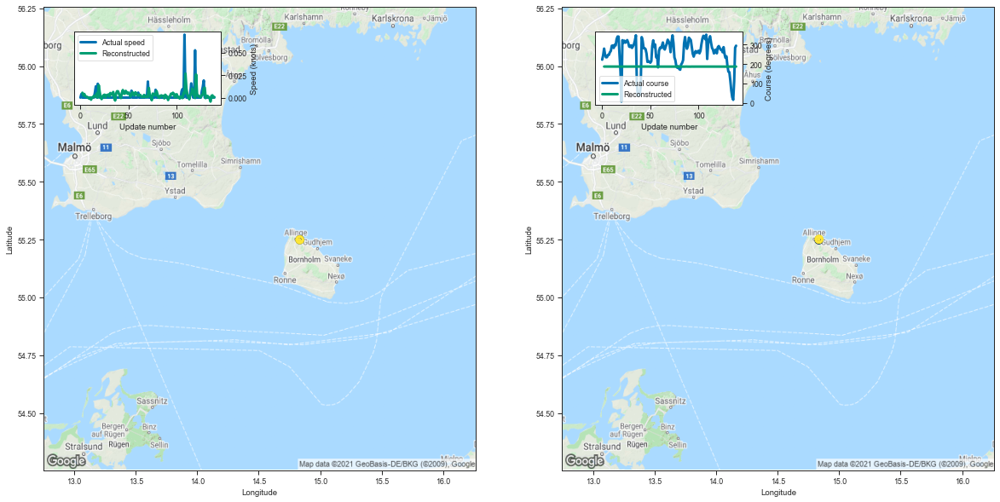

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835503  55.248703  0.005422  186.811142         0.001863   
3    14.835639  55.251747  0.002232  186.784576         0.001421   
4    14.835549  55.250599  0.004066  186.629852         0.001145   
5    14.835505  55.249935  0.001698  186.563721         0.001030   
6    14.835262  55.250408  0.001074  186.542374         0.000987   
..         ...        ...       ...         ...              ...   
135  14.834684  55.251072 -0.004421  186.317520         0.000747   
136  14.834554  55.251148  0.001911  186.526855         0.000919   
137  14.835718  55.250305  0.002506  186.571503         0.000977   
138  14.836458  55.251060  0.000134  186.442749         0.000875   
139  14.836488  55.251190  0.000682  186.681808         0.001112   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001766     0.015669     93.581672  
3          0.001289     0.016956     99.252602  
4          0.001046     0.010665    

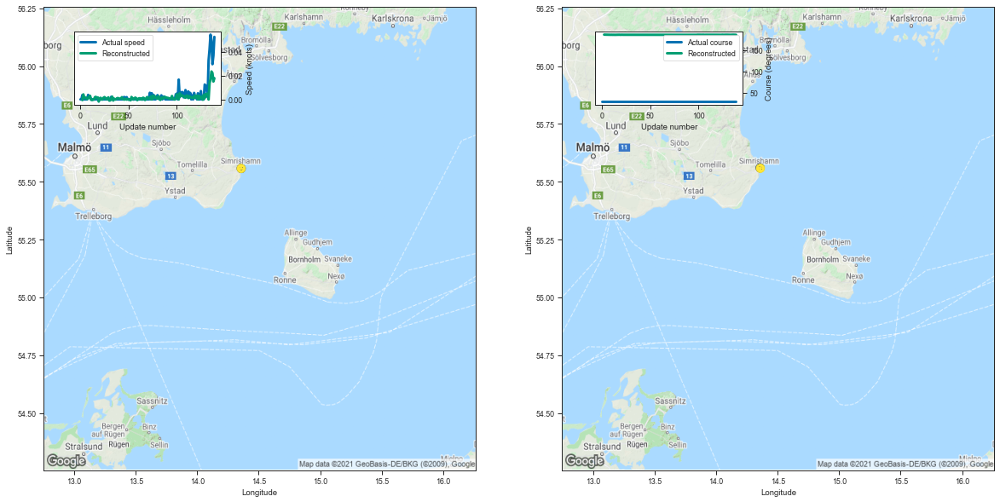

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357829  55.559589 -0.000602  186.863068         0.001521   
3    14.358987  55.559120  0.004198  186.779938         0.001115   
4    14.358905  55.559032  0.001250  186.574158         0.000848   
5    14.358793  55.558975  0.001411  186.578888         0.000828   
6    14.359030  55.558754  0.001451  186.437164         0.000706   
..         ...        ...       ...         ...              ...   
135  14.358612  55.559158  0.017098  186.441330         0.000708   
136  14.359725  55.558102  0.023488  186.692505         0.000922   
137  14.359714  55.558384  0.022200  186.581619         0.000832   
138  14.358996  55.558586  0.015053  186.409363         0.000686   
139  14.359874  55.558205  0.017832  186.450546         0.000709   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001470     0.010577     92.483022  
3          0.001035     0.009160     97.560148  
4          0.000796     0.004612    

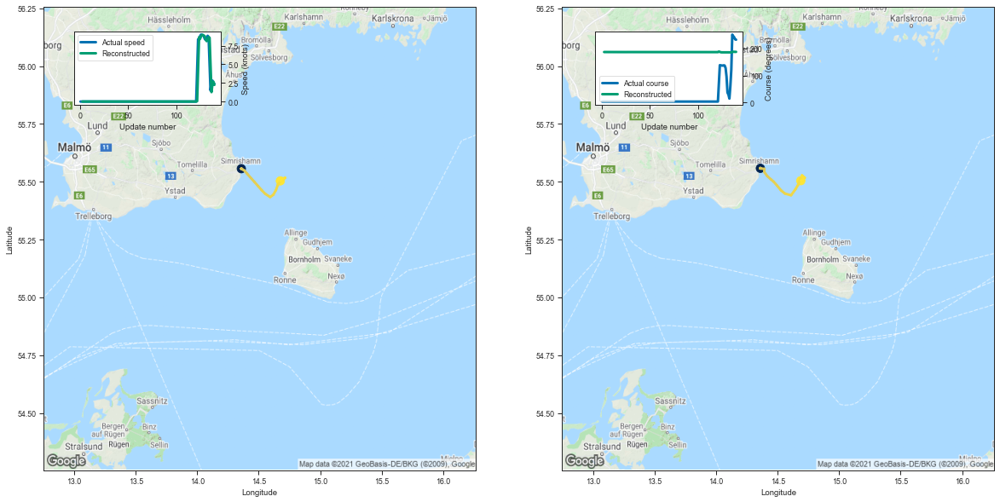

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359728  55.558109  0.000880  186.715515         0.001274   
3    14.360188  55.558346  0.001942  186.698120         0.001016   
4    14.360145  55.558067  0.004024  186.659088         0.000923   
5    14.359709  55.558258  0.002403  186.672211         0.000908   
6    14.359526  55.558655  0.001804  186.517715         0.000772   
..         ...        ...       ...         ...              ...   
136  14.720883  55.517002  4.962181  186.742798         0.012920   
137  14.698355  55.527401  1.266264  187.704773         0.009557   
138  14.710262  55.508953  2.330626  187.363373         0.010814   
139  14.694975  55.505360  2.670610  187.315338         0.011473   
140  14.688471  55.504478  2.239183  187.298401         0.009686   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001246     0.006394     92.536062  
3          0.000949     0.007066     97.606407  
4          0.000852     0.006476    

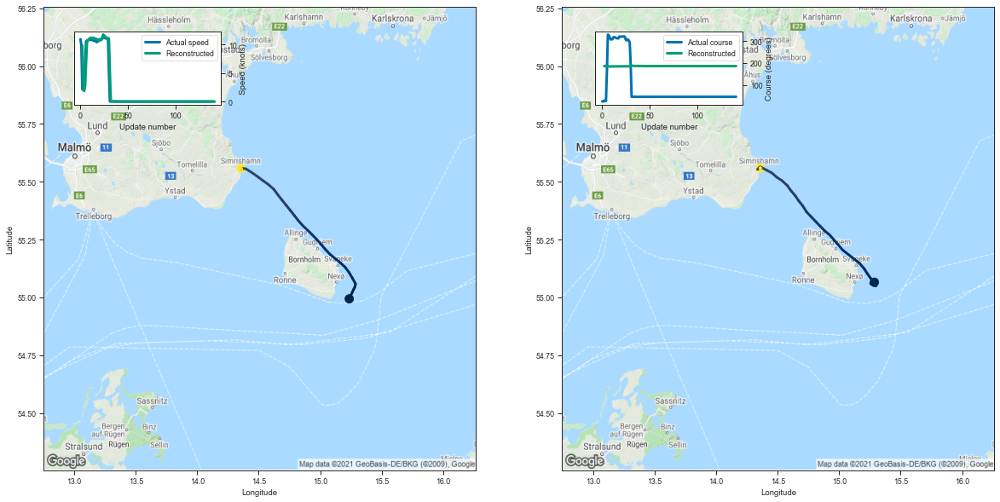

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.286608  55.065502  9.820276  185.901093         0.052726   
3    15.256247  55.059601  2.022747  187.292282         0.011326   
4    15.278539  55.051838  1.846748  187.155563         0.008660   
5    15.291210  55.052643  2.822565  186.990479         0.010670   
6    15.300343  55.050243  7.012578  185.755463         0.015491   
..         ...        ...       ...         ...              ...   
137  14.358979  55.558849 -0.001609  186.426514         0.000683   
138  14.358717  55.559139 -0.000139  186.590271         0.000810   
139  14.358761  55.558704 -0.000884  186.454300         0.000709   
140  14.358613  55.559036 -0.000521  186.438171         0.000692   
141  14.359035  55.558769  0.000634  186.475891         0.000719   

     Latitude sigma  Speed sigma  Course sigma  
2          0.027415     3.543141     97.423713  
3          0.007434     1.547747     99.762770  
4          0.005820     1.099977    

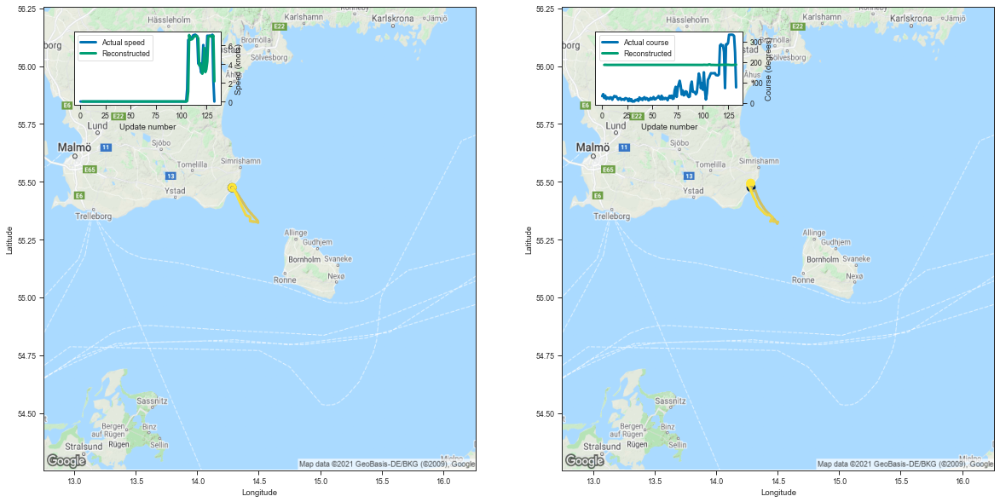

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.284348  55.475464  0.001153  186.762863         0.001301   
3    14.284167  55.475979  0.000691  186.970413         0.001282   
4    14.284963  55.475937 -0.003267  186.595490         0.000838   
5    14.284550  55.475208 -0.001770  186.489258         0.000718   
6    14.284682  55.476181 -0.000198  186.521240         0.000733   
..         ...        ...       ...         ...              ...   
129  14.302337  55.436016  7.010122  185.884003         0.007974   
130  14.292006  55.449886  6.914278  186.158661         0.009945   
131  14.274103  55.471939  6.864964  186.263245         0.010856   
132  14.255283  55.486683  7.027225  187.045425         0.024750   
133  14.280954  55.493313  2.146371  187.744385         0.010591   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001259     0.006374     92.870331  
3          0.001146     0.015425     99.383588  
4          0.000780     0.004344    

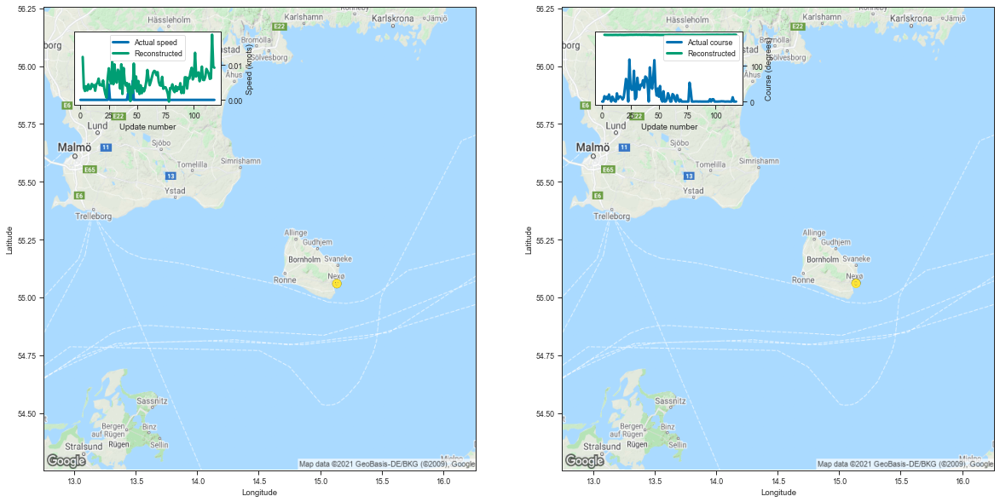

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137667  55.061619  0.012250  186.668015         0.001739   
3    15.136622  55.061039  0.003458  186.479462         0.001126   
4    15.136125  55.061714  0.002543  186.375885         0.000938   
5    15.136545  55.060669  0.003890  186.289780         0.000835   
6    15.136539  55.061508  0.002681  186.326279         0.000852   
..         ...        ...       ...         ...              ...   
114  15.136801  55.060310  0.006006  186.770935         0.001457   
115  15.135962  55.060810  0.006152  186.826920         0.001519   
116  15.136795  55.061115  0.018616  187.162048         0.002153   
117  15.137925  55.060055  0.009499  186.976257         0.001850   
118  15.137335  55.060379  0.009178  186.879120         0.001652   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001618     0.017120     96.428198  
3          0.001028     0.010435    101.305482  
4          0.000859     0.007614    

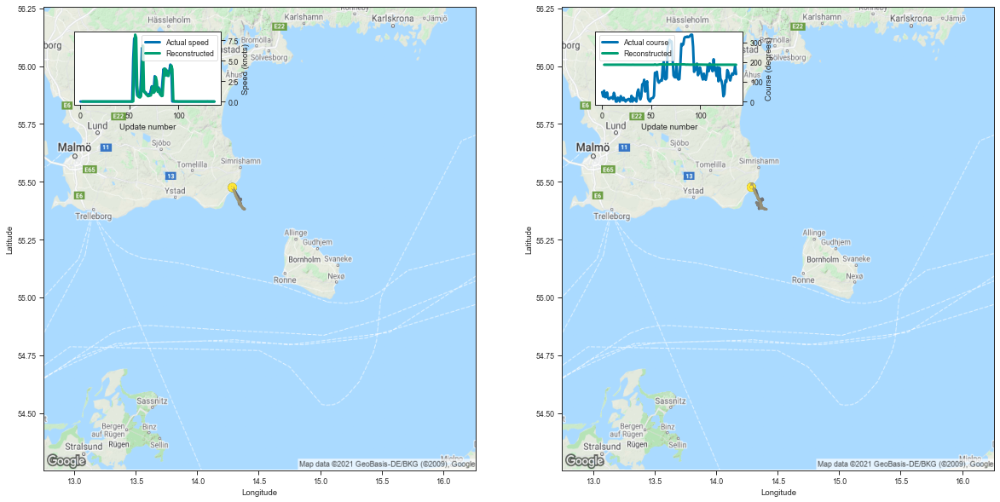

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286878  55.476646  0.002652  186.646912         0.001132   
3    14.287736  55.476540  0.000596  186.528275         0.000810   
4    14.287249  55.476673 -0.000674  186.544205         0.000771   
5    14.287919  55.476208  0.000242  186.554901         0.000766   
6    14.288246  55.475742 -0.000309  186.551300         0.000760   
..         ...        ...       ...         ...              ...   
133  14.287182  55.477264  0.001313  186.658966         0.000861   
134  14.287947  55.477058 -0.000174  186.645981         0.000849   
135  14.287686  55.476349  0.001912  186.833511         0.001029   
136  14.288281  55.476685  0.000106  186.659653         0.000873   
137  14.286584  55.476200 -0.001145  186.682007         0.000883   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001103     0.004248     93.002363  
3          0.000762     0.003195     97.660965  
4          0.000714     0.003597    

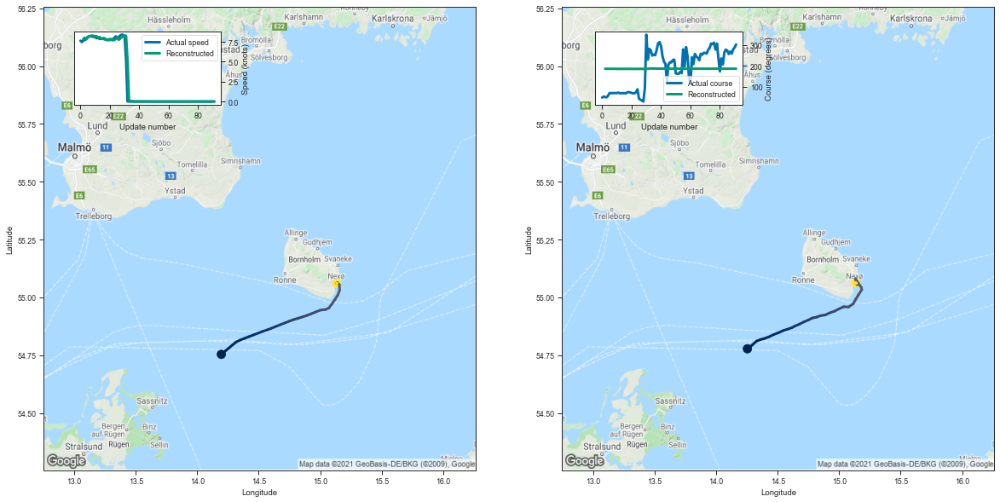

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.254293  54.777557  7.907531  186.263306         0.018453   
3   14.294631  54.794361  8.007734  185.796051         0.010213   
4   14.328928  54.811047  7.849763  186.086365         0.012464   
5   14.362719  54.817680  8.053257  185.657440         0.009047   
6   14.391502  54.821770  8.226395  185.748398         0.010488   
..        ...        ...       ...         ...              ...   
87  15.137672  55.061008 -0.001684  186.315308         0.000856   
88  15.137727  55.061043 -0.000711  186.312866         0.000858   
89  15.136823  55.061527 -0.000393  186.282425         0.000832   
90  15.137580  55.061295 -0.002892  186.268066         0.000815   
91  15.136693  55.061707 -0.003208  186.264175         0.000810   

    Latitude sigma  Speed sigma  Course sigma  
2         0.010830     1.066681     96.701750  
3         0.006252     0.453767     99.401520  
4         0.007308     0.944322    102.018692  
5  

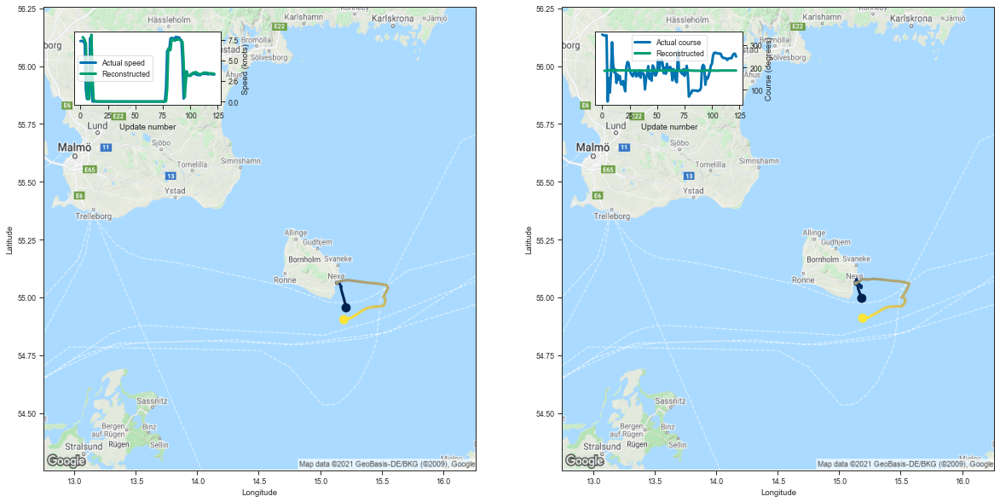

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.184131  54.996037  7.807729  185.710068         0.021611   
3    15.165789  55.020840  7.679724  185.353149         0.011447   
4    15.154819  55.038403  7.411534  185.465576         0.010576   
5    15.148600  55.057217  7.032995  186.240372         0.019875   
6    15.181950  55.049313  1.012214  187.527771         0.007970   
..         ...        ...       ...         ...              ...   
118  15.249956  54.916492  3.393035  186.821106         0.010206   
119  15.234779  54.913120  3.437318  186.638641         0.009044   
120  15.221793  54.909817  3.395530  186.524307         0.007651   
121  15.207732  54.910137  3.374943  186.511642         0.007199   
122  15.191618  54.909901  3.349627  186.354736         0.006015   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013082     1.209793     93.142500  
3          0.007254     0.544615     96.449843  
4          0.006662     0.629099    

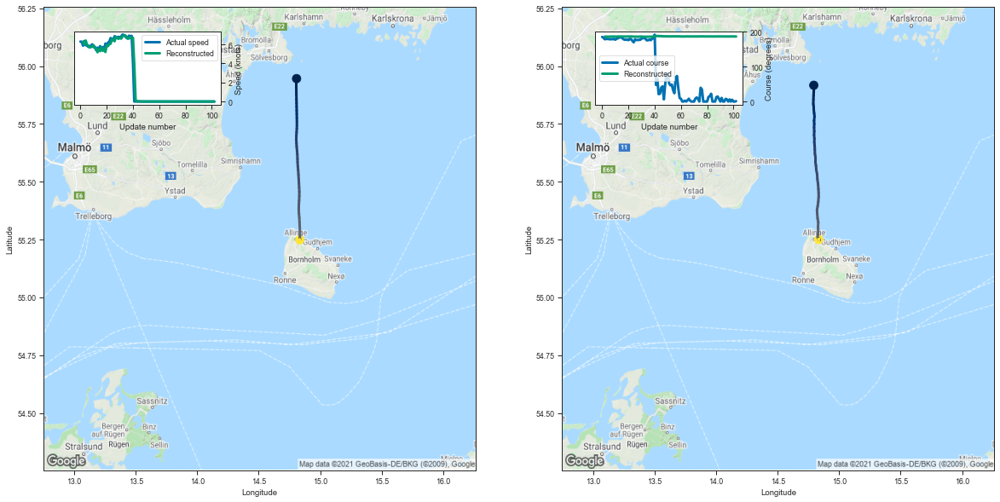

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.793996  55.917183  6.294501  185.906097         0.013744   
3    14.794438  55.893829  6.012446  185.817596         0.008771   
4    14.791997  55.871964  6.408494  185.712738         0.008393   
5    14.791178  55.856377  5.970663  185.604767         0.006309   
6    14.789989  55.835869  5.879129  186.000107         0.008877   
..         ...        ...       ...         ...              ...   
98   14.835482  55.250427 -0.001189  186.360428         0.000765   
99   14.834516  55.251484 -0.003068  186.472610         0.000865   
100  14.834658  55.251175 -0.002461  186.325150         0.000746   
101  14.834855  55.251389 -0.001863  186.342087         0.000747   
102  14.835109  55.250252 -0.002211  186.295044         0.000712   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010018     0.404932     84.336096  
3          0.006355     0.282266     89.563522  
4          0.005988     0.293036    

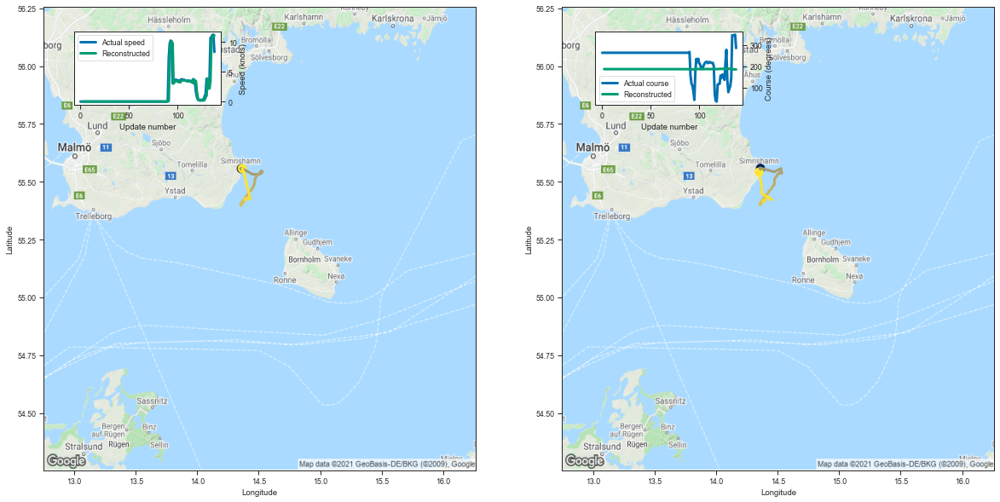

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.360286  55.557865   0.002307  186.889221         0.001574   
3    14.360325  55.558270   0.002543  186.569351         0.000918   
4    14.361099  55.557632   0.001796  186.787033         0.001056   
5    14.360598  55.558270   0.000208  186.713226         0.000977   
6    14.360162  55.558350  -0.001549  186.636490         0.000897   
..         ...        ...        ...         ...              ...   
134  14.453244  55.421310   3.556835  187.261963         0.013395   
135  14.369696  55.449001  10.361017  185.612839         0.020908   
136  14.370786  55.483955  10.686594  185.612549         0.021659   
137  14.358644  55.510067  11.044619  185.001480         0.013032   
138  14.349402  55.541718  11.092476  185.218857         0.015538   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001519     0.010799     92.299635  
3          0.000879     0.004176     96.100564  
4          0.000965     

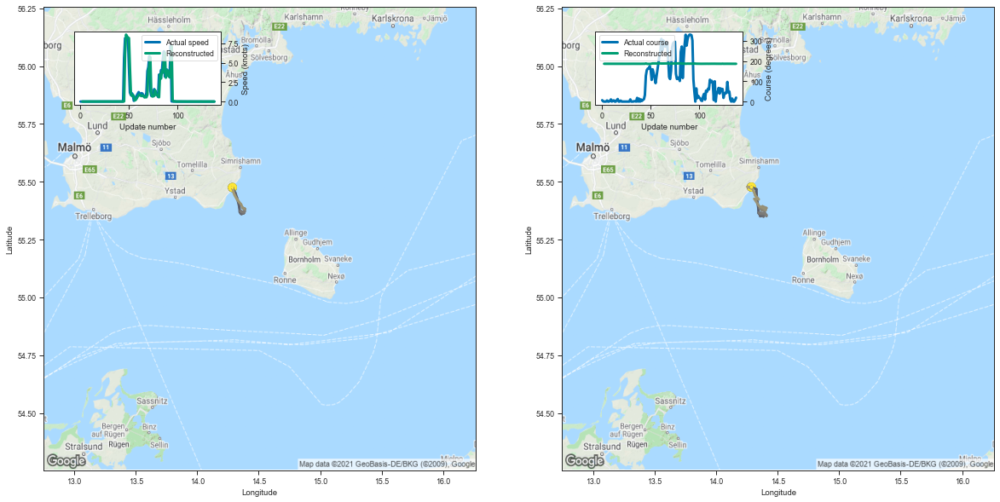

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.285808  55.477081  0.003006  186.642044         0.001119   
3    14.287017  55.477142 -0.001416  186.523468         0.000796   
4    14.287192  55.476635 -0.000655  186.498886         0.000732   
5    14.287130  55.476955 -0.001412  186.472946         0.000699   
6    14.286680  55.477573  0.000321  186.590302         0.000784   
..         ...        ...       ...         ...              ...   
134  14.287752  55.477360 -0.000470  186.462982         0.000680   
135  14.288307  55.476543  0.000278  186.463531         0.000681   
136  14.287534  55.477325 -0.001753  186.462433         0.000677   
137  14.288302  55.476543  0.000075  186.460800         0.000678   
138  14.287317  55.477245  0.000512  186.462387         0.000680   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001092     0.004282     93.176443  
3          0.000749     0.003241     97.993034  
4          0.000681     0.003110    

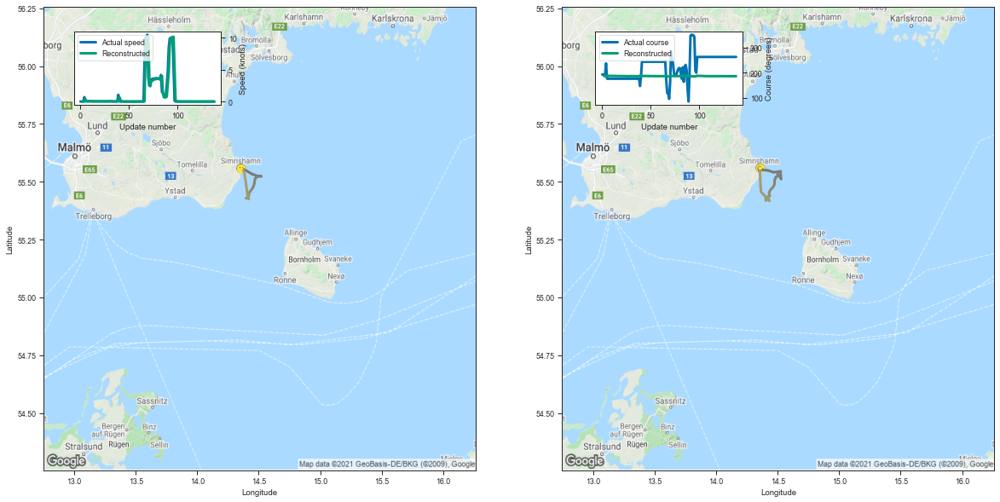

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359464  55.558891  0.002600  186.649673         0.001240   
3    14.358749  55.559628  0.000369  186.478348         0.000819   
4    14.360317  55.559444  0.015308  187.775665         0.002902   
5    14.351358  55.553955  0.429694  187.644089         0.003940   
6    14.362185  55.555168  0.067828  187.562973         0.002795   
..         ...        ...       ...         ...              ...   
134  14.360317  55.558613  0.001070  186.450012         0.000718   
135  14.360831  55.557709 -0.000294  186.507248         0.000753   
136  14.360719  55.557858 -0.000729  186.457474         0.000719   
137  14.360276  55.558475 -0.000020  186.446442         0.000706   
138  14.360534  55.557922 -0.000825  186.433365         0.000697   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001236     0.004647     91.023606  
3          0.000789     0.002928     96.078901  
4          0.002310     0.255791    

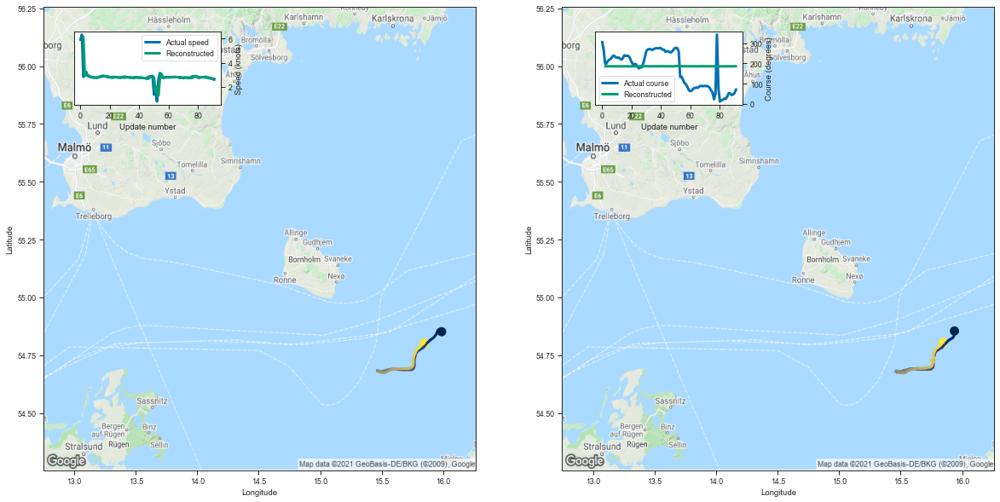

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.937818  54.854668  6.141812  185.958603         0.027506   
3   15.945098  54.857765  2.912990  186.201370         0.009001   
4   15.943320  54.845085  3.245463  186.102020         0.008438   
5   15.938023  54.837479  2.916562  185.926392         0.005842   
6   15.929832  54.829693  2.913730  185.872223         0.005220   
..        ...        ...       ...         ...              ...   
87  15.806227  54.784901  2.730688  185.701385         0.003174   
88  15.816336  54.789536  2.698229  185.890350         0.003799   
89  15.826557  54.794765  2.728359  185.601913         0.002903   
90  15.835526  54.800850  2.639396  185.950638         0.003965   
91  15.846827  54.805351  2.586322  186.183075         0.005285   

    Latitude sigma  Speed sigma  Course sigma  
2         0.015768     1.869814     93.878058  
3         0.005892     0.590084     97.161713  
4         0.005419     0.629367     99.233803  
5  

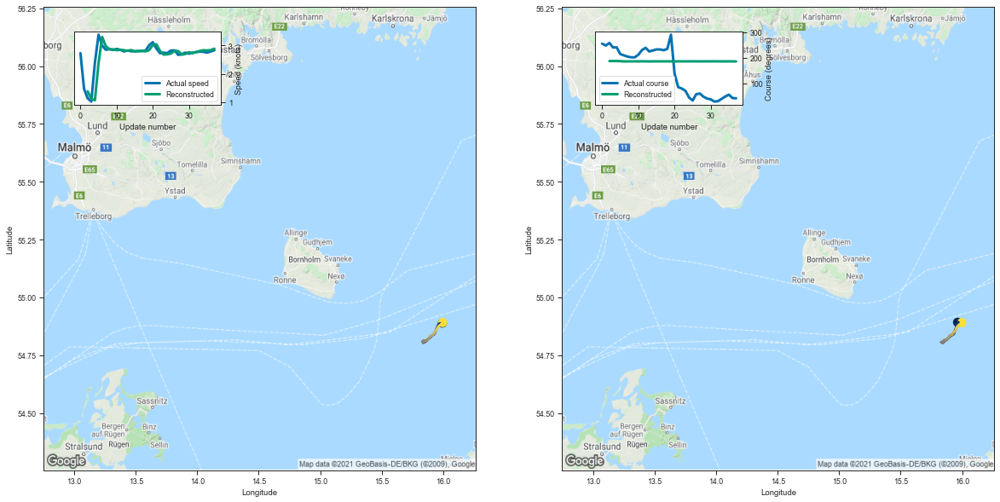

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.963095  54.892117  1.383991  186.882309         0.012494   
3   15.969321  54.891937  1.115124  187.073959         0.010743   
4   15.962789  54.891972  1.070133  187.097443         0.010357   
5   15.962809  54.889275  2.372274  186.525574         0.009730   
6   15.949984  54.883778  3.299669  185.623047         0.005325   
7   15.951998  54.869770  2.976034  185.729584         0.004562   
8   15.946125  54.862022  2.869627  185.640533         0.003861   
9   15.940729  54.853855  2.860453  185.831955         0.004577   
10  15.936168  54.845619  2.833071  185.777924         0.004335   
11  15.927854  54.839981  2.844819  185.957932         0.005226   
12  15.916404  54.836624  2.832185  185.796860         0.004451   
13  15.904114  54.832485  2.808944  185.569183         0.003317   
14  15.894587  54.826923  2.838005  185.673447         0.003572   
15  15.885012  54.821896  2.783909  185.846176         0.00422

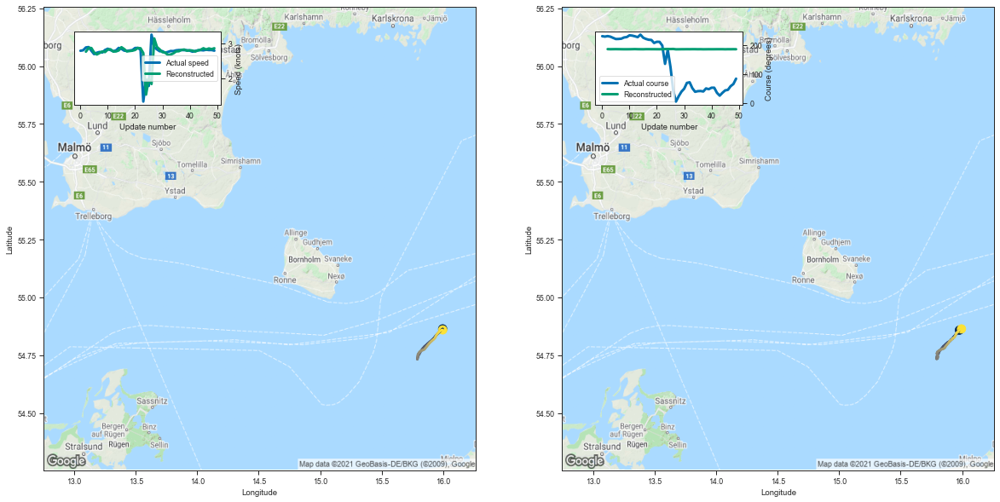

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.977663  54.858196  2.759423  186.078293         0.008924   
3   15.967752  54.850807  2.867594  185.735626         0.005059   
4   15.958283  54.843910  2.862713  185.886124         0.005262   
5   15.946671  54.838627  2.738977  186.010025         0.005657   
6   15.936132  54.831230  2.679970  185.877396         0.004720   
7   15.928497  54.827557  2.722537  185.724594         0.003933   
8   15.920478  54.820835  2.766839  185.624588         0.003454   
9   15.911414  54.817749  2.749418  185.630402         0.003369   
10  15.903418  54.812069  2.818230  185.684235         0.003631   
11  15.888619  54.806767  2.827128  185.884018         0.004470   
12  15.880888  54.804302  2.762612  186.105774         0.005664   
13  15.867908  54.798363  2.766880  185.798065         0.004170   
14  15.860142  54.793747  2.795034  185.685242         0.003527   
15  15.848780  54.789082  2.887281  185.581146         0.00318

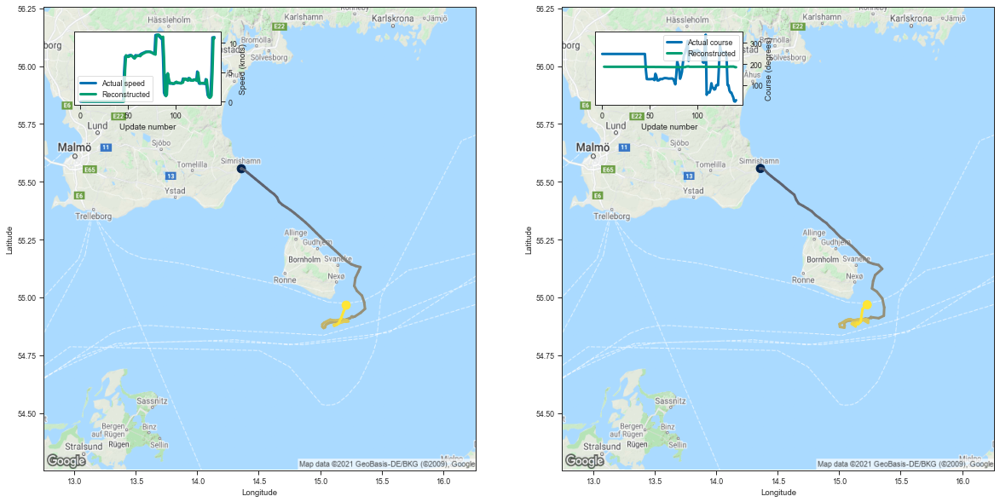

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.360393  55.557426  -0.000619  186.778824         0.001419   
3    14.359846  55.558105  -0.001829  186.540192         0.000883   
4    14.360522  55.557396  -0.001837  186.599045         0.000864   
5    14.360752  55.557209   0.002207  186.459229         0.000739   
6    14.359858  55.557636  -0.000216  186.420517         0.000697   
..         ...        ...        ...         ...              ...   
137  15.149488  54.886585   0.717223  187.378021         0.005530   
138  15.155271  54.884384   1.018499  187.918701         0.010929   
139  15.173978  54.893131   4.958321  186.583038         0.014851   
140  15.191362  54.951015  10.887243  184.633835         0.015559   
141  15.228137  54.967911  10.751556  184.499100         0.012511   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001393     0.007403     91.584063  
3          0.000847     0.003708     96.095650  
4          0.000806     

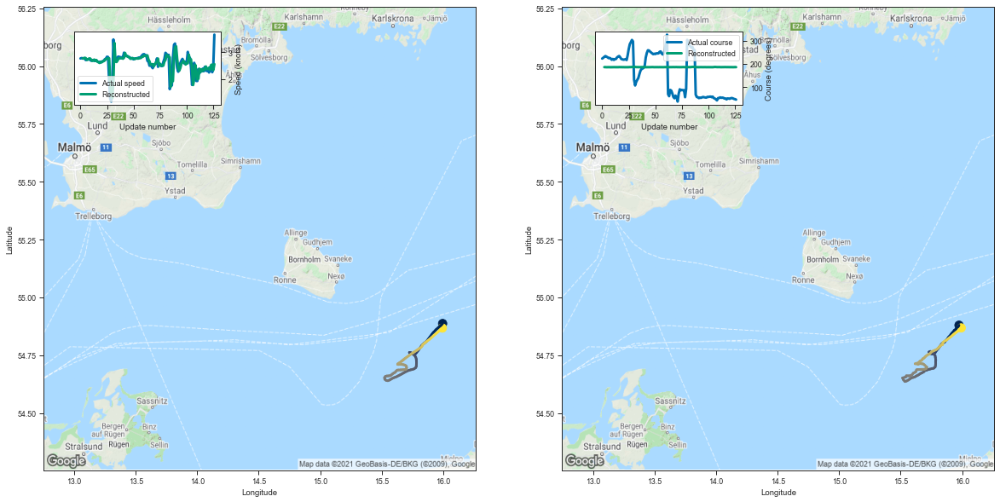

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.974669  54.879543  2.761013  186.007263         0.008082   
3    15.968201  54.873505  2.771676  186.039383         0.006715   
4    15.956289  54.868946  2.790546  185.648178         0.004194   
5    15.948432  54.862213  2.778875  185.735275         0.004162   
6    15.936089  54.857342  2.714149  185.830887         0.004398   
..         ...        ...       ...         ...              ...   
122  15.956883  54.850960  2.342784  185.950226         0.004166   
123  15.967801  54.855034  2.527894  185.784576         0.003816   
124  15.976224  54.858315  2.536908  185.870071         0.004147   
125  15.985073  54.863338  2.333805  186.219894         0.005720   
126  15.992420  54.867790  2.555429  185.885284         0.004627   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005674     0.263813     92.270132  
3          0.004565     0.342725     97.603921  
4          0.002975     0.100143    

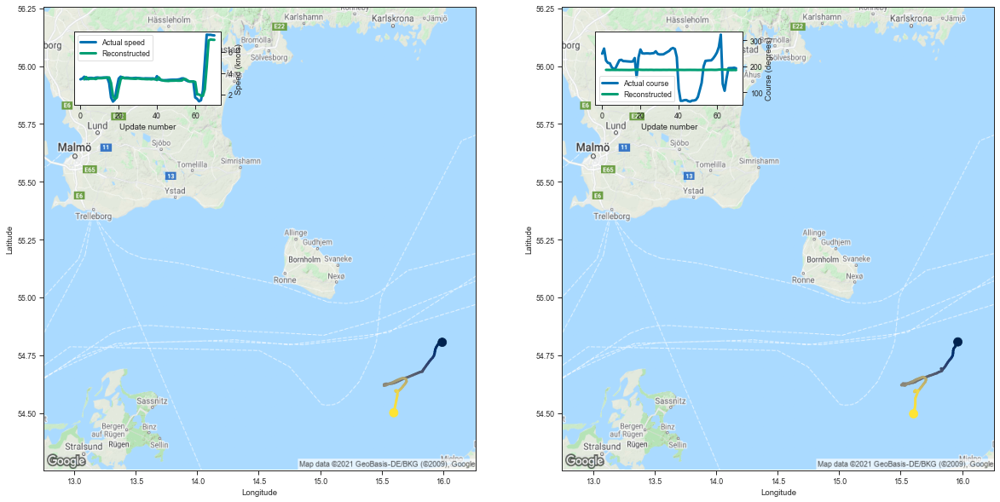

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.965349  54.807343  3.422242  185.884918         0.009226   
3   15.951741  54.797779  3.638650  185.748917         0.006807   
4   15.944031  54.787399  3.432953  185.555771         0.004733   
5   15.931469  54.778454  3.485830  185.844635         0.006182   
6   15.927365  54.769596  3.483408  185.726700         0.005581   
..        ...        ...       ...         ...              ...   
66  15.643327  54.595455  4.595345  186.116028         0.009633   
67  15.619402  54.563122  7.053488  185.186447         0.009643   
68  15.619398  54.535580  7.154355  185.152023         0.009126   
69  15.613894  54.516476  7.127691  185.432861         0.011786   
70  15.605673  54.496300  7.117407  185.062332         0.008266   

    Latitude sigma  Speed sigma  Course sigma  
2         0.006261     0.332775     93.089837  
3         0.004547     0.297522     97.899467  
4         0.003262     0.140643     98.596444  
5  

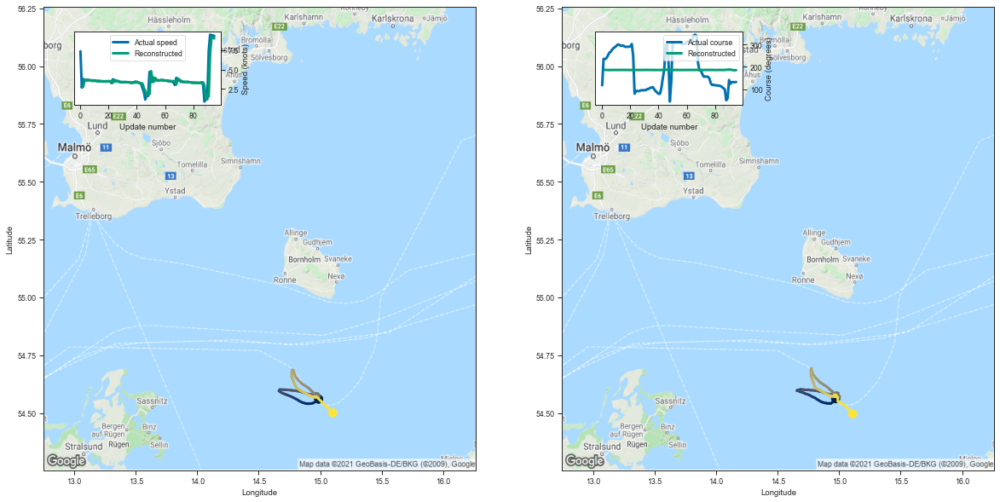

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.971347  54.561966  2.780894  186.711121         0.007621   
3   14.965337  54.548885  3.717293  186.383987         0.006204   
4   14.948508  54.547127  3.578792  186.124237         0.004209   
5   14.932580  54.541313  3.609437  186.026352         0.003651   
6   14.917203  54.541214  3.657123  185.981888         0.003447   
..        ...        ...       ...         ...              ...   
91  14.987979  54.566864  1.538929  188.462479         0.021717   
92  14.990257  54.550262  7.121210  186.234451         0.019664   
93  15.049651  54.531483  9.185276  185.411606         0.017155   
94  15.081841  54.514389  9.129515  185.054916         0.011761   
95  15.109310  54.496361  9.013966  185.478088         0.016932   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005286     0.334582     96.391115  
3         0.004163     0.321390    100.935251  
4         0.002943     0.130311    101.298975  
5  

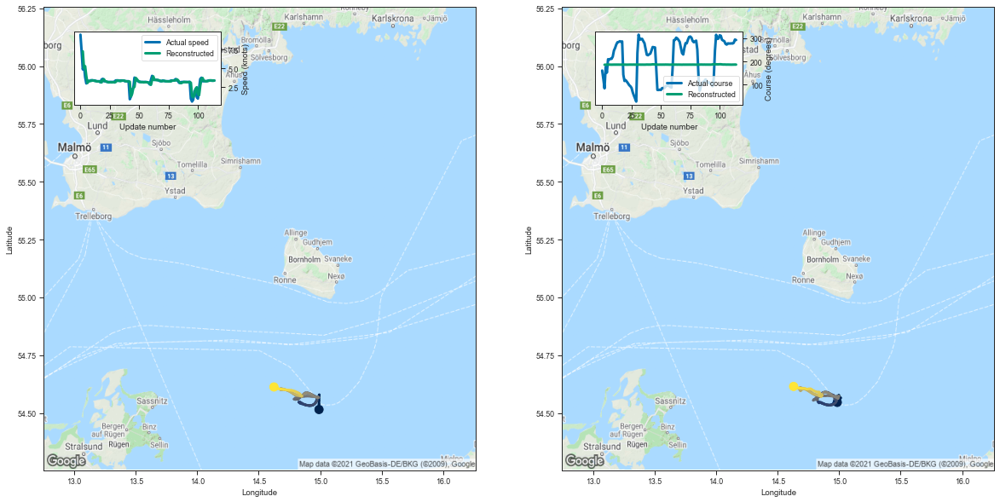

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.984796  54.545868  7.291821  185.850464         0.016808   
3    15.012553  54.565094  5.063537  185.944138         0.006797   
4    15.002851  54.570442  5.302358  186.398895         0.010866   
5    14.997726  54.576736  3.973125  186.291458         0.006052   
6    14.980579  54.571037  3.066826  186.331497         0.004285   
..         ...        ...       ...         ...              ...   
110  14.689146  54.606647  3.409101  186.128525         0.003252   
111  14.672088  54.608154  3.404860  186.360168         0.003973   
112  14.658989  54.608620  3.407603  186.380051         0.004092   
113  14.645565  54.610046  3.356230  186.594772         0.004971   
114  14.629974  54.614769  3.394325  186.389435         0.004127   

     Latitude sigma  Speed sigma  Course sigma  
2          0.009955     0.908892     96.788414  
3          0.004462     0.299128    100.087008  
4          0.006521     1.125853    

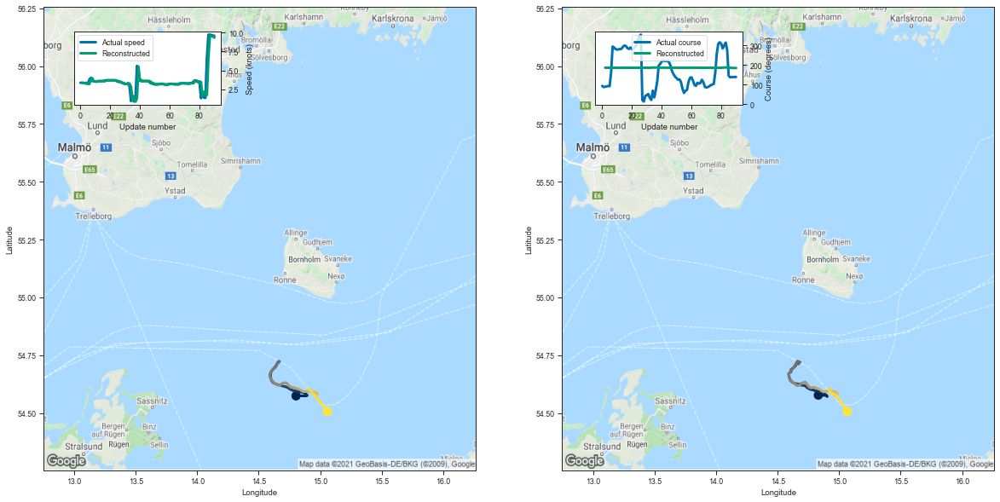

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.830770  54.577118  3.361646  186.616638         0.007524   
3   14.848343  54.577278  3.299294  186.450333         0.005120   
4   14.865895  54.576988  3.242733  186.554169         0.005271   
5   14.884152  54.576145  3.301179  186.610413         0.005722   
6   14.898312  54.576107  3.208498  186.503922         0.005049   
..        ...        ...       ...         ...              ...   
86  14.922385  54.591618  6.563168  186.458786         0.019111   
87  14.974916  54.574303  9.554338  185.244232         0.015813   
88  15.010260  54.552464  9.509641  185.262650         0.015436   
89  15.038344  54.527348  9.473308  184.862640         0.010426   
90  15.065434  54.506550  9.322550  185.025299         0.011524   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005156     0.322314     97.053133  
3         0.003529     0.222524    101.128394  
4         0.003536     0.307417    103.259354  
5  

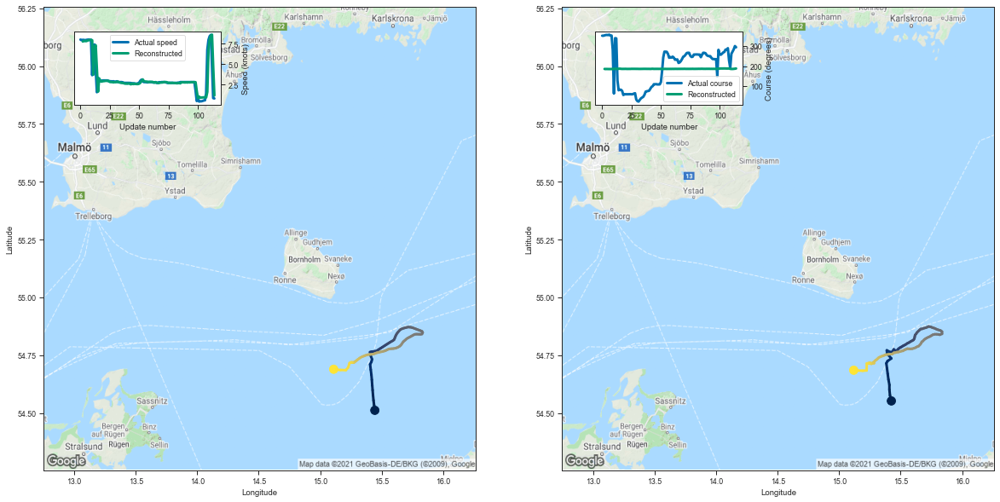

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.424688  54.552082  7.760404  185.651810         0.023116   
3    15.413392  54.576355  7.852845  185.250092         0.013223   
4    15.408784  54.601120  7.814742  185.424408         0.014335   
5    15.408869  54.621532  7.813540  185.175949         0.011154   
6    15.401077  54.644459  7.874358  185.132294         0.010497   
..         ...        ...       ...         ...              ...   
110  15.223540  54.683846  7.983983  185.569214         0.015775   
111  15.191734  54.682625  8.454060  185.605469         0.017891   
112  15.148589  54.683556  8.602974  186.030914         0.027776   
113  15.107421  54.694843  4.722647  186.791550         0.014907   
114  15.118736  54.684975  1.160554  187.897552         0.012692   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013180     1.336695     96.200226  
3          0.007822     0.678418     98.719833  
4          0.008237     1.032369    

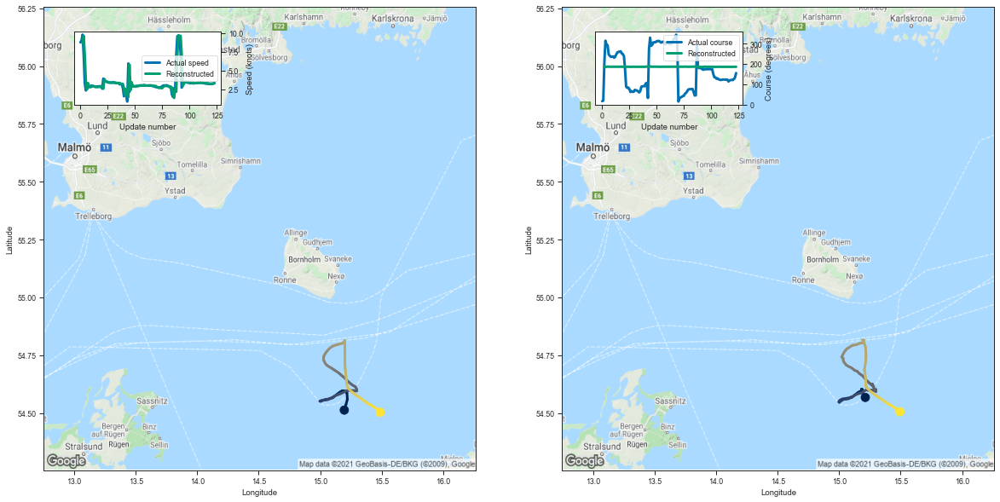

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.212705  54.567245  8.636052  185.457367         0.021528   
3    15.201532  54.568886  9.616907  185.256729         0.020553   
4    15.181623  54.603233  6.999691  186.069809         0.017411   
5    15.189652  54.601891  3.525012  186.782288         0.009838   
6    15.189792  54.600204  2.480409  186.749664         0.006519   
..         ...        ...       ...         ...              ...   
119  15.442475  54.526077  3.269066  185.921234         0.003760   
120  15.456841  54.520824  3.256215  185.998657         0.004132   
121  15.469890  54.515995  3.255773  185.878723         0.003736   
122  15.481719  54.511776  3.247461  186.147461         0.004876   
123  15.494363  54.505272  3.294968  186.055542         0.004675   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012340     1.143597     96.537633  
3          0.011301     1.349360    100.584381  
4          0.009727     1.727578    

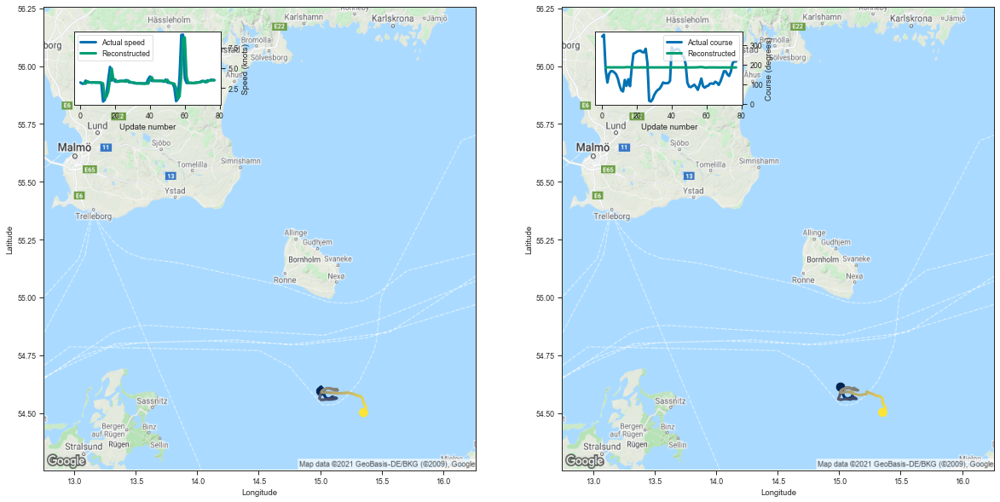

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.012144  54.612076  3.136513  186.308502         0.005754   
3   15.003448  54.607956  3.043175  186.722687         0.006596   
4   15.023930  54.612320  3.358144  186.672241         0.006986   
5   15.022803  54.602638  3.231017  186.307144         0.004633   
6   15.027955  54.592937  3.202794  186.387558         0.004778   
..        ...        ...       ...         ...              ...   
73  15.365808  54.533581  3.266243  185.886124         0.003494   
74  15.375628  54.527138  3.447553  185.998810         0.004177   
75  15.378296  54.517406  3.421796  186.071457         0.004497   
76  15.365850  54.509972  3.499442  185.823883         0.003640   
77  15.354011  54.502556  3.454641  186.013489         0.004215   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004156     0.157905     95.772231  
3         0.004399     0.538154    102.635995  
4         0.004562     0.627826    103.334617  
5  

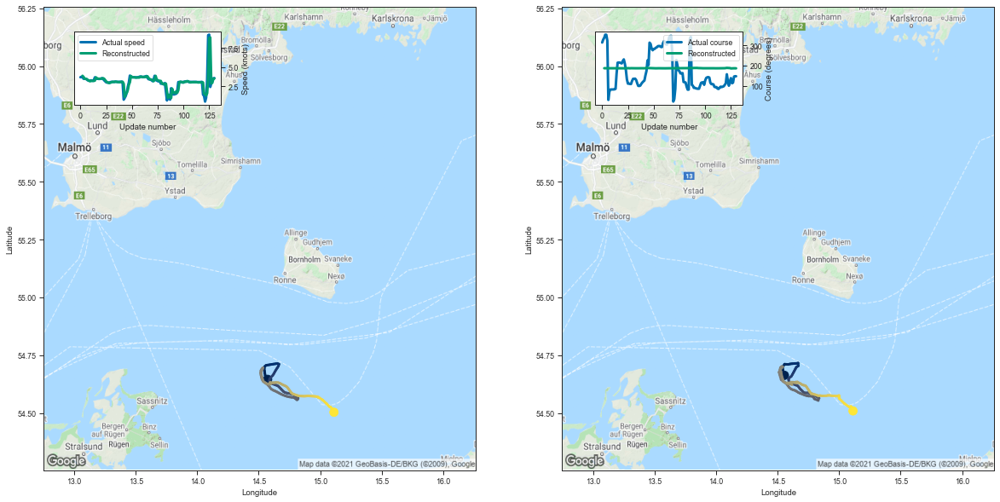

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.555008  54.662819  3.891384  186.574249         0.007739   
3    14.551725  54.672230  3.744475  186.552551         0.005675   
4    14.544295  54.683979  3.510186  186.509888         0.004693   
5    14.540703  54.693790  3.506832  186.456451         0.004340   
6    14.540649  54.697769  3.473459  186.417801         0.004097   
..         ...        ...       ...         ...              ...   
126  15.081708  54.525841  8.895054  186.020111         0.028585   
127  15.096041  54.528419  2.887457  186.565964         0.005822   
128  15.102017  54.524521  2.971291  186.356140         0.004517   
129  15.104876  54.516975  3.488873  186.183105         0.004502   
130  15.112832  54.508965  3.544887  186.094818         0.004162   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005325     0.255221     95.055961  
3          0.003854     0.244721    100.326912  
4          0.003229     0.181443    

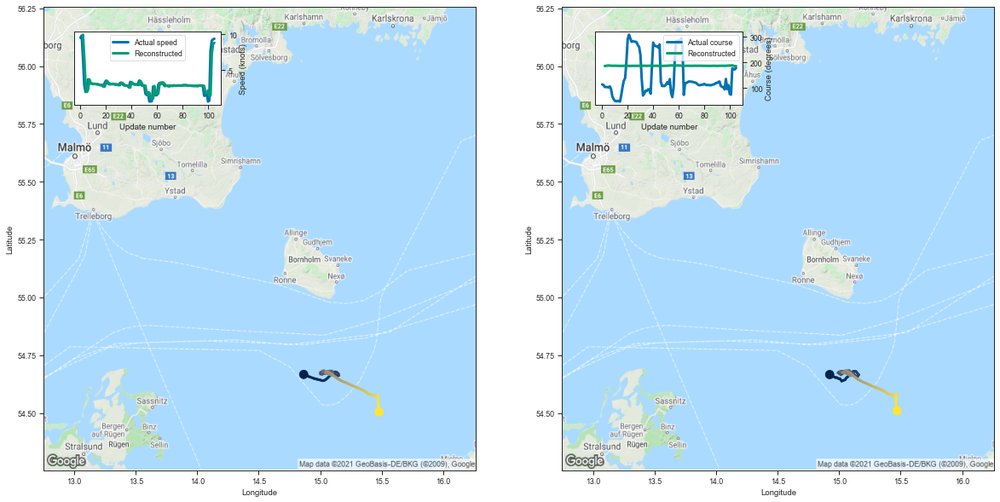

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.923160  54.666065  9.976427  185.318924         0.023719   
3    14.969698  54.653095  6.817100  186.257935         0.017175   
4    14.981725  54.653126  3.076435  187.007492         0.009005   
5    14.997509  54.647842  1.914173  187.610703         0.010795   
6    15.005779  54.648727  2.243359  187.268494         0.008846   
..         ...        ...       ...         ...              ...   
101  15.460546  54.582249  1.386155  187.342606         0.009643   
102  15.464288  54.574150  1.396963  188.364029         0.024784   
103  15.459485  54.561684  7.254613  186.095993         0.025920   
104  15.465586  54.531456  8.663291  185.435287         0.020415   
105  15.471626  54.509293  8.832100  185.266785         0.017614   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013394     1.178421     96.493447  
3          0.009711     1.710624    102.029733  
4          0.005744     1.058497    

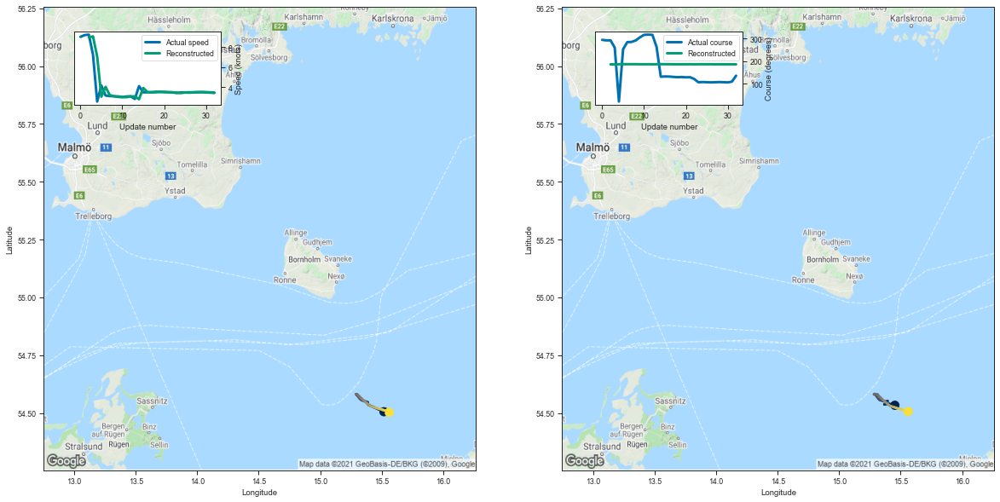

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.453406  54.533405  8.960832  185.455231         0.030080   
3   15.407586  54.539402  9.067512  185.332611         0.022214   
4   15.368083  54.537163  7.050107  186.179626         0.022995   
5   15.394279  54.551453  3.044745  186.389206         0.006360   
6   15.375694  54.549458  4.024984  186.161957         0.006726   
7   15.357815  54.551777  3.213845  186.256302         0.005377   
8   15.342686  54.554348  3.086654  186.249786         0.004946   
9   15.329226  54.556522  3.079896  186.036880         0.003906   
10  15.318379  54.562435  3.018946  185.929489         0.003312   
11  15.308952  54.569073  2.993613  186.039001         0.003573   
12  15.298003  54.576565  3.072832  185.806503         0.002908   
13  15.288858  54.582245  3.077525  186.002579         0.003456   
14  15.283572  54.580379  2.794197  186.412262         0.004773   
15  15.311800  54.580551  3.918198  186.256165         0.00640

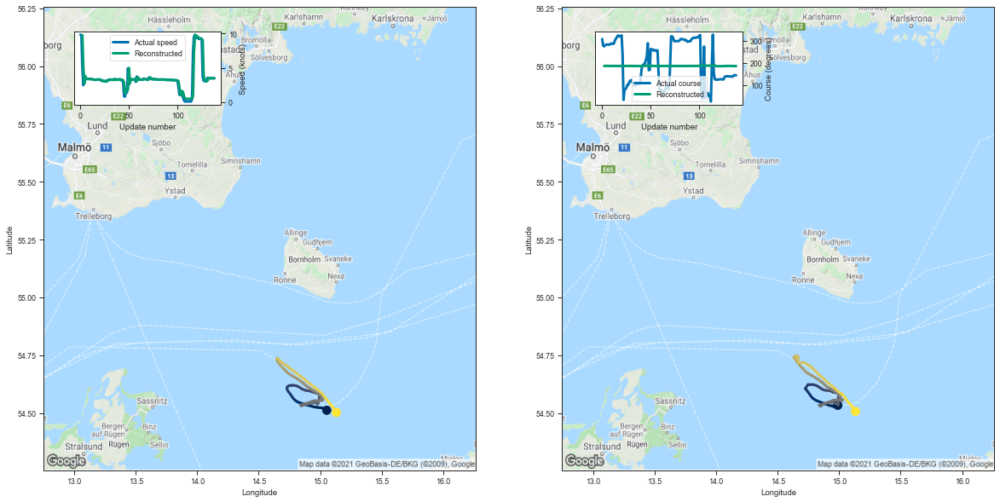

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.989408  54.533077  9.763018  185.966202         0.045327   
3    14.967197  54.538109  5.145868  186.517944         0.013067   
4    14.952918  54.527668  2.709025  187.211868         0.009957   
5    14.936255  54.531277  3.791440  186.452835         0.006686   
6    14.916760  54.532650  3.363428  186.533813         0.005773   
..         ...        ...       ...         ...              ...   
134  15.090476  54.536999  3.479910  186.248993         0.004663   
135  15.102039  54.529884  3.452130  186.274994         0.004782   
136  15.113515  54.521992  3.482881  186.123428         0.004206   
137  15.123749  54.514206  3.480392  186.092697         0.004038   
138  15.132602  54.506550  3.477463  185.861465         0.003191   

     Latitude sigma  Speed sigma  Course sigma  
2          0.023251     2.882472     99.021857  
3          0.007775     1.115972    100.737520  
4          0.006166     1.179504    

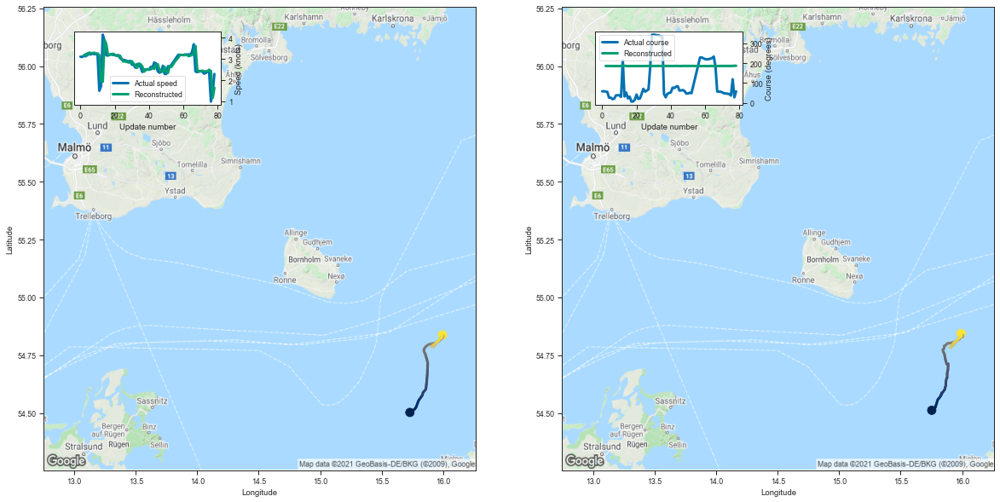

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.752985  54.511665  3.169883  185.950226         0.006846   
3   15.768322  54.518440  3.228319  185.849960         0.005051   
4   15.782179  54.524052  3.171790  185.832581         0.004581   
5   15.786690  54.532669  3.303690  185.838150         0.004721   
6   15.791913  54.539200  3.283154  185.764938         0.004353   
..        ...        ...       ...         ...              ...   
74  15.979500  54.825546  2.430580  185.865601         0.004012   
75  15.986988  54.829239  2.490597  185.925995         0.004395   
76  15.994869  54.835224  2.431394  186.272247         0.006297   
77  15.980349  54.836979  1.163384  187.079544         0.009376   
78  15.991260  54.843437  1.640329  186.964508         0.010574   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004712     0.191497     96.198180  
3         0.003438     0.183331    100.977599  
4         0.003107     0.175394    102.330195  
5  

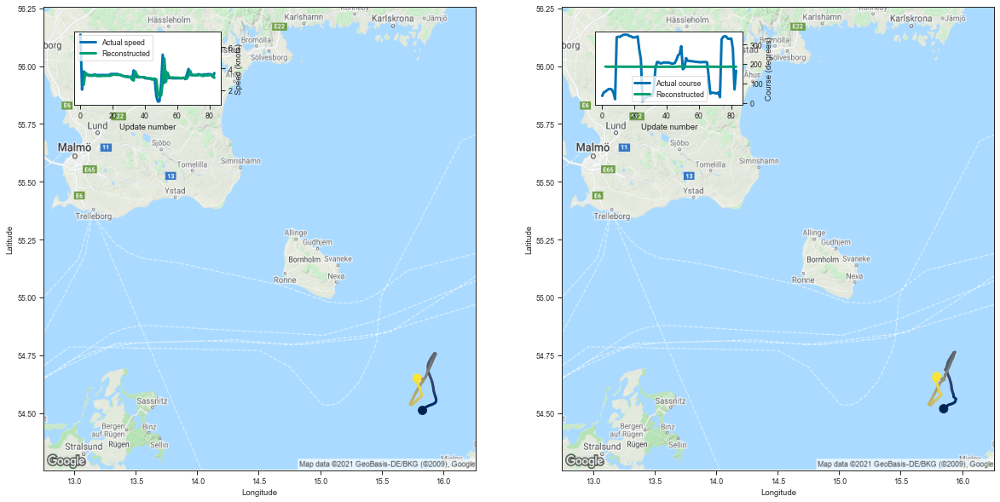

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.849882  54.518284  2.483905  186.731644         0.013198   
3   15.876297  54.528790  3.610443  185.604797         0.005320   
4   15.884331  54.533588  3.487248  185.536636         0.004140   
5   15.898571  54.537094  3.340457  185.831726         0.005180   
6   15.912433  54.538689  3.343294  185.667267         0.004474   
..        ...        ...       ...         ...              ...   
79  15.792872  54.627941  3.347372  186.039490         0.005819   
80  15.784050  54.635994  3.408222  185.691483         0.004378   
81  15.773951  54.644024  3.406366  185.734451         0.004403   
82  15.767014  54.645439  3.397255  185.568268         0.003654   
83  15.793927  54.657318  3.138278  186.002960         0.005022   

    Latitude sigma  Speed sigma  Course sigma  
2         0.008239     0.947628     96.936251  
3         0.003635     0.138813     98.721352  
4         0.002831     0.110440    101.563707  
5  

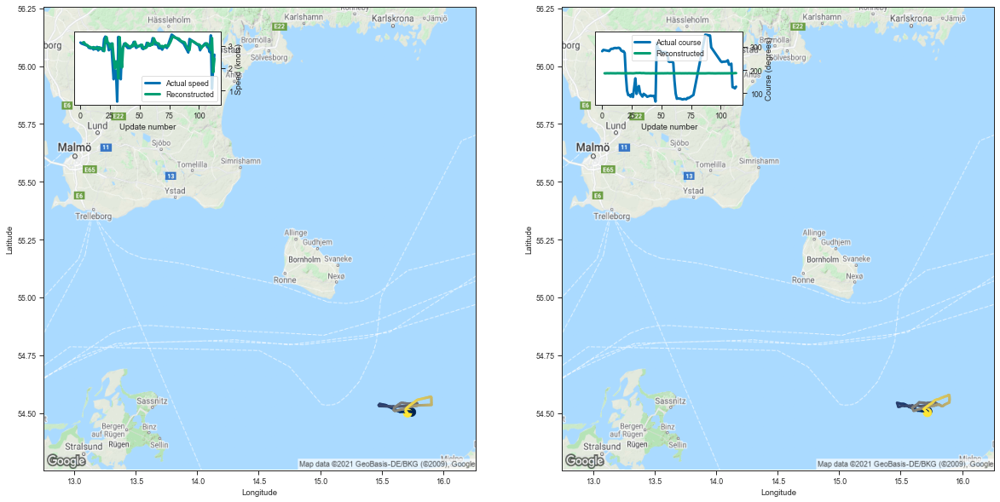

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.720437  54.506916  3.143010  185.845154         0.005894   
3    15.704536  54.511993  3.160400  185.701111         0.004027   
4    15.688512  54.509186  3.073712  186.209946         0.006057   
5    15.674425  54.508476  3.048961  186.081635         0.005392   
6    15.656233  54.510162  3.020842  185.924286         0.004413   
..         ...        ...       ...         ...              ...   
109  15.695314  54.518139  2.988687  185.943878         0.004455   
110  15.687995  54.516006  2.817791  186.002457         0.004367   
111  15.708881  54.504803  3.349735  186.074188         0.005635   
112  15.700316  54.509762  1.815774  186.869766         0.007768   
113  15.717863  54.501919  2.421601  186.610748         0.007594   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004102     0.124777     95.950014  
3          0.002818     0.091901    100.207353  
4          0.003937     0.423092    

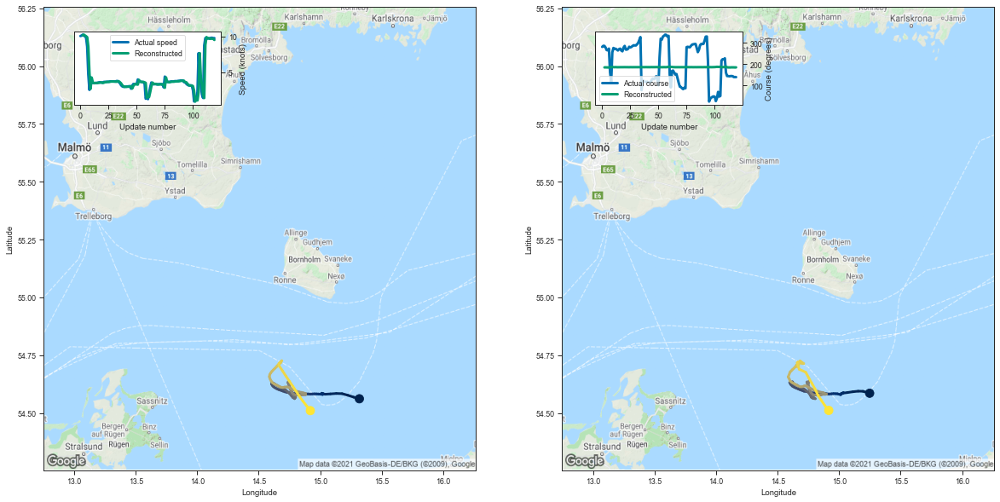

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    15.248070  54.585396  10.178087  185.226593         0.030610   
3    15.193932  54.593746  10.266050  185.464661         0.031559   
4    15.154828  54.594231  10.148230  185.255417         0.023672   
5    15.110806  54.591747  10.049255  185.044556         0.017360   
6    15.065907  54.588158   9.907997  184.984787         0.014600   
..         ...        ...        ...         ...              ...   
115  14.804501  54.603230   9.679221  185.568558         0.018764   
116  14.828534  54.576256   9.699194  185.373199         0.016267   
117  14.854362  54.555626   9.701212  185.411301         0.017046   
118  14.884643  54.531799   9.681159  185.057465         0.012192   
119  14.915628  54.511066   9.529953  185.329315         0.015069   

     Latitude sigma  Speed sigma  Course sigma  
2          0.016732     1.534766     96.370126  
3          0.016323     2.351461    101.759400  
4          0.012673     

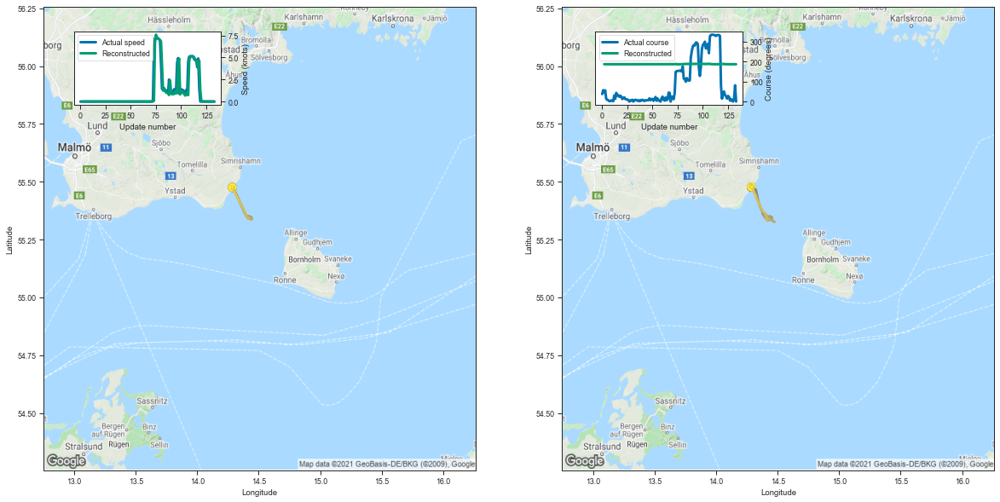

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286873  55.476234  0.003333  186.658463         0.001163   
3    14.287426  55.476582 -0.001235  186.729431         0.001000   
4    14.288092  55.476322 -0.003086  186.576218         0.000811   
5    14.286666  55.477329 -0.001611  186.481781         0.000710   
6    14.287465  55.476608  0.000678  186.470139         0.000693   
..         ...        ...       ...         ...              ...   
129  14.288116  55.476429  0.002420  186.516266         0.000719   
130  14.288035  55.476624  0.001959  186.554245         0.000750   
131  14.288446  55.476028  0.002222  186.543701         0.000745   
132  14.288256  55.475952 -0.000010  186.581314         0.000775   
133  14.287307  55.477268  0.001984  186.553391         0.000764   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001136     0.004358     92.615822  
3          0.000919     0.006560     98.451070  
4          0.000752     0.003974    

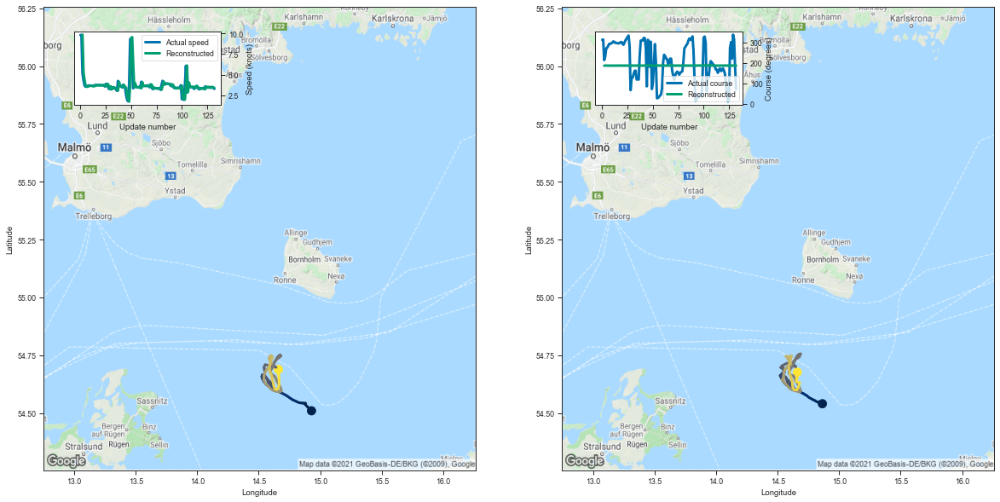

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.863903  54.539883  9.843689  185.707779         0.031934   
3    14.878705  54.544518  5.373803  186.533569         0.013224   
4    14.870456  54.544571  4.382771  186.652206         0.009779   
5    14.847579  54.545376  3.752089  186.477036         0.006256   
6    14.832211  54.546589  3.543170  186.203415         0.004197   
..         ...        ...       ...         ...              ...   
128  14.653102  54.647118  3.482028  186.161270         0.003259   
129  14.659842  54.649212  3.427265  186.493179         0.004470   
130  14.654257  54.667645  3.526774  186.288193         0.003873   
131  14.651568  54.675335  3.459060  186.355103         0.003993   
132  14.659631  54.676533  3.401459  186.462463         0.004376   

     Latitude sigma  Speed sigma  Course sigma  
2          0.017109     1.900017     98.398286  
3          0.007860     1.220432    101.454726  
4          0.006035     0.888764    

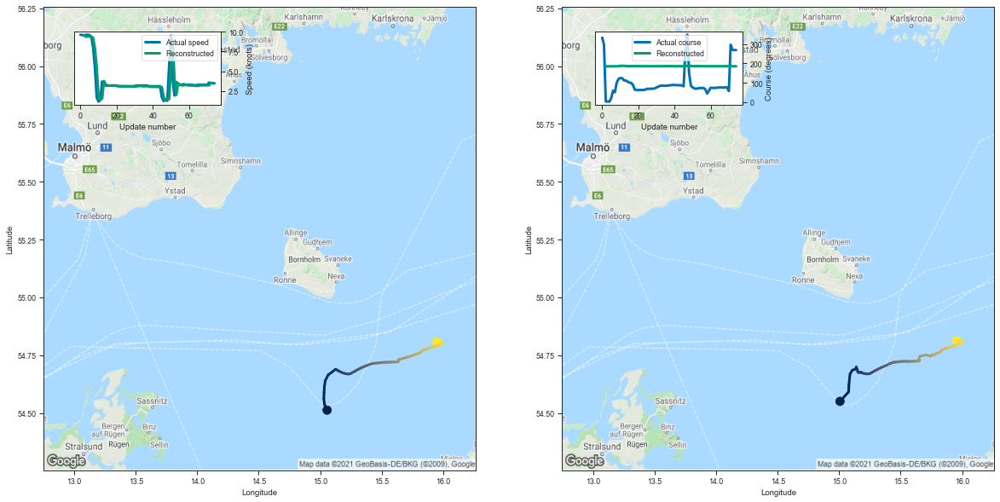

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.007055  54.550243  9.538326  185.316422         0.021524   
3   15.077036  54.591209  9.378600  185.108917         0.014428   
4   15.079696  54.621265  9.389056  184.941772         0.011703   
5   15.084877  54.650368  9.407162  185.018204         0.012346   
6   15.089044  54.668991  9.378283  185.169083         0.014192   
..        ...        ...       ...         ...              ...   
70  15.994795  54.801102  3.235531  185.558228         0.004085   
71  16.007044  54.806179  3.209225  185.550735         0.003979   
72  15.984988  54.815250  3.510998  185.648758         0.005199   
73  15.971039  54.812958  3.512848  185.527008         0.004590   
74  15.956151  54.812363  3.470560  185.600815         0.004739   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012154     1.023379     97.186967  
3         0.008251     0.777106    100.552633  
4         0.006833     0.546140    100.857360  
5  

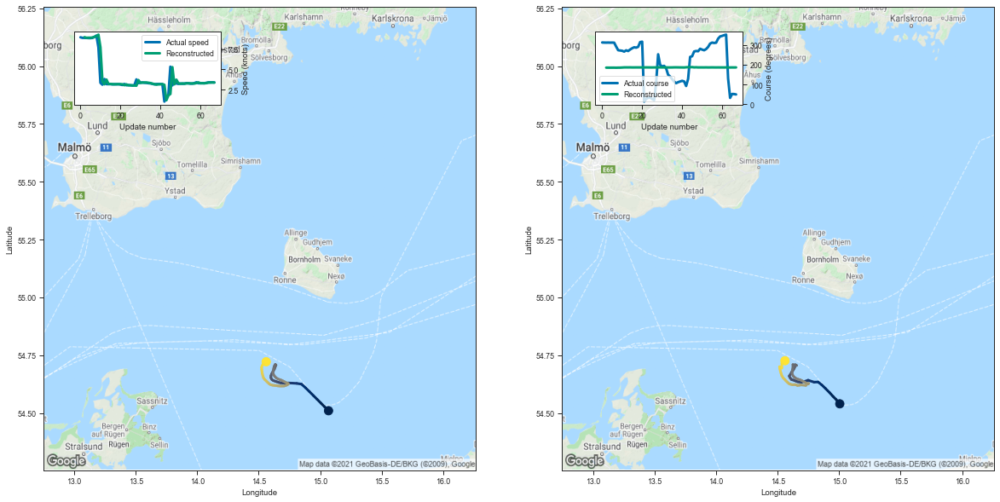

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.005322  54.539600  8.969213  185.416916         0.020074   
3   14.975879  54.558155  8.894815  185.283447         0.013810   
4   14.949647  54.572094  8.905144  185.226105         0.012233   
5   14.922410  54.588120  8.903477  185.284470         0.012446   
6   14.889540  54.605694  8.931613  185.331284         0.012763   
..        ...        ...       ...         ...              ...   
63  14.515488  54.700035  3.314736  186.378525         0.003660   
64  14.533901  54.694164  3.375612  186.291763         0.003369   
65  14.534863  54.715679  3.382185  186.463242         0.003902   
66  14.543179  54.720528  3.398427  186.332657         0.003503   
67  14.559744  54.726021  3.379223  186.528061         0.004230   

    Latitude sigma  Speed sigma  Course sigma  
2         0.011606     0.909491     96.372391  
3         0.008009     0.684115    100.056761  
4         0.007189     0.615837    100.898386  
5  

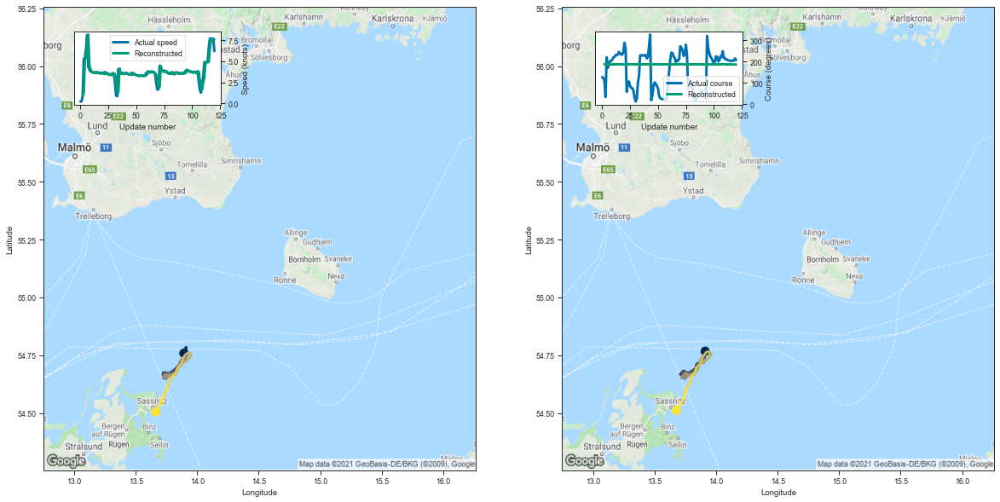

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.910961  54.767082  0.920396  188.289169         0.008736   
3    13.887570  54.762829  1.194610  188.836502         0.014011   
4    13.921625  54.768097  5.275252  187.262589         0.013270   
5    13.917010  54.764519  5.527185  186.902802         0.009829   
6    13.912710  54.773937  6.489916  186.710709         0.010847   
..         ...        ...       ...         ...              ...   
116  13.747384  54.584564  6.554324  186.991882         0.013635   
117  13.735743  54.567223  7.603026  186.502121         0.011718   
118  13.720463  54.547001  7.506402  186.570572         0.011926   
119  13.698757  54.528717  7.558879  186.626587         0.012757   
120  13.676106  54.511448  7.595717  186.453766         0.010757   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005838     0.700545     98.546621  
3          0.008076     2.349459    105.139579  
4          0.007838     1.314572    

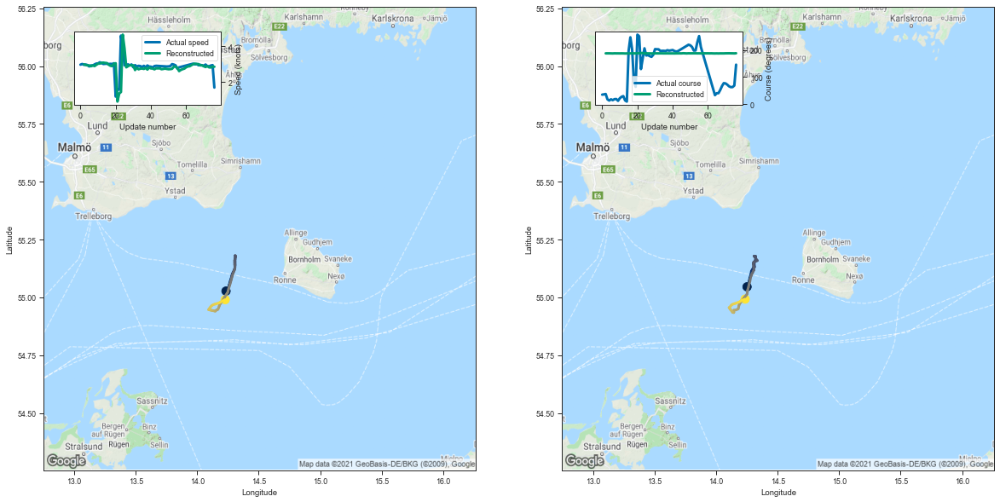

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.251396  55.045601  2.986273  187.212814         0.008132   
3   14.261288  55.051754  2.950401  187.238358         0.007008   
4   14.265808  55.060589  2.929218  187.248718         0.006769   
5   14.268703  55.068707  2.921643  187.071533         0.005642   
6   14.270841  55.074413  2.879928  186.868668         0.004445   
..        ...        ...       ...         ...              ...   
72  14.185626  54.979576  2.885911  187.515747         0.008316   
73  14.198771  54.983601  2.816240  187.367188         0.007143   
74  14.210017  54.987228  2.809524  187.267227         0.006420   
75  14.223148  54.989182  2.859031  187.046356         0.005219   
76  14.235889  54.992424  2.850756  187.639282         0.009277   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005537     0.478373     96.050036  
3         0.004631     0.556175    100.123108  
4         0.004453     0.588081    101.170252  
5  

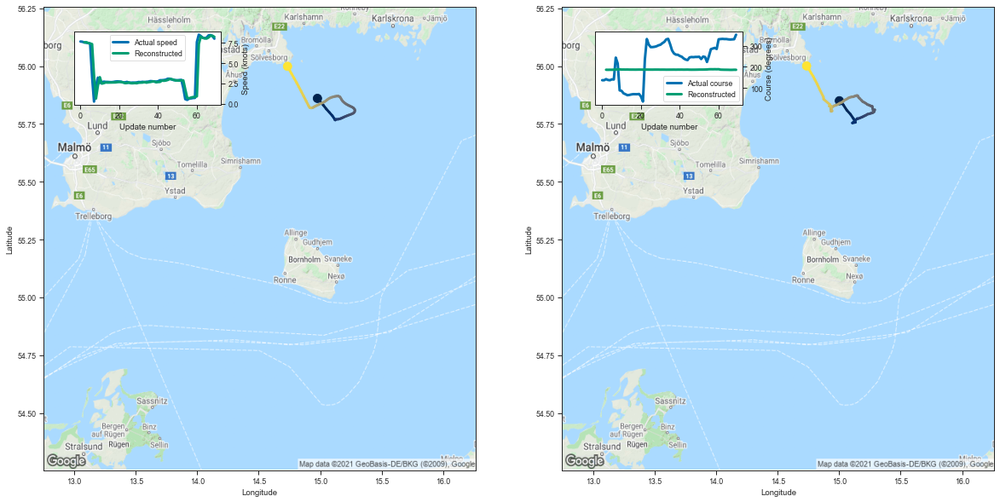

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.001853  55.850185  7.553964  185.789093         0.020029   
3   15.033354  55.833179  7.565765  185.554169         0.013630   
4   15.062675  55.809231  7.472669  185.768585         0.015533   
5   15.091835  55.792179  7.404354  185.702164         0.014680   
6   15.116836  55.772625  7.335746  186.101990         0.021540   
..        ...        ...       ...         ...              ...   
65  14.802835  55.941563  8.012915  185.574402         0.012318   
66  14.788659  55.956329  8.143435  185.209641         0.008548   
67  14.773712  55.969021  8.368721  185.302704         0.009696   
68  14.757156  55.984421  8.359501  185.749924         0.015259   
69  14.735567  56.000828  8.225713  185.546753         0.012386   

    Latitude sigma  Speed sigma  Course sigma  
2         0.013648     0.985688     87.567078  
3         0.009358     0.653535     90.812505  
4         0.010247     1.074822     93.468107  
5  

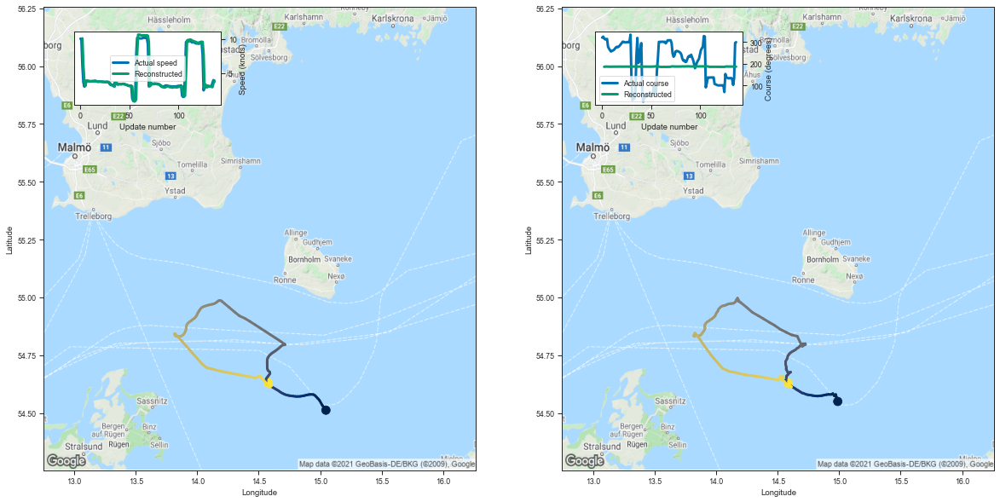

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.988846  54.549862  10.069986  185.697922         0.037863   
3    14.972385  54.579918   6.106497  186.312546         0.014960   
4    14.968773  54.572315   3.809484  186.572708         0.007798   
5    14.958427  54.574726   3.066639  186.773514         0.006895   
6    14.949409  54.583805   3.772447  186.187164         0.004917   
..         ...        ...        ...         ...              ...   
133  14.583731  54.618484   3.039915  186.597046         0.004280   
134  14.592727  54.615269   3.034477  186.489746         0.003825   
135  14.610587  54.614471   2.913263  186.728607         0.004624   
136  14.611899  54.611752   3.439514  186.772217         0.006005   
137  14.584900  54.629082   3.897977  186.468094         0.005337   

     Latitude sigma  Speed sigma  Course sigma  
2          0.019920     2.303157     98.458802  
3          0.008681     1.303187    100.844176  
4          0.005022     

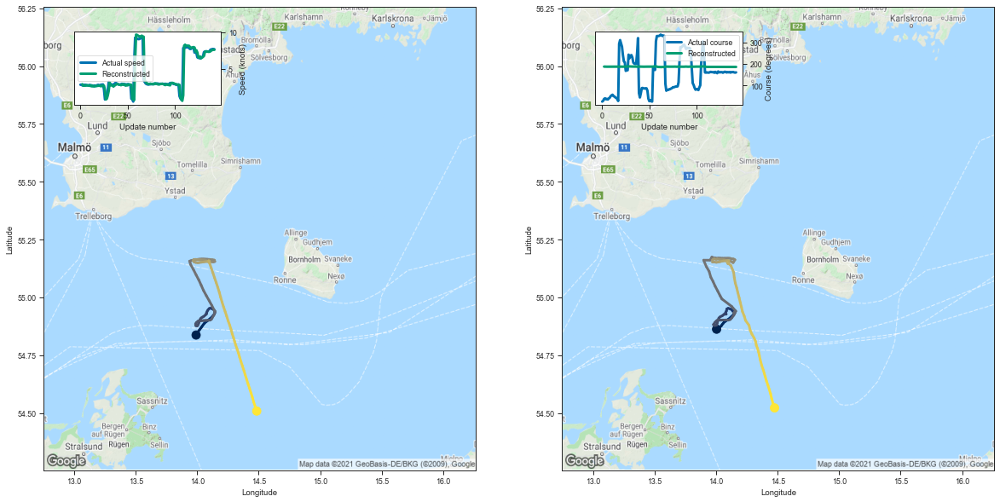

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.004047  54.862358  2.942444  187.363052         0.007833   
3    14.011926  54.863331  2.731634  187.105423         0.004722   
4    14.022794  54.866947  2.742287  187.149841         0.004720   
5    14.030192  54.871193  2.738726  186.993454         0.004031   
6    14.041570  54.876091  2.815604  187.047714         0.004330   
..         ...        ...       ...         ...              ...   
138  14.431375  54.602993  7.428502  185.705688         0.007767   
139  14.443130  54.582512  7.551497  186.021103         0.010992   
140  14.451570  54.561954  7.587259  185.948914         0.010656   
141  14.463188  54.540653  7.648911  185.863495         0.010074   
142  14.475116  54.521843  7.613092  185.857513         0.009922   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005199     0.396054     96.882575  
3          0.003212     0.181924    100.104750  
4          0.003136     0.219738    

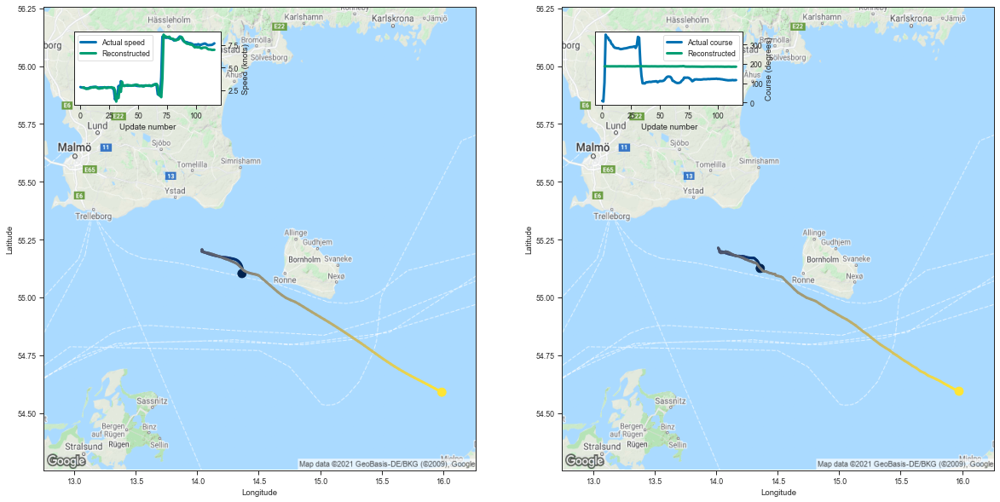

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358954  55.125343  2.782776  187.093338         0.007156   
3    14.376761  55.123383  2.812237  187.265793         0.007659   
4    14.347281  55.141552  2.709733  187.407578         0.008187   
5    14.345524  55.148617  2.644366  187.232025         0.006758   
6    14.338162  55.155022  2.665028  187.173965         0.006275   
..         ...        ...       ...         ...              ...   
112  15.853252  54.627373  7.012068  184.730942         0.006978   
113  15.883660  54.618805  6.993554  184.968109         0.008609   
114  15.914618  54.609589  6.952790  185.229416         0.011472   
115  15.946119  54.600525  6.962113  184.897491         0.008725   
116  15.975410  54.593964  6.969133  185.266708         0.012590   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005039     0.378555     95.457083  
3          0.005110     0.679811     99.147982  
4          0.005367     0.867449    

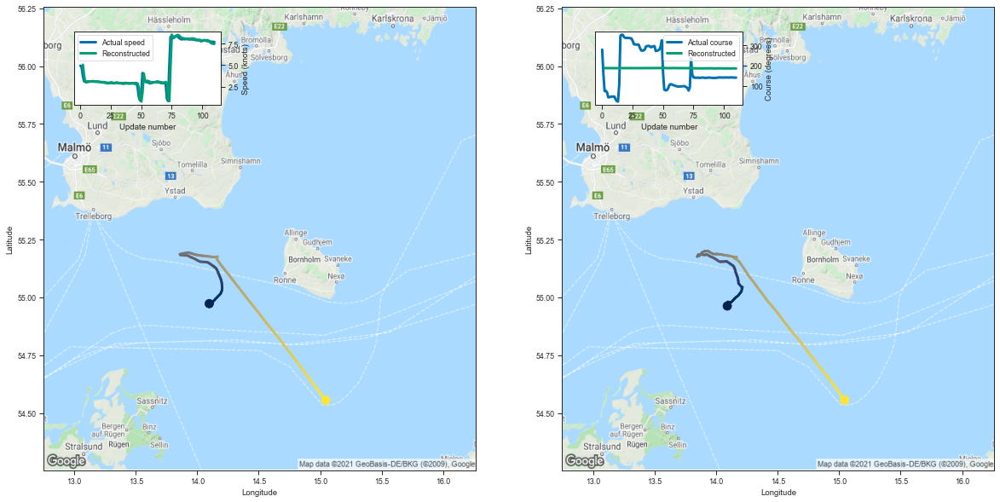

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.090748  54.962582  5.037139  186.886902         0.011543   
3    14.094683  54.980389  3.748745  187.354965         0.009519   
4    14.111395  54.978840  3.049764  187.297501         0.006943   
5    14.124191  54.979721  3.005904  187.240967         0.006328   
6    14.139443  54.988285  3.052707  187.115067         0.005671   
..         ...        ...       ...         ...              ...   
106  14.961016  54.617641  7.739369  185.206970         0.007502   
107  14.979397  54.604149  7.589112  185.764221         0.012340   
108  15.003762  54.585499  7.509861  185.748245         0.012560   
109  15.020061  54.572952  7.487072  185.470581         0.009504   
110  15.044899  54.556011  7.467786  185.480896         0.009431   

     Latitude sigma  Speed sigma  Course sigma  
2          0.007499     0.637645     95.114533  
3          0.005913     0.920575    101.048546  
4          0.004477     0.540842    

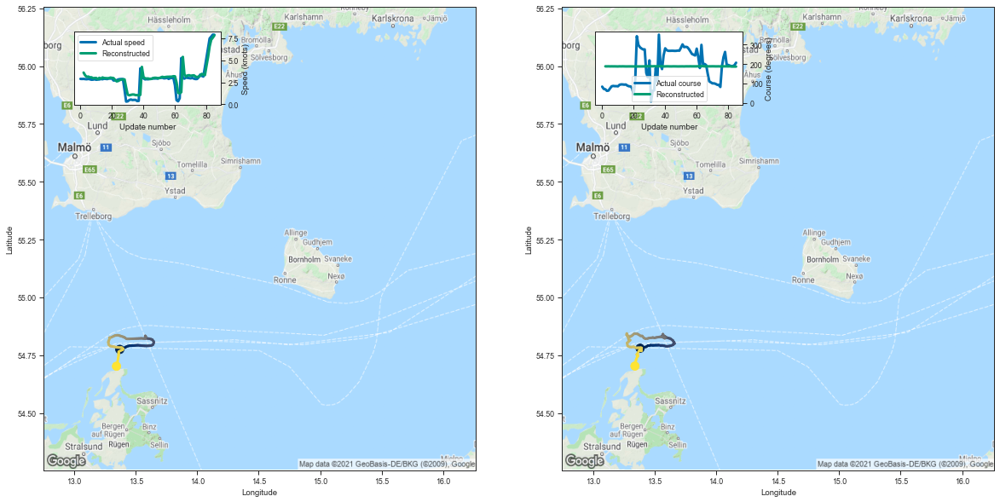

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.382130  54.779968  3.599517  187.968674         0.012201   
3   13.405901  54.782700  3.283571  187.821823         0.008137   
4   13.431879  54.786175  3.114942  188.072311         0.009661   
5   13.445886  54.791279  3.149145  187.761307         0.007301   
6   13.457119  54.791386  3.058509  187.979370         0.008807   
..        ...        ...       ...         ...              ...   
81  13.363075  54.744549  5.369971  188.147598         0.021635   
82  13.364170  54.750248  6.577278  187.035950         0.011006   
83  13.357593  54.741631  7.327238  186.778091         0.010580   
84  13.349131  54.729557  7.560050  186.847076         0.011968   
85  13.340199  54.702888  7.823032  186.817398         0.012656   

    Latitude sigma  Speed sigma  Course sigma  
2         0.007193     0.796021     97.790008  
3         0.004836     0.526334    101.362601  
4         0.005532     0.962723    103.632322  
5  

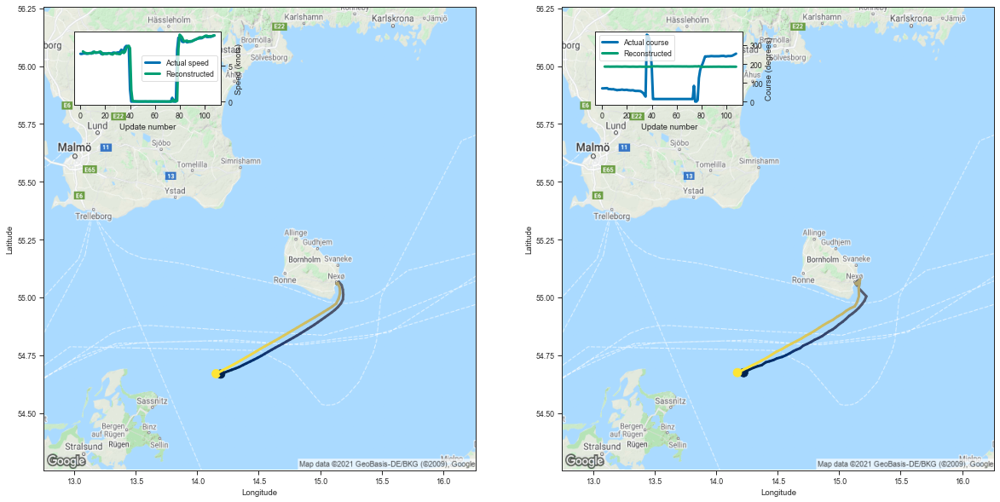

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.224337  54.674118  7.058619  186.261536         0.013327   
3    14.271228  54.687931  6.918325  186.112732         0.009264   
4    14.303931  54.695499  6.843282  186.121185         0.008915   
5    14.339167  54.702278  6.792813  186.300446         0.010495   
6    14.370643  54.706753  6.766232  185.881943         0.007125   
..         ...        ...       ...         ...              ...   
104  14.331824  54.715687  9.198119  185.631912         0.012443   
105  14.298367  54.707245  9.204845  185.574951         0.011291   
106  14.268212  54.699207  9.197221  185.661667         0.011961   
107  14.220043  54.686897  9.282736  185.516434         0.010296   
108  14.173483  54.674595  9.301300  185.589783         0.010643   

     Latitude sigma  Speed sigma  Course sigma  
2          0.008188     0.594836     96.487127  
3          0.005754     0.460218    100.488130  
4          0.005542     0.505955    

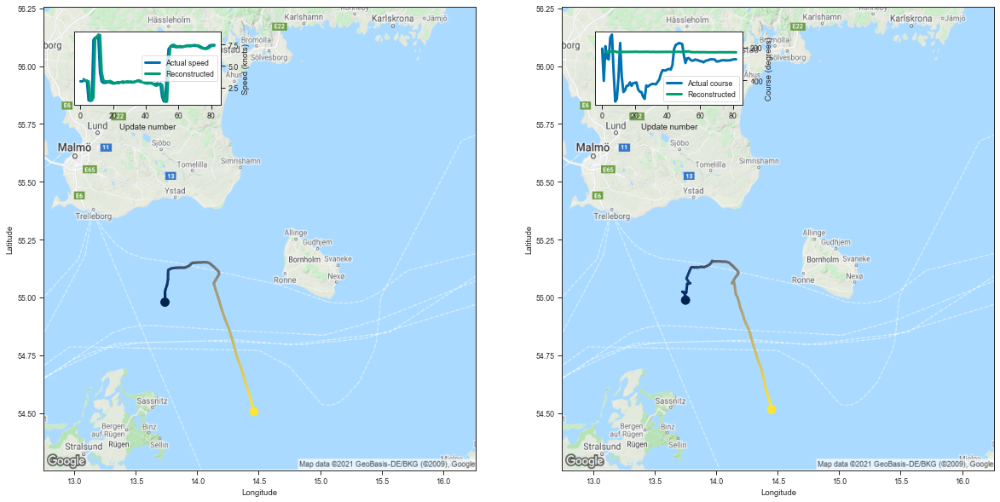

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.751521  54.987812  3.468305  187.332077         0.007844   
3   13.750360  54.987961  3.285233  187.698105         0.008950   
4   13.751095  54.994335  3.294159  187.481812         0.007205   
5   13.752360  55.005146  3.205746  187.551331         0.007367   
6   13.737415  55.020531  1.041589  188.132889         0.005957   
..        ...        ...       ...         ...              ...   
78  14.410206  54.593971  7.036588  186.186096         0.010782   
79  14.422106  54.573116  7.143612  186.074951         0.010221   
80  14.433237  54.555927  7.301980  185.948364         0.009633   
81  14.443134  54.536438  7.359184  185.955200         0.009808   
82  14.450529  54.515114  7.369192  185.730377         0.007952   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005173     0.344179     95.829566  
3         0.005459     0.835597    101.312967  
4         0.004514     0.532558    101.089403  
5  

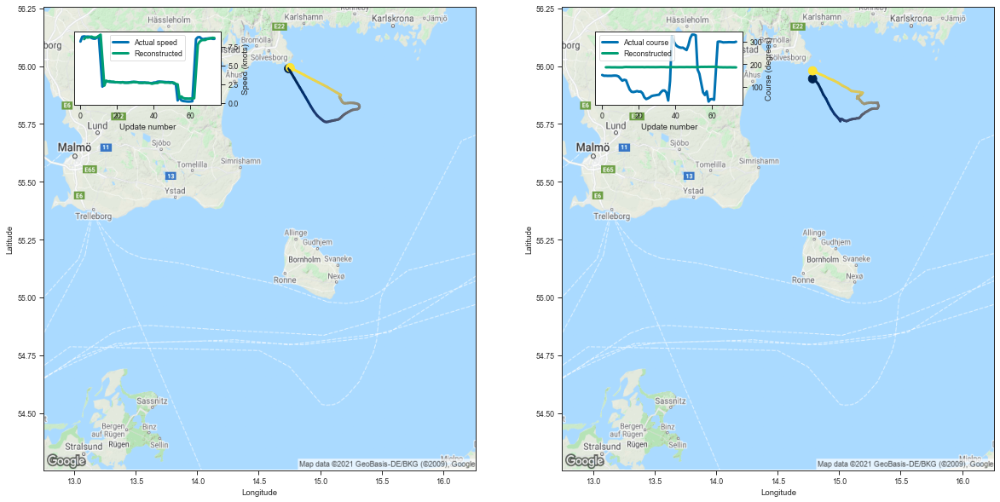

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.784353  55.945335  8.487981  185.499695         0.018197   
3   14.809308  55.936199  8.744179  185.693756         0.018981   
4   14.829853  55.922764  8.696891  185.775650         0.020477   
5   14.852402  55.899158  8.743042  185.370651         0.013962   
6   14.872059  55.876640  8.833329  185.394516         0.014185   
..        ...        ...       ...         ...              ...   
69  14.914525  55.946884  8.504944  185.411926         0.012841   
70  14.880929  55.956779  8.533661  185.489502         0.014155   
71  14.847765  55.964008  8.602995  185.110260         0.009682   
72  14.818674  55.971241  8.670250  185.288483         0.011063   
73  14.784760  55.979797  8.641861  184.977325         0.007890   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012596     0.613091     85.788245  
3         0.012407     1.271715     92.440173  
4         0.013138     1.503890     93.232363  
5  

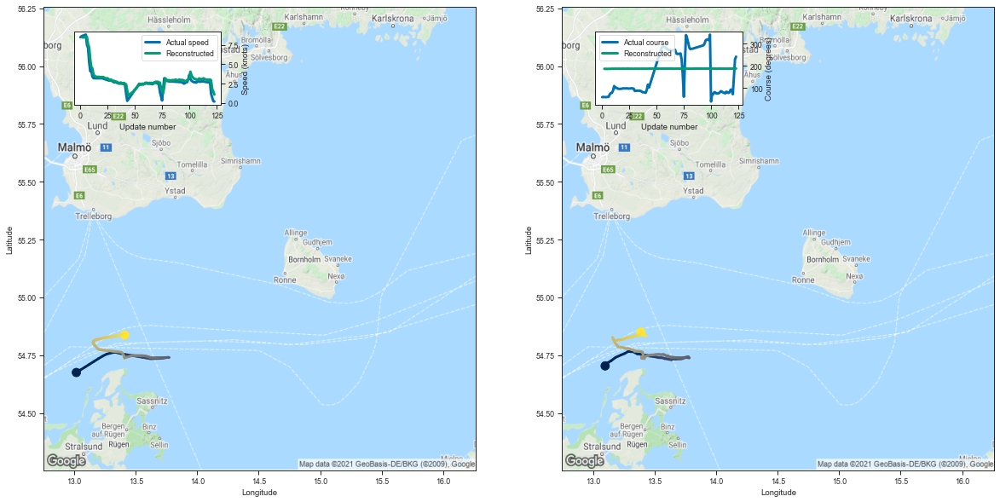

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.098005  54.703640  8.452464  187.177551         0.024671   
3    13.104750  54.712967  8.476574  187.051834         0.018146   
4    13.145315  54.725174  8.465850  187.047882         0.017624   
5    13.183291  54.740395  8.563444  186.779877         0.014131   
6    13.227161  54.750740  8.505285  187.176956         0.020762   
..         ...        ...       ...         ...              ...   
119  13.399480  54.839397  3.035445  187.952164         0.008237   
120  13.409416  54.839390  2.940851  188.156586         0.009799   
121  13.431088  54.833141  1.825199  188.855438         0.013274   
122  13.403373  54.839794  1.499091  188.609329         0.009551   
123  13.388276  54.849812  1.094160  188.539490         0.007337   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013223     1.275720     97.131430  
3          0.009841     1.122924    101.197990  
4          0.009545     1.225979    

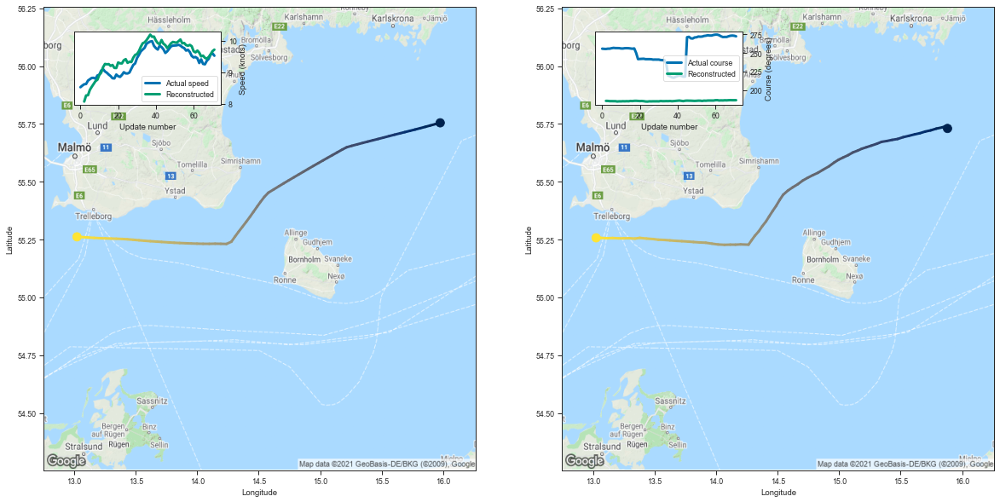

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.881161  55.730354  8.076147  185.425018         0.037464   
3   15.873858  55.741749  8.269274  185.358459         0.028905   
4   15.839172  55.735241  8.277079  185.048203         0.019427   
5   15.790113  55.729679  8.446815  185.060303         0.018826   
6   15.743888  55.722069  8.545176  185.008499         0.017580   
..        ...        ...       ...         ...              ...   
67  13.206162  55.255142  9.436167  186.302811         0.011603   
68  13.157448  55.256653  9.490123  186.434143         0.012970   
69  13.113586  55.255512  9.572814  186.319931         0.011543   
70  13.064739  55.256969  9.673805  186.317749         0.011473   
71  13.024633  55.257435  9.722965  186.354584         0.011656   

    Latitude sigma  Speed sigma  Course sigma  
2         0.024341     1.673132     84.395165  
3         0.018446     1.752226     89.803352  
4         0.012826     0.920493     89.876969  
5  

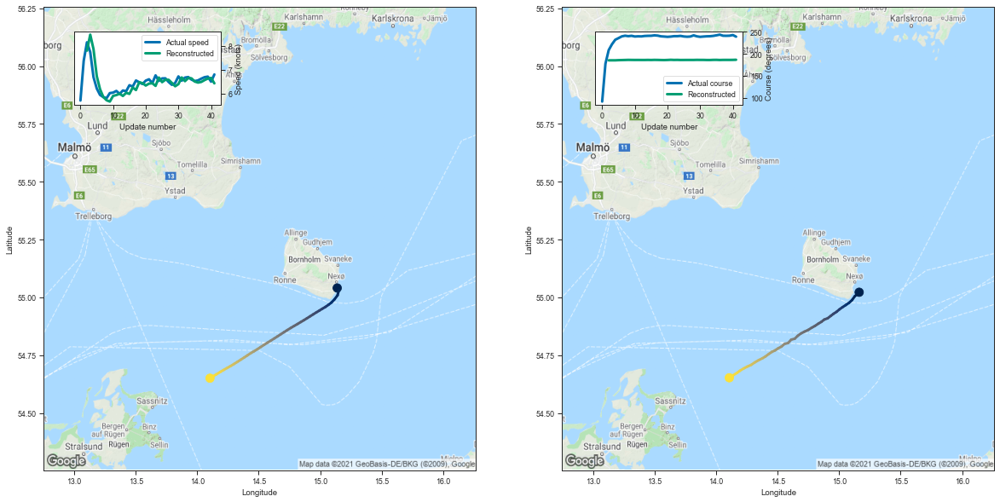

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.162948  55.022076  7.789314  185.283203         0.014010   
3   15.127335  55.004688  8.456771  185.325424         0.013742   
4   15.105300  54.988354  7.852559  185.321899         0.010701   
5   15.079697  54.976032  6.730450  185.678741         0.009878   
6   15.053939  54.966640  6.188314  185.880737         0.009885   
7   15.027052  54.957329  5.864385  186.100922         0.010809   
8   15.001981  54.947769  5.727829  186.323654         0.012767   
9   14.979442  54.937603  5.672782  186.210388         0.011378   
10  14.953716  54.928707  5.908406  186.132278         0.011045   
11  14.931258  54.919453  5.943812  186.163086         0.011245   
12  14.906622  54.909416  5.998170  186.104965         0.010668   
13  14.879056  54.903885  5.906013  186.089767         0.009842   
14  14.855648  54.893997  6.035846  186.241745         0.011627   
15  14.830902  54.886177  5.992565  186.070587         0.00974

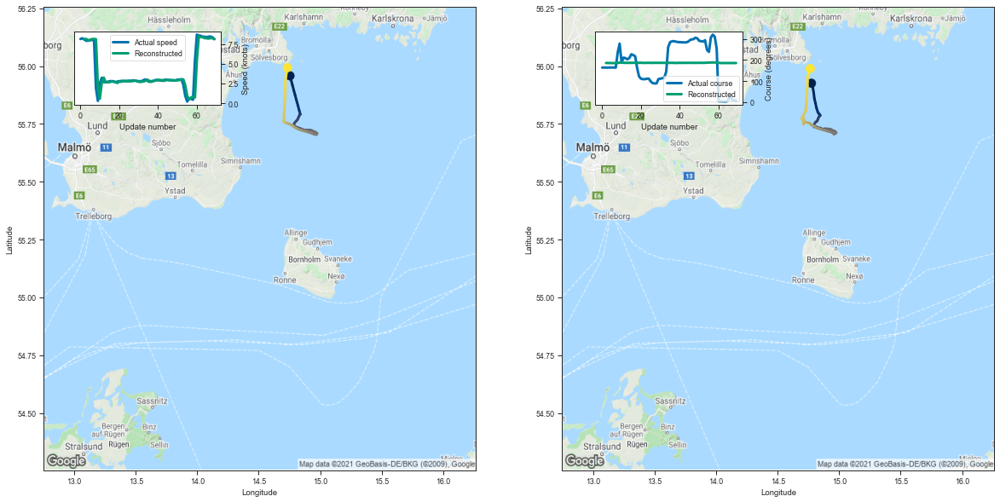

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.774939  55.925976  8.104388  185.878494         0.023191   
3   14.785849  55.907940  8.130737  185.956360         0.020708   
4   14.793482  55.884365  7.944968  185.500305         0.012014   
5   14.798861  55.859180  8.026133  185.507919         0.011655   
6   14.806827  55.841812  8.104629  185.295837         0.009635   
..        ...        ...       ...         ...              ...   
65  14.742355  55.915234  8.209789  185.585251         0.011877   
66  14.743353  55.934715  8.174346  185.532242         0.011161   
67  14.741770  55.950726  8.232508  185.732956         0.013947   
68  14.754254  55.970699  8.216372  185.585434         0.012289   
69  14.764921  55.989384  8.156098  185.607605         0.012300   

    Latitude sigma  Speed sigma  Course sigma  
2         0.015404     1.145124     87.069404  
3         0.013379     1.471825     92.099715  
4         0.008266     0.477312     90.804854  
5  

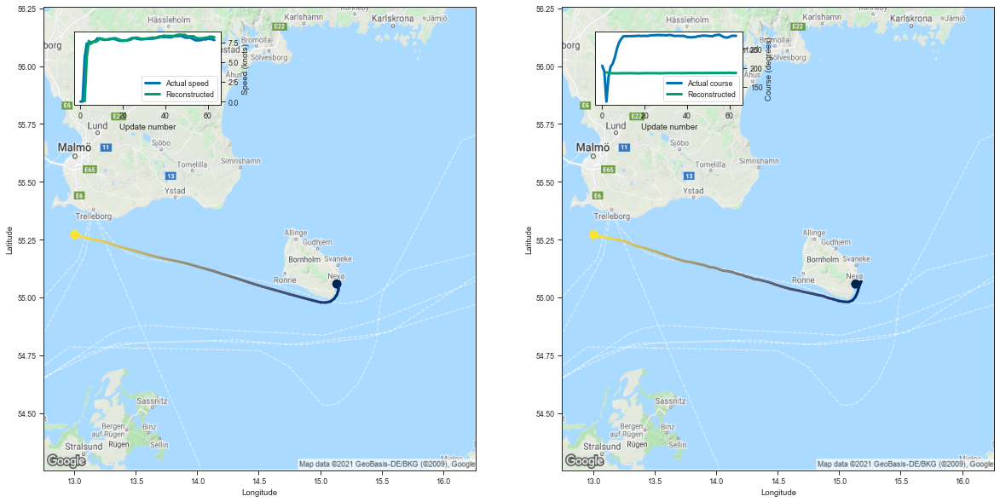

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.134705  55.057640  0.046257  188.117630         0.008816   
3   15.179544  55.068485  5.658455  186.327621         0.016643   
4   15.161450  55.044361  7.682496  185.702774         0.016239   
5   15.150661  55.023846  7.333803  185.618195         0.012758   
6   15.133423  55.002300  7.564524  185.487228         0.011598   
..        ...        ...       ...         ...              ...   
59  13.143264  55.254070  8.101259  186.980957         0.013964   
60  13.103955  55.258244  8.110794  186.790222         0.011485   
61  13.067863  55.262039  8.224852  186.537872         0.008928   
62  13.034294  55.265995  8.204041  186.406082         0.007558   
63  13.004622  55.270508  8.139511  186.471451         0.007680   

    Latitude sigma  Speed sigma  Course sigma  
2         0.007012     1.292139     99.735980  
3         0.010262     1.381347     96.080843  
4         0.009657     1.183790     97.648025  
5  

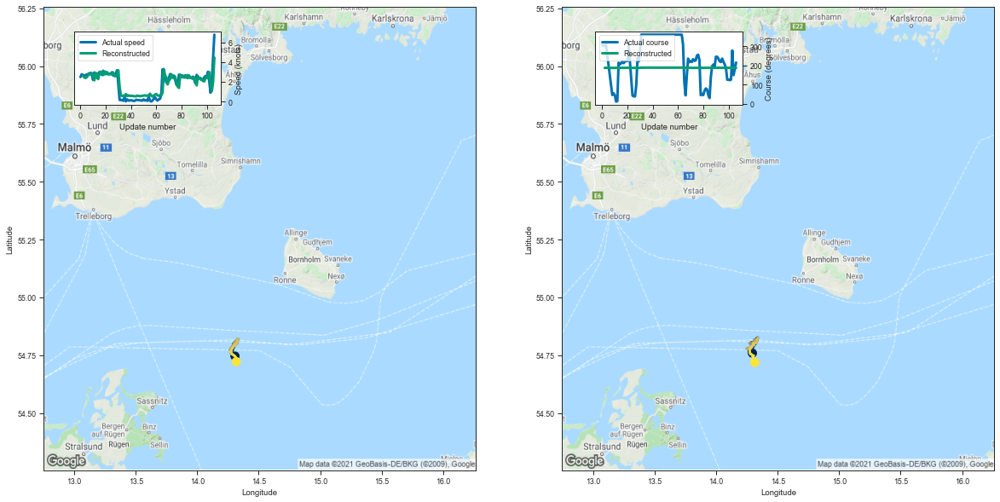

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.294991  54.758915  2.624926  186.987564         0.005982   
3    14.276075  54.762848  2.451642  187.225647         0.005767   
4    14.266705  54.767025  2.391462  187.069641         0.004674   
5    14.276811  54.768295  2.473503  187.278091         0.005876   
6    14.288939  54.769791  2.651735  187.133072         0.005552   
..         ...        ...       ...         ...              ...   
102  14.299290  54.747364  2.977269  187.138992         0.006154   
103  14.305468  54.748013  1.948973  187.822128         0.008388   
104  14.297018  54.743271  1.064880  187.753021         0.006015   
105  14.314921  54.731552  2.019630  187.841583         0.009119   
106  14.314733  54.718815  4.467974  186.864639         0.008724   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004210     0.182986     95.708914  
3          0.003860     0.347272    101.329512  
4          0.003199     0.213252    

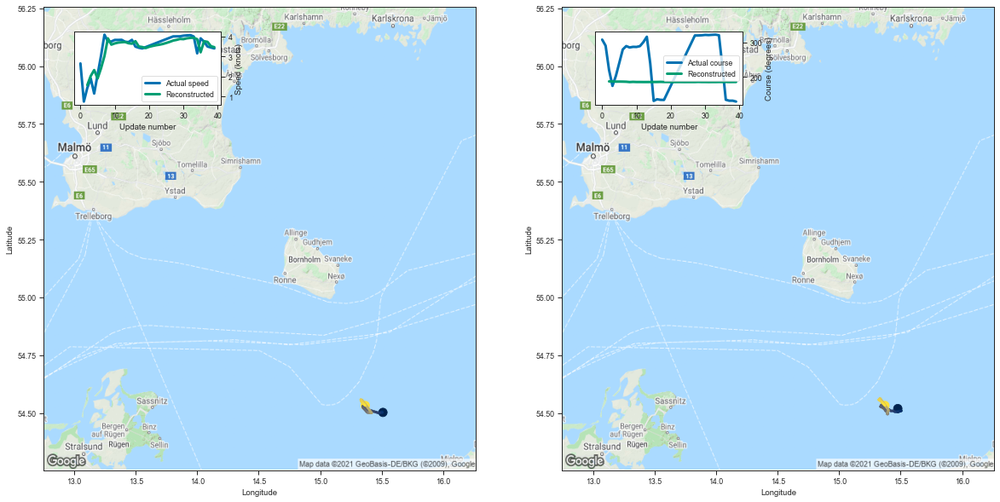

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.477032  54.518986  1.571769  187.610519         0.019302   
3   15.490394  54.510910  2.025485  187.449905         0.016106   
4   15.505483  54.509281  2.321581  186.991806         0.010554   
5   15.495592  54.507706  1.904532  187.086639         0.009516   
6   15.480303  54.506546  2.412465  186.961884         0.009604   
7   15.454095  54.505131  3.023748  186.671555         0.008506   
8   15.437818  54.509224  3.902063  185.774658         0.004617   
9   15.421273  54.508881  3.589795  186.330673         0.006560   
10  15.405404  54.514458  3.651330  185.924820         0.004604   
11  15.389882  54.516239  3.691131  185.945114         0.004543   
12  15.369592  54.521450  3.709203  185.830551         0.003979   
13  15.355831  54.525581  3.721155  185.844925         0.003978   
14  15.342845  54.534431  3.660019  185.946655         0.004280   
15  15.336018  54.527443  3.636995  185.935547         0.00419

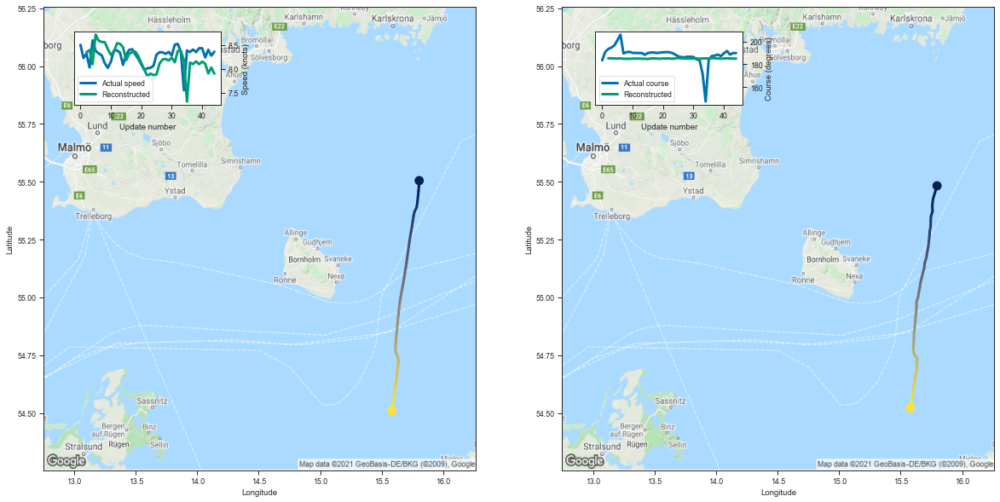

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.796019  55.482449  8.347015  185.206741         0.029094   
3   15.779602  55.453751  8.392176  185.324829         0.026050   
4   15.763773  55.426392  8.096519  185.137207         0.018656   
5   15.757527  55.398148  8.712942  184.957748         0.018256   
6   15.759314  55.370739  8.582680  185.184830         0.021573   
7   15.746840  55.351162  8.561615  184.817093         0.014896   
8   15.744711  55.330559  8.553564  184.834656         0.014245   
9   15.743887  55.307194  8.410812  184.785934         0.012768   
10  15.736730  55.285618  8.293193  185.025040         0.015417   
11  15.734405  55.265404  8.351069  185.010178         0.015805   
12  15.729497  55.243393  8.533152  184.986206         0.016281   
13  15.724724  55.218922  8.521092  184.866867         0.014180   
14  15.716331  55.195080  8.449272  184.787445         0.012490   
15  15.709074  55.171124  8.178711  184.654510         0.00969

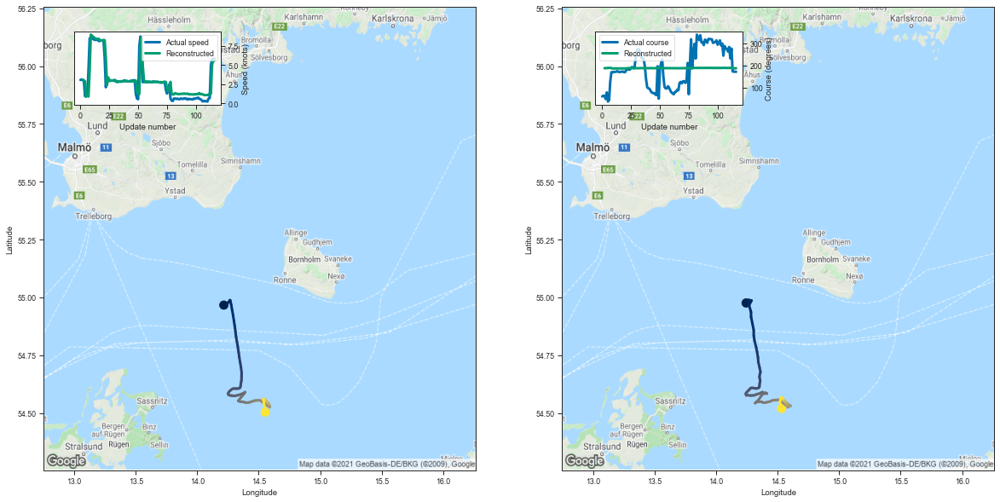

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.243758  54.975655  3.104467  186.862427         0.005903   
3    14.257648  54.977413  2.975739  187.074478         0.005788   
4    14.274300  54.982380  2.851606  187.266479         0.006586   
5    14.258083  54.983074  0.853114  188.085587         0.006900   
6    14.259851  54.985855  1.069832  188.095245         0.007834   
..         ...        ...       ...         ...              ...   
112  14.539871  54.564770  1.304473  188.068390         0.011140   
113  14.525882  54.565876  1.244099  188.405838         0.015059   
114  14.518625  54.546585  4.993085  186.739243         0.011125   
115  14.527835  54.533955  5.651147  186.330368         0.008910   
116  14.532554  54.519859  5.565230  186.669876         0.011771   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004215     0.188198     95.070394  
3          0.003893     0.355048    100.500243  
4          0.004287     0.577437    

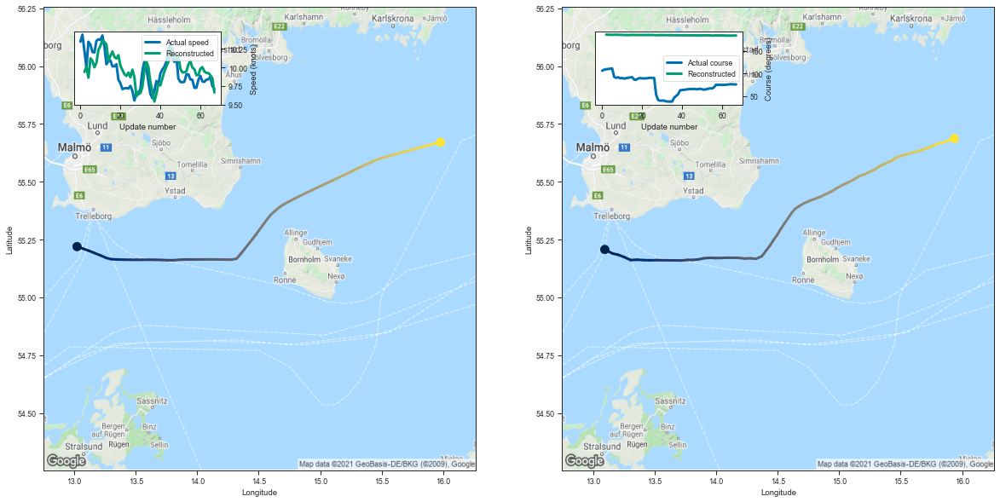

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.094942  55.206921   9.939199  186.487000         0.019457   
3   13.157986  55.189651  10.008472  186.287491         0.013660   
4   13.201733  55.184448   9.861599  186.296860         0.012981   
5   13.254311  55.173790  10.121611  186.030930         0.011355   
6   13.305285  55.161251  10.090122  186.189316         0.013462   
..        ...        ...        ...         ...              ...   
63  15.787641  55.662224   9.926727  184.412613         0.014234   
64  15.829767  55.667645   9.923613  184.319183         0.013502   
65  15.867014  55.674179   9.896468  184.304977         0.013525   
66  15.903161  55.681164   9.854116  184.476334         0.016530   
67  15.937531  55.686779   9.662445  184.498993         0.016735   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012003     0.752780     92.940626  
3         0.008489     0.596683     97.431787  
4         0.008030     0.639068     98.

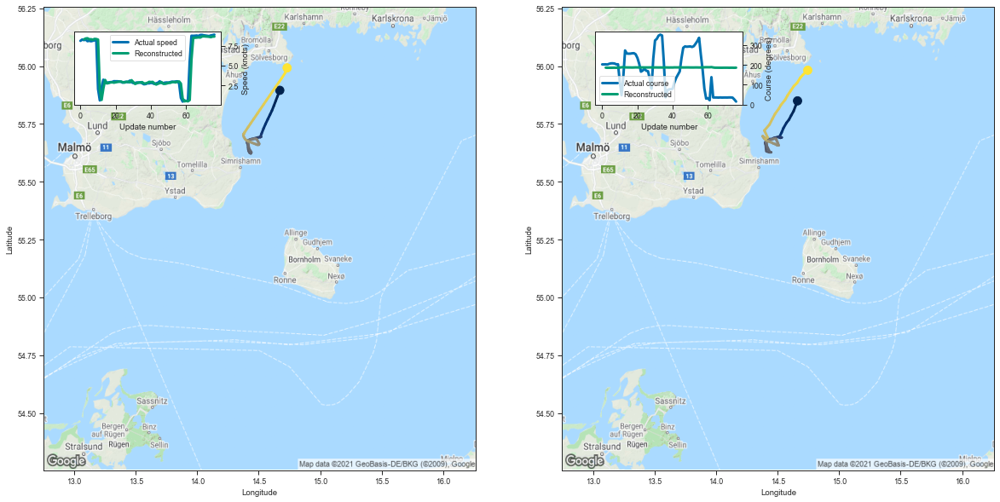

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.661933  55.849815  8.284897  185.810776         0.020216   
3   14.647614  55.830452  8.395956  185.295502         0.010284   
4   14.629395  55.804695  8.426263  185.389450         0.010294   
5   14.610271  55.786819  8.291109  185.318832         0.008923   
6   14.592937  55.769001  8.303225  185.521011         0.010615   
..        ...        ...       ...         ...              ...   
72  14.632388  55.913857  8.633190  185.345718         0.009983   
73  14.658180  55.927349  8.608206  185.574493         0.012290   
74  14.685752  55.950695  8.561949  185.580750         0.012815   
75  14.707489  55.963444  8.634794  185.281555         0.009794   
76  14.745130  55.982246  8.638569  185.770035         0.016258   

    Latitude sigma  Speed sigma  Course sigma  
2         0.013617     0.968554     87.970879  
3         0.007357     0.295833     90.148765  
4         0.007246     0.417757     92.456345  
5  

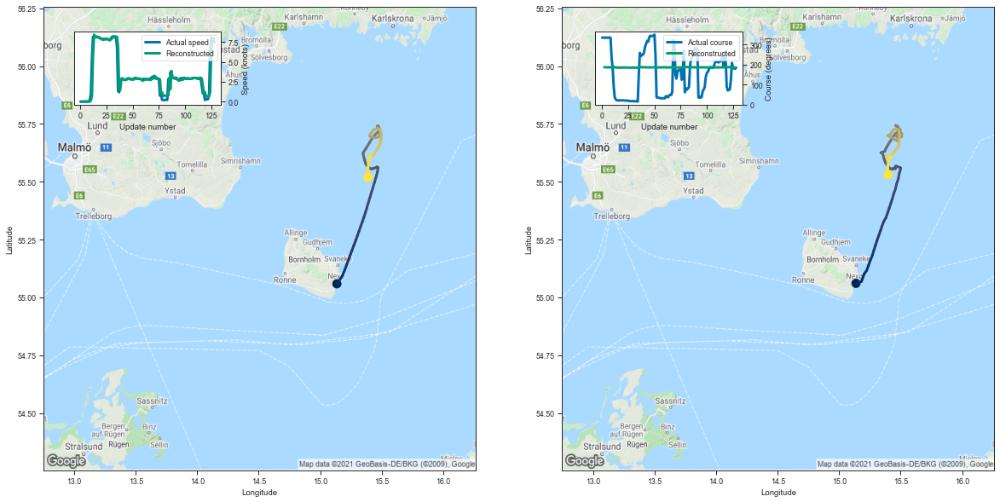

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137041  55.060658  0.007872  186.913528         0.002474   
3    15.137326  55.060135  0.006021  186.823059         0.001735   
4    15.137526  55.060040  0.004638  186.588745         0.001266   
5    15.136642  55.060955  0.002012  186.490280         0.001104   
6    15.136542  55.060558  0.002546  186.353165         0.000936   
..         ...        ...       ...         ...              ...   
124  15.419642  55.609322  1.186263  187.565018         0.014848   
125  15.402784  55.594612  6.420074  186.043808         0.020781   
126  15.396072  55.573215  7.930453  185.402832         0.016742   
127  15.396566  55.552868  7.955407  185.350647         0.015076   
128  15.398808  55.530819  7.984941  185.085815         0.011592   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002285     0.038210     94.841140  
3          0.001550     0.033363    100.619551  
4          0.001155     0.015530    

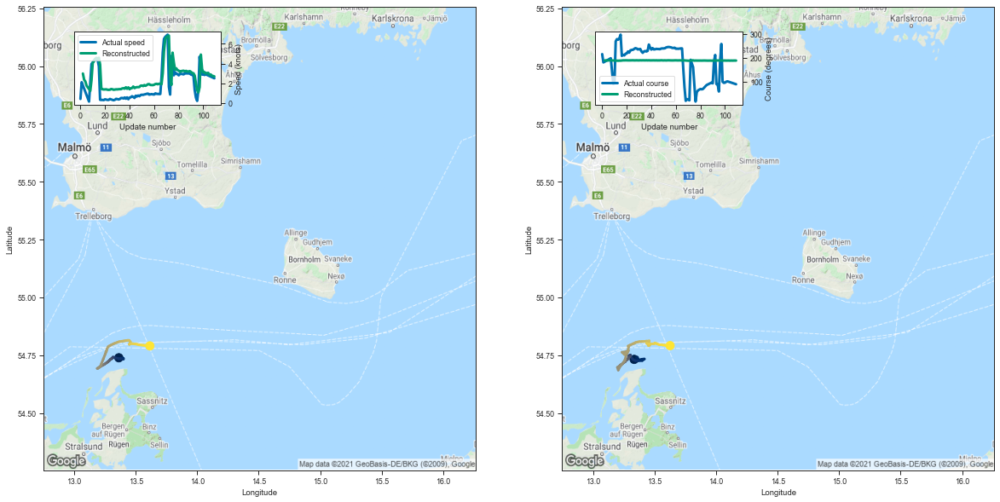

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.333936  54.731686  2.981400  188.126938         0.011524   
3    13.340687  54.733715  2.356042  188.718140         0.014183   
4    13.354983  54.739407  2.177272  188.116180         0.007331   
5    13.350435  54.734524  1.752458  188.620224         0.010131   
6    13.350151  54.736065  1.571427  188.860397         0.012239   
..         ...        ...       ...         ...              ...   
105  13.568063  54.793568  2.850426  188.016724         0.009165   
106  13.580901  54.793491  2.889941  187.743881         0.007178   
107  13.595984  54.791233  2.759285  187.947617         0.008379   
108  13.610415  54.791275  2.726771  188.049622         0.009333   
109  13.625697  54.791183  2.690343  187.930023         0.008297   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006854     0.690351     97.219383  
3          0.007681     1.797732    103.762273  
4          0.004340     0.482034    

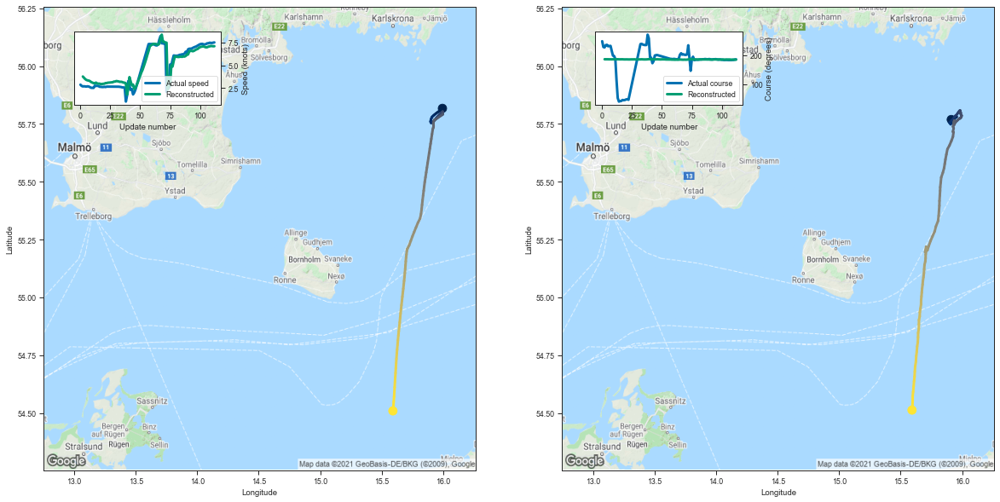

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.911740  55.768902  3.775365  186.496033         0.028015   
3    15.953488  55.781235  3.630354  186.423798         0.019938   
4    15.955135  55.780540  3.491683  186.411560         0.017009   
5    15.951971  55.780132  3.395193  186.358658         0.014980   
6    15.946104  55.777737  3.351299  186.188934         0.012113   
..         ...        ...       ...         ...              ...   
108  15.601496  54.591080  7.085564  185.005432         0.008025   
109  15.598024  54.572723  7.131335  185.181137         0.009111   
110  15.598076  54.550606  7.118329  185.227814         0.009578   
111  15.595777  54.531010  7.101175  185.157089         0.008859   
112  15.592536  54.512539  7.103872  185.163391         0.008811   

     Latitude sigma  Speed sigma  Course sigma  
2          0.022200     1.371359     79.508254  
3          0.015437     1.321818     85.223700  
4          0.013143     1.296756    

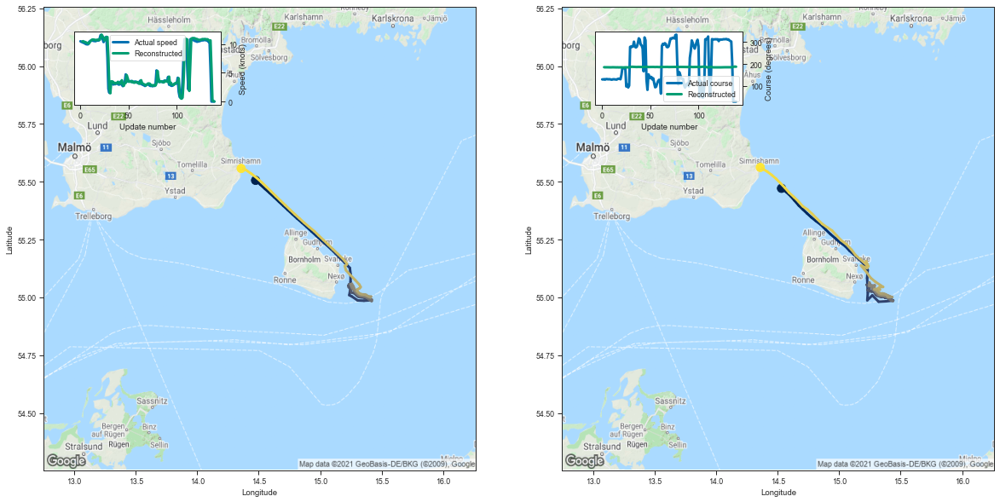

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.531519  55.471523  10.472847  185.372162         0.022762   
3    14.570389  55.455463  10.495119  185.069519         0.014181   
4    14.606020  55.437656  10.357458  185.219589         0.015251   
5    14.637117  55.418682  10.360205  185.100311         0.013809   
6    14.672255  55.397030  10.259777  184.934967         0.011444   
..         ...        ...        ...         ...              ...   
135  14.372079  55.557175  10.634727  185.228546         0.013872   
136  14.343899  55.551025   5.668915  186.862518         0.013919   
137  14.353952  55.562431   0.206382  187.832367         0.004126   
138  14.358874  55.561760   0.079451  187.973267         0.004243   
139  14.359374  55.561974   0.032606  187.496155         0.002550   

     Latitude sigma  Speed sigma  Course sigma  
2          0.014240     1.071888     91.794320  
3          0.009151     0.627313     95.140218  
4          0.009559     

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
34,34,7237328,266054000,Fishing,144,1337.932617,9.291199
25,25,7292936,266054000,Fishing,144,1336.199829,9.279165
44,44,7135380,266054000,Fishing,144,1329.964600,9.235865
29,29,6787151,265759000,Fishing,143,1312.394897,9.177587
17,17,6685896,265759000,Fishing,143,1311.765991,9.173189
...,...,...,...,...,...,...,...
13,13,7873292,266315000,Fishing,77,-43.543579,-0.565501
80,80,2458890,261001400,Fishing,129,-75.939148,-0.588676
21,21,19488,211243240,Fishing,110,-69.807877,-0.634617
33,33,4352040,261015270,Fishing,113,-76.570389,-0.677614


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n